<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Scratch_3_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    # Add brightness to images
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)

    # Convert the image to grayscale, and blur it slightly
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()
   
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Hyperparameters 
image_size = 224
BATCH_SIZE = 32
hyper_channels = 3

In [10]:
#Bounding box with one tumor
#Define the name of the 3 classes of MRI
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
#Define the list of images for the training
X_train = []
count = 0;
#Lists of coordinates for resizing bounding box
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

#Loading training images
for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        X_train.append(image)

#Load train bounding box labels
image_index = 0
#Define the list of bb coordinates for the training images
bb_list = []
#List used to duplicate images with two bounding box
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count]
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Code to duplicate images with two bounding boxes
print('Dimension of the train list before image duplication:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #Inside bb_list the second label has already been put, now we insert the first label
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimension of the list after image duplication:
print('Dimension of the train list after image duplication:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

#Load test images
X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        X_test.append(image_test)

#Load the bounding box labels for testing
image_index = 0
count_test = 0;
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                
                #rescaling the bounding box to the correct position after crop
                temp_array[0] = temp_array[0]*images_width_test[count_test] 
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Code to duplicate images with two bounding boxes
print('Dimension of the test list before image duplication:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #Inside bb_list the second label has already been put, now we insert the first label

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

print('Dimension of the test list after image duplication:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))  
     


Dimension of the train list before image duplication:
X_train:  878
bb_list:  878
Dimension of the train list after image duplication:
X_train:  919
bb_train:  919
Dimension of the test list before image duplication:
X_test:  223
bb_list:  223
Dimension of the test list after image duplication:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle of the train dataset
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
#Creation of the three data generator datasets to feed the model with batches of data during the training process
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, hyper_channels])

x = input_

for i in range(3):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

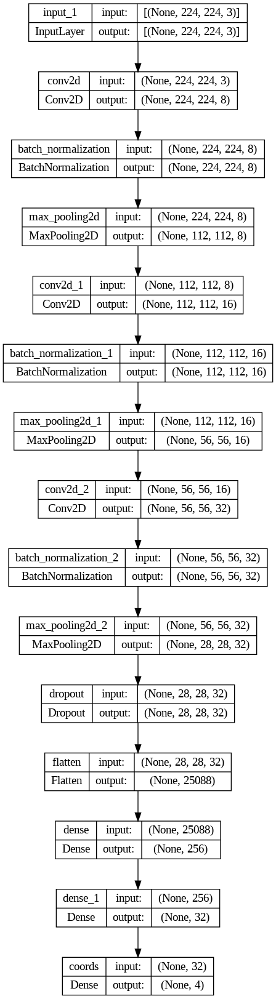

In [18]:
from tensorflow.keras.utils import plot_model
plot_model(model,show_shapes=True, show_layer_names=True, rankdir='TB', expand_nested=True)

In [19]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in red the real bounding box
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in green the predicted bounding box
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [20]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [21]:
#change folder to create the folder for saving the model
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [22]:
#list of callbacks
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode = 'max',
    save_best_only=True
    ),
    ShowTestImages()
]

In [23]:
#Function to define the IoU metrics
def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):

        #define the true and predicted coordinates (height and width)
        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
        #Define the bb true area 
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height 


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)

        results.append(iou)
    return np.mean(results)

# metric creation
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [24]:
#Compilation of the model
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 31.1109 - IoU: 0.0691
Epoch 1: val_IoU improved from -inf to 0.05410, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 28ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


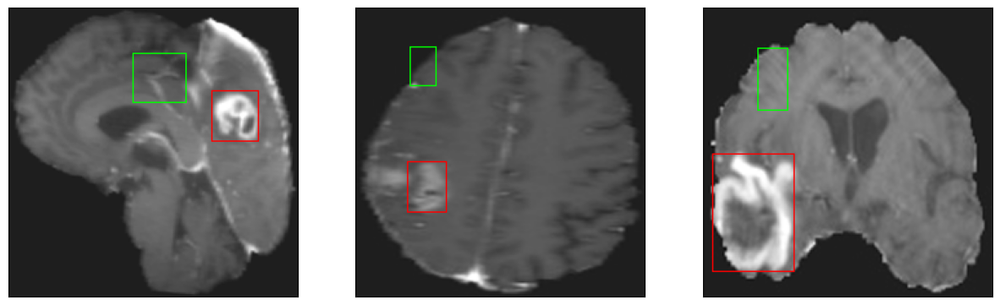

26/26 [==============================] - 26s 436ms/step - loss: 31.1109 - IoU: 0.0691 - val_loss: 34.0196 - val_IoU: 0.0541
Epoch 2/200
26/26 [==============================] - ETA: 0s - loss: 17.6928 - IoU: 0.2165
Epoch 2: val_IoU improved from 0.05410 to 0.07689, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


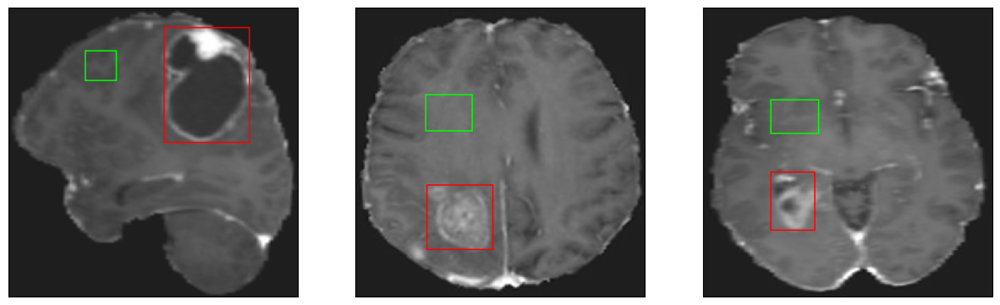

26/26 [==============================] - 4s 146ms/step - loss: 17.6928 - IoU: 0.2165 - val_loss: 29.1271 - val_IoU: 0.0769
Epoch 3/200
25/26 [===========================>..] - ETA: 0s - loss: 14.5062 - IoU: 0.2797
Epoch 3: val_IoU did not improve from 0.07689
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


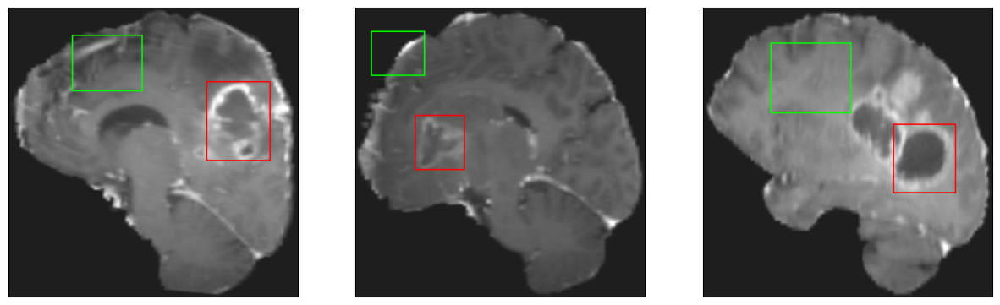

26/26 [==============================] - 3s 106ms/step - loss: 14.5214 - IoU: 0.2787 - val_loss: 34.0848 - val_IoU: 0.0340
Epoch 4/200
26/26 [==============================] - ETA: 0s - loss: 12.3316 - IoU: 0.3249
Epoch 4: val_IoU did not improve from 0.07689
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


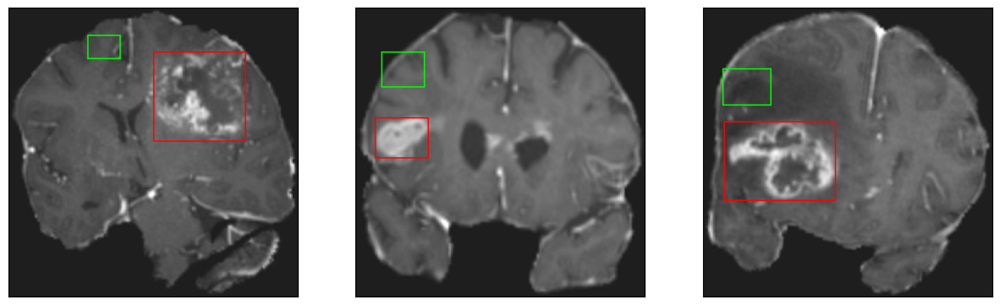

26/26 [==============================] - 2s 84ms/step - loss: 12.3316 - IoU: 0.3249 - val_loss: 41.6590 - val_IoU: 0.0068
Epoch 5/200
25/26 [===========================>..] - ETA: 0s - loss: 11.3843 - IoU: 0.3440
Epoch 5: val_IoU did not improve from 0.07689
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


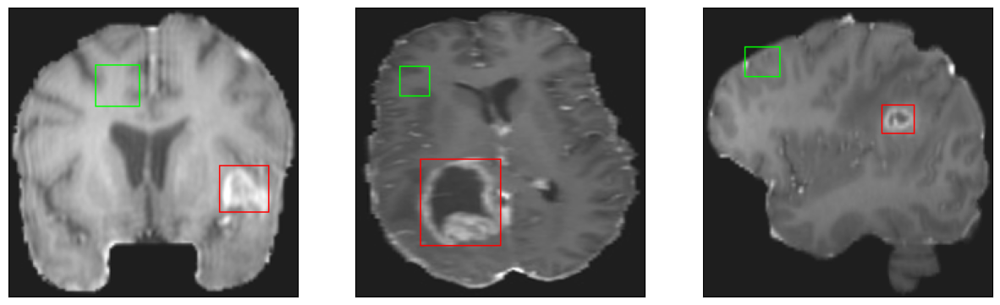

26/26 [==============================] - 2s 82ms/step - loss: 11.3582 - IoU: 0.3447 - val_loss: 41.0548 - val_IoU: 0.0059
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 10.9275 - IoU: 0.3492
Epoch 6: val_IoU did not improve from 0.07689
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


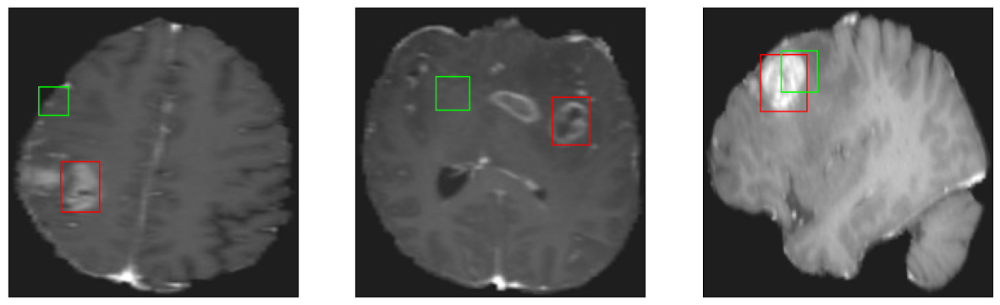

26/26 [==============================] - 2s 88ms/step - loss: 10.9275 - IoU: 0.3492 - val_loss: 35.9536 - val_IoU: 0.0182
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 10.2197 - IoU: 0.3743
Epoch 7: val_IoU did not improve from 0.07689
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


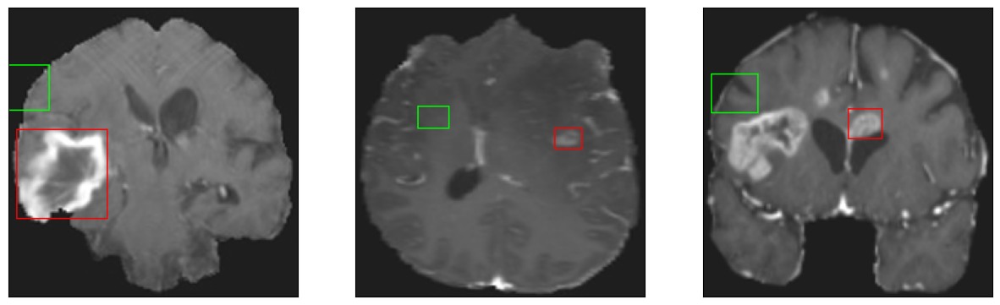

26/26 [==============================] - 2s 91ms/step - loss: 10.2197 - IoU: 0.3743 - val_loss: 36.6116 - val_IoU: 0.0106
Epoch 8/200
26/26 [==============================] - ETA: 0s - loss: 9.5362 - IoU: 0.3908
Epoch 8: val_IoU did not improve from 0.07689
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


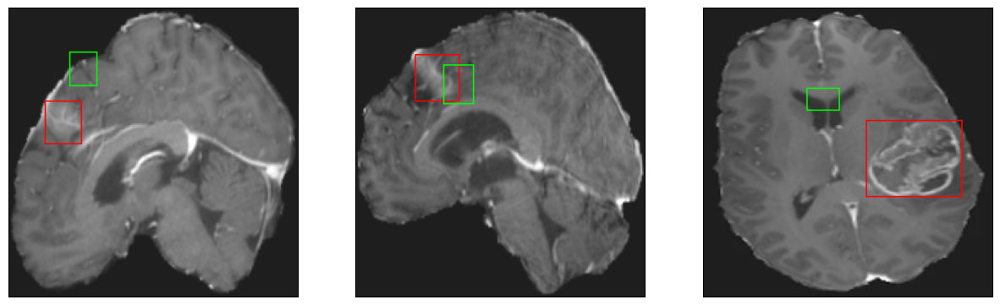

26/26 [==============================] - 3s 110ms/step - loss: 9.5362 - IoU: 0.3908 - val_loss: 34.0827 - val_IoU: 0.0223
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 8.8836 - IoU: 0.4185
Epoch 9: val_IoU did not improve from 0.07689
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


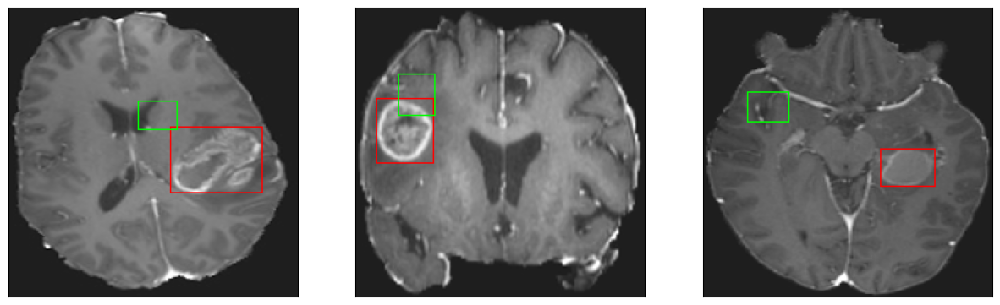

26/26 [==============================] - 3s 98ms/step - loss: 8.8836 - IoU: 0.4185 - val_loss: 27.7538 - val_IoU: 0.0541
Epoch 10/200
25/26 [===========================>..] - ETA: 0s - loss: 8.6525 - IoU: 0.4260
Epoch 10: val_IoU did not improve from 0.07689
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


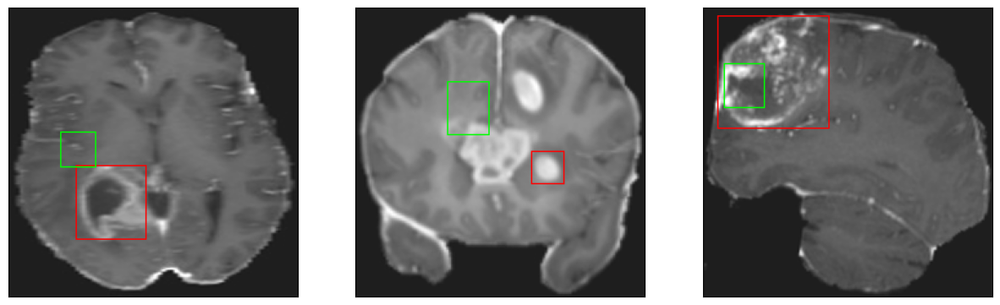

26/26 [==============================] - 2s 92ms/step - loss: 8.6390 - IoU: 0.4279 - val_loss: 25.6479 - val_IoU: 0.0734
Epoch 11/200
26/26 [==============================] - ETA: 0s - loss: 8.5751 - IoU: 0.4243
Epoch 11: val_IoU improved from 0.07689 to 0.13056, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 10ms/step
4


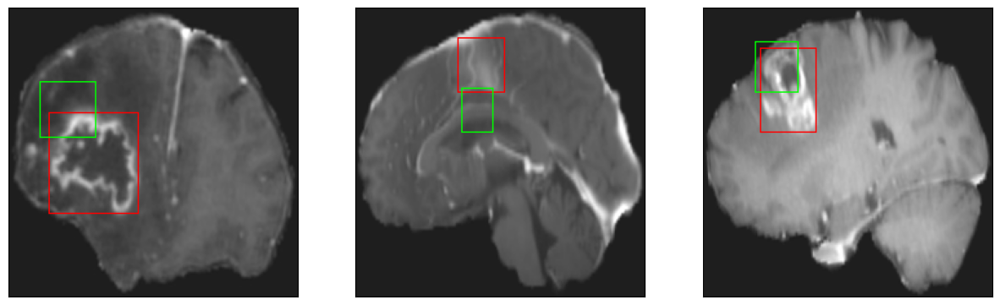

26/26 [==============================] - 5s 178ms/step - loss: 8.5751 - IoU: 0.4243 - val_loss: 21.2209 - val_IoU: 0.1306
Epoch 12/200
25/26 [===========================>..] - ETA: 0s - loss: 8.0779 - IoU: 0.4382
Epoch 12: val_IoU did not improve from 0.13056
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


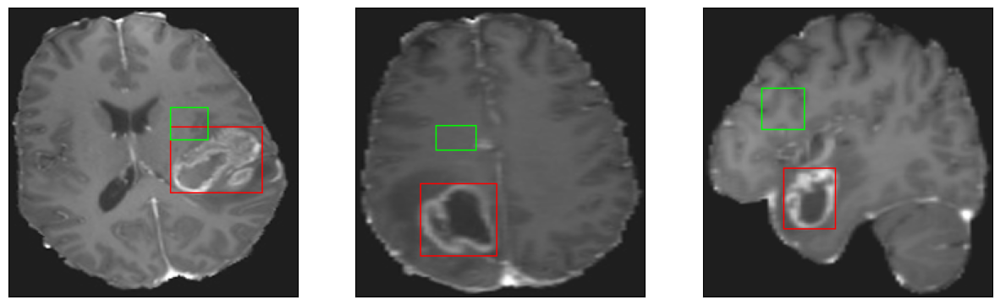

26/26 [==============================] - 2s 92ms/step - loss: 8.0699 - IoU: 0.4359 - val_loss: 23.8572 - val_IoU: 0.0972
Epoch 13/200
25/26 [===========================>..] - ETA: 0s - loss: 7.9843 - IoU: 0.4389
Epoch 13: val_IoU did not improve from 0.13056
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


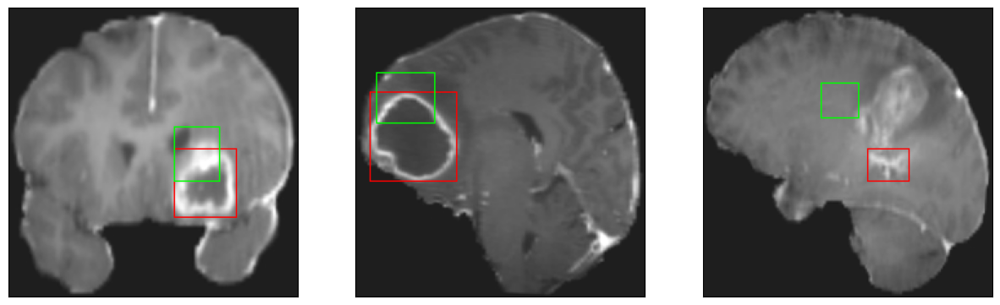

26/26 [==============================] - 2s 89ms/step - loss: 7.9707 - IoU: 0.4392 - val_loss: 22.3713 - val_IoU: 0.1097
Epoch 14/200
25/26 [===========================>..] - ETA: 0s - loss: 7.8309 - IoU: 0.4596
Epoch 14: val_IoU improved from 0.13056 to 0.27452, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


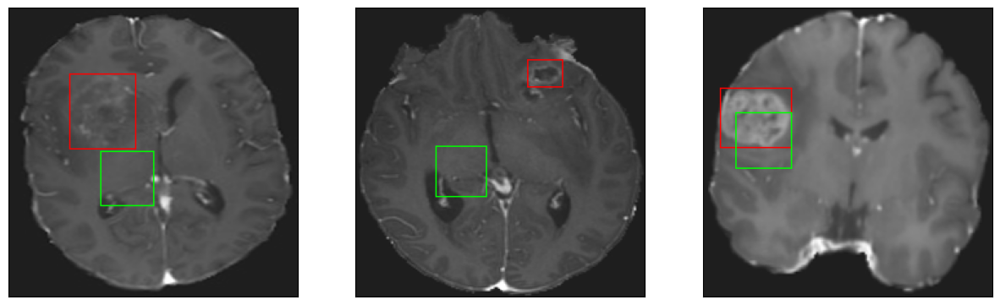

26/26 [==============================] - 3s 104ms/step - loss: 7.8273 - IoU: 0.4572 - val_loss: 14.8554 - val_IoU: 0.2745
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 7.9359 - IoU: 0.4527
Epoch 15: val_IoU improved from 0.27452 to 0.34705, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


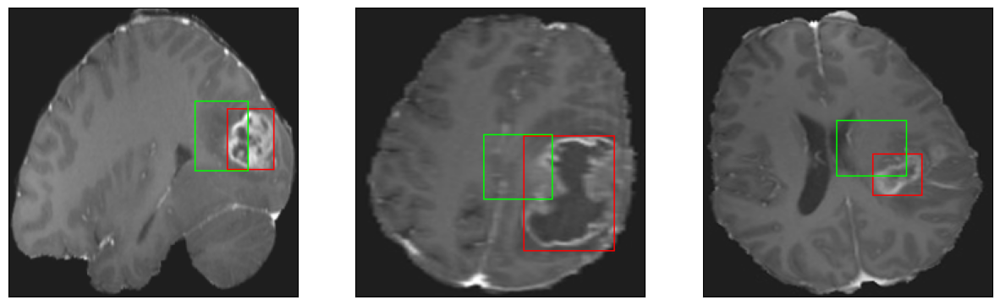

26/26 [==============================] - 3s 133ms/step - loss: 7.9359 - IoU: 0.4527 - val_loss: 15.3594 - val_IoU: 0.3470
Epoch 16/200
26/26 [==============================] - ETA: 0s - loss: 7.7730 - IoU: 0.4638
Epoch 16: val_IoU did not improve from 0.34705
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


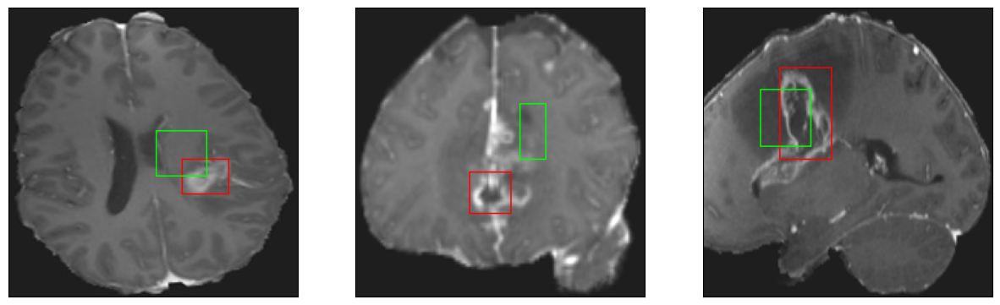

26/26 [==============================] - 2s 93ms/step - loss: 7.7730 - IoU: 0.4638 - val_loss: 13.8780 - val_IoU: 0.3212
Epoch 17/200
25/26 [===========================>..] - ETA: 0s - loss: 7.1255 - IoU: 0.4913
Epoch 17: val_IoU did not improve from 0.34705
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 12ms/step
4


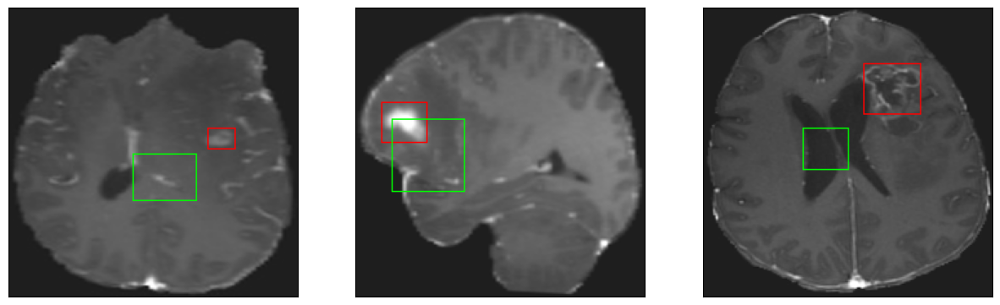

26/26 [==============================] - 3s 102ms/step - loss: 7.1327 - IoU: 0.4893 - val_loss: 13.7043 - val_IoU: 0.3385
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 7.0794 - IoU: 0.4811
Epoch 18: val_IoU did not improve from 0.34705
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


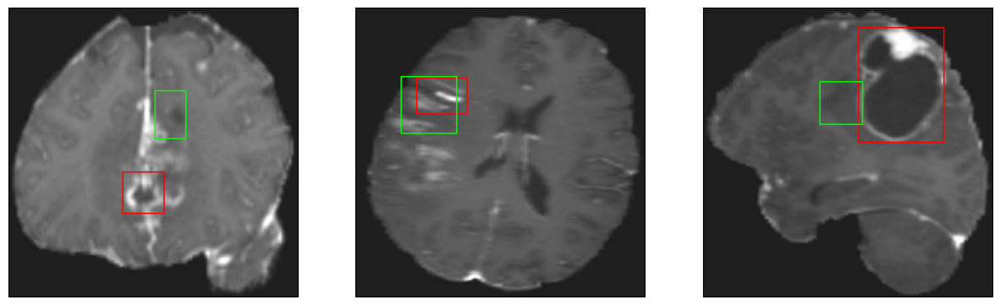

26/26 [==============================] - 2s 90ms/step - loss: 7.0794 - IoU: 0.4811 - val_loss: 15.1484 - val_IoU: 0.2637
Epoch 19/200
25/26 [===========================>..] - ETA: 0s - loss: 7.1495 - IoU: 0.4792
Epoch 19: val_IoU did not improve from 0.34705
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


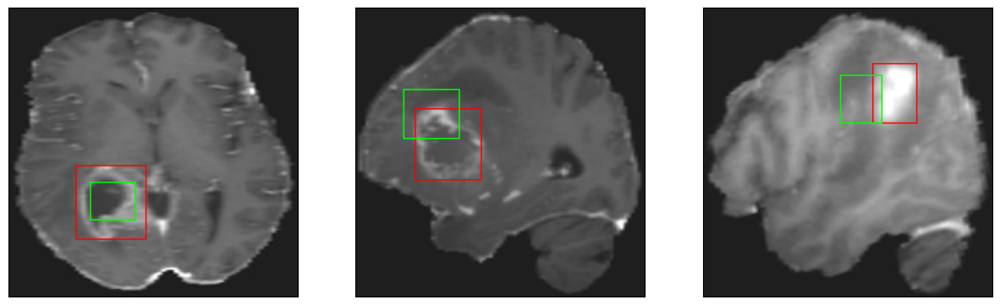

26/26 [==============================] - 3s 108ms/step - loss: 7.0583 - IoU: 0.4841 - val_loss: 14.4252 - val_IoU: 0.2980
Epoch 20/200
25/26 [===========================>..] - ETA: 0s - loss: 6.7914 - IoU: 0.4925
Epoch 20: val_IoU did not improve from 0.34705
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 5ms/step
4
8/8 [==============================] - 0s 7ms/step
4


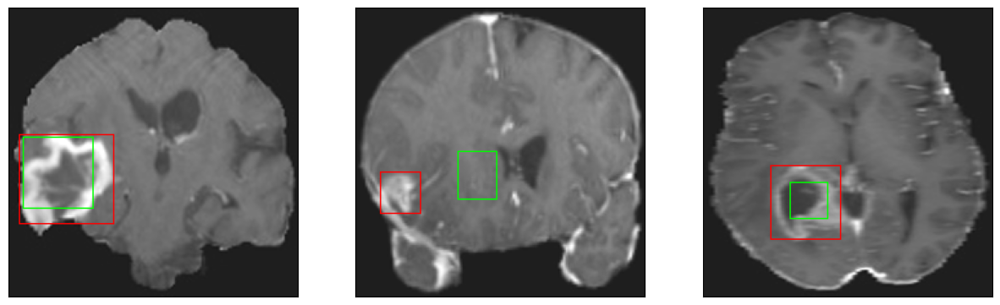

26/26 [==============================] - 2s 96ms/step - loss: 6.8159 - IoU: 0.4940 - val_loss: 14.6223 - val_IoU: 0.2855
Epoch 21/200
25/26 [===========================>..] - ETA: 0s - loss: 6.9771 - IoU: 0.4851
Epoch 21: val_IoU did not improve from 0.34705
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


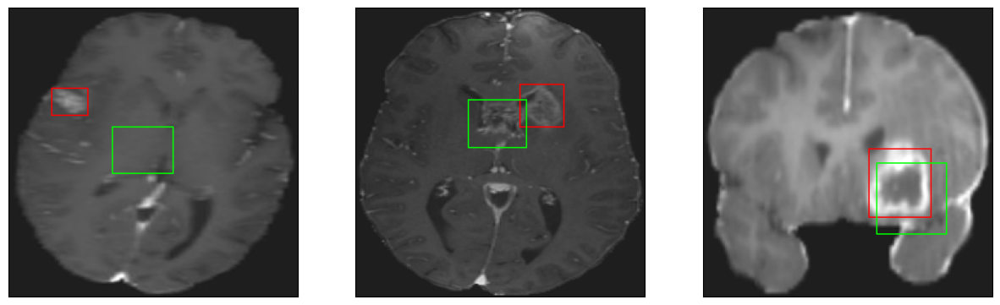

26/26 [==============================] - 3s 110ms/step - loss: 6.9981 - IoU: 0.4838 - val_loss: 13.4514 - val_IoU: 0.3369
Epoch 22/200
25/26 [===========================>..] - ETA: 0s - loss: 6.6439 - IoU: 0.5154
Epoch 22: val_IoU did not improve from 0.34705
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


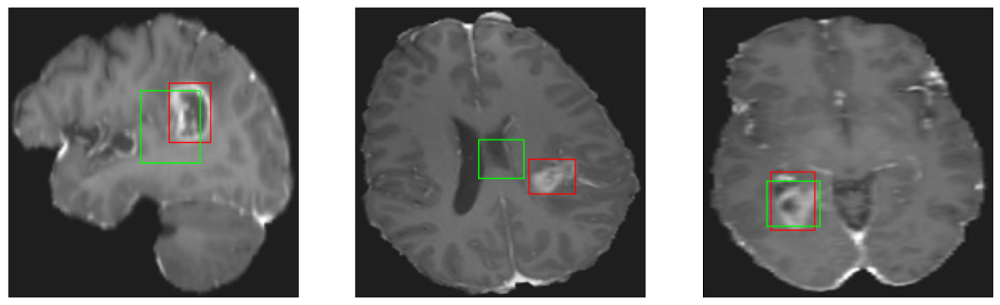

26/26 [==============================] - 3s 123ms/step - loss: 6.6488 - IoU: 0.5170 - val_loss: 13.9280 - val_IoU: 0.3164
Epoch 23/200
25/26 [===========================>..] - ETA: 0s - loss: 6.7509 - IoU: 0.4962
Epoch 23: val_IoU did not improve from 0.34705
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


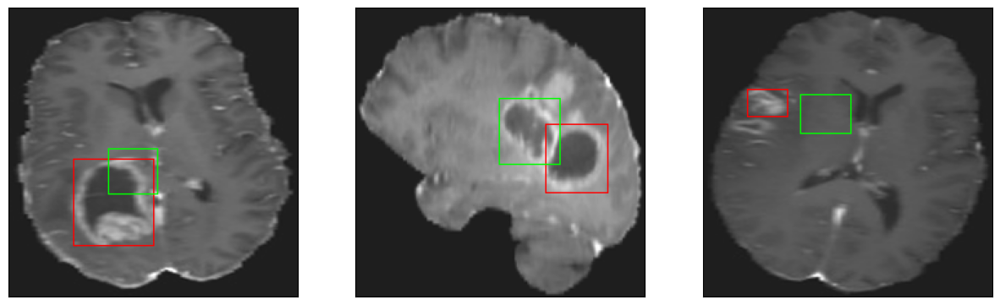

26/26 [==============================] - 3s 98ms/step - loss: 6.7144 - IoU: 0.4990 - val_loss: 14.3700 - val_IoU: 0.2994
Epoch 24/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3046 - IoU: 0.5216
Epoch 24: val_IoU did not improve from 0.34705
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


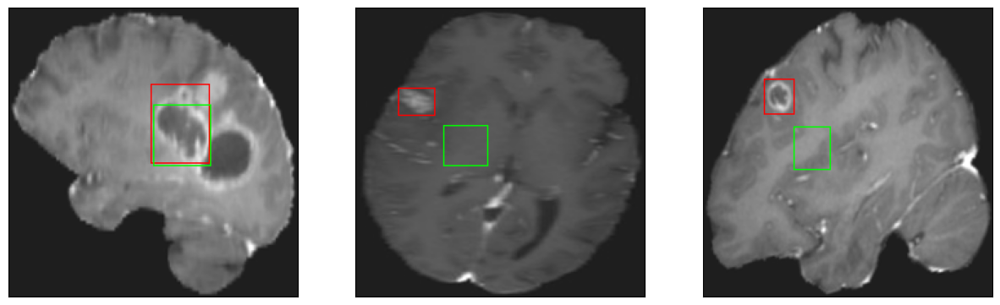

26/26 [==============================] - 3s 98ms/step - loss: 6.3190 - IoU: 0.5217 - val_loss: 13.8332 - val_IoU: 0.3159
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 6.2136 - IoU: 0.5319
Epoch 25: val_IoU did not improve from 0.34705
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


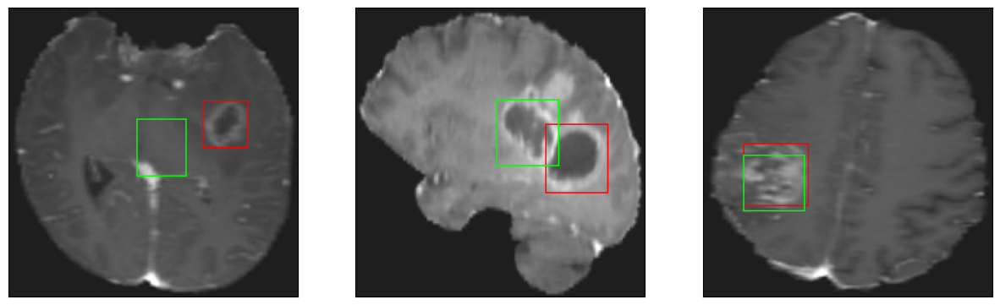

26/26 [==============================] - 3s 118ms/step - loss: 6.2136 - IoU: 0.5319 - val_loss: 14.2206 - val_IoU: 0.3019
Epoch 26/200
26/26 [==============================] - ETA: 0s - loss: 6.2776 - IoU: 0.5274
Epoch 26: val_IoU improved from 0.34705 to 0.35059, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


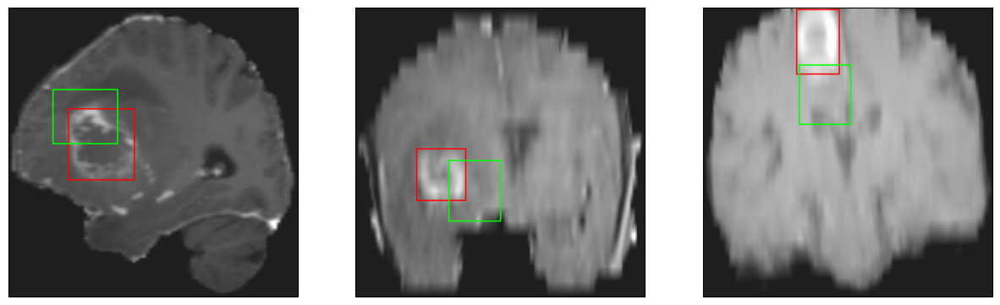

26/26 [==============================] - 4s 168ms/step - loss: 6.2776 - IoU: 0.5274 - val_loss: 13.1107 - val_IoU: 0.3506
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 6.1160 - IoU: 0.5363
Epoch 27: val_IoU did not improve from 0.35059
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


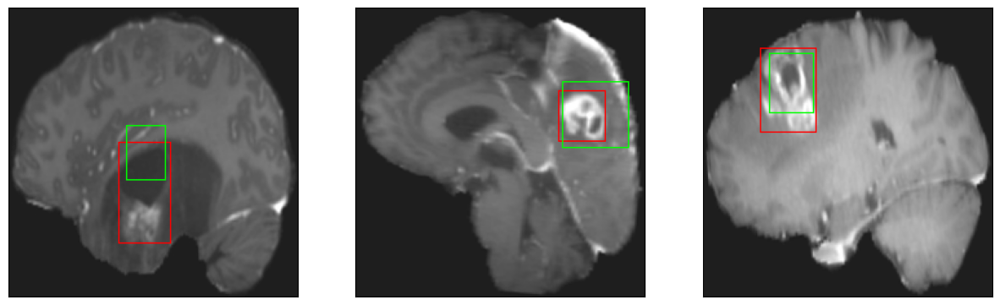

26/26 [==============================] - 3s 114ms/step - loss: 6.1160 - IoU: 0.5363 - val_loss: 13.8319 - val_IoU: 0.3254
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 6.3280 - IoU: 0.5301
Epoch 28: val_IoU improved from 0.35059 to 0.35303, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


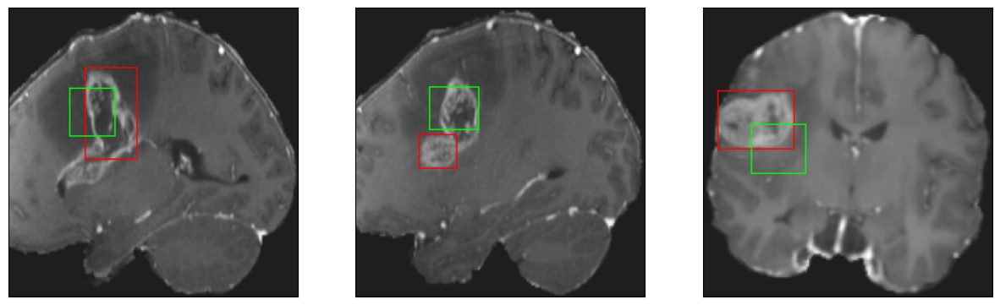

26/26 [==============================] - 3s 119ms/step - loss: 6.3280 - IoU: 0.5301 - val_loss: 13.0695 - val_IoU: 0.3530
Epoch 29/200
25/26 [===========================>..] - ETA: 0s - loss: 5.9928 - IoU: 0.5394
Epoch 29: val_IoU did not improve from 0.35303
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


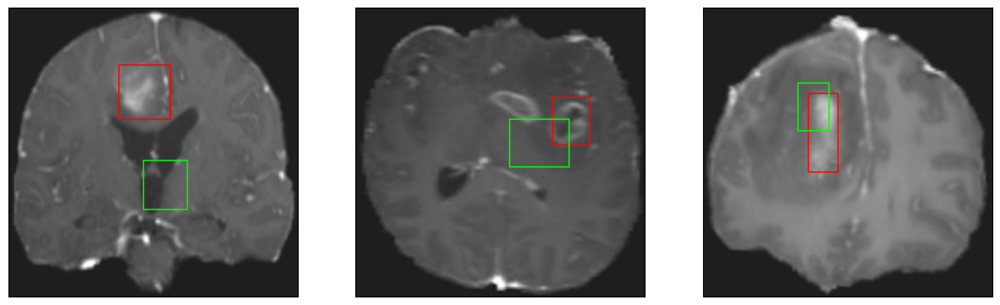

26/26 [==============================] - 3s 99ms/step - loss: 5.9904 - IoU: 0.5395 - val_loss: 13.2640 - val_IoU: 0.3400
Epoch 30/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8238 - IoU: 0.5465
Epoch 30: val_IoU improved from 0.35303 to 0.35685, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


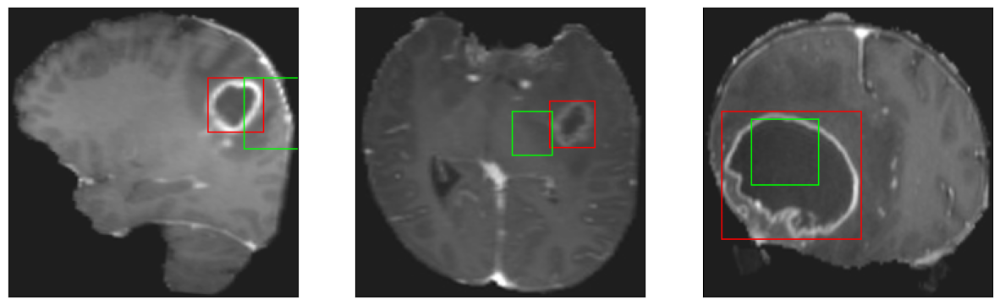

26/26 [==============================] - 3s 114ms/step - loss: 5.8143 - IoU: 0.5445 - val_loss: 12.8050 - val_IoU: 0.3569
Epoch 31/200
26/26 [==============================] - ETA: 0s - loss: 5.9241 - IoU: 0.5428
Epoch 31: val_IoU improved from 0.35685 to 0.35707, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


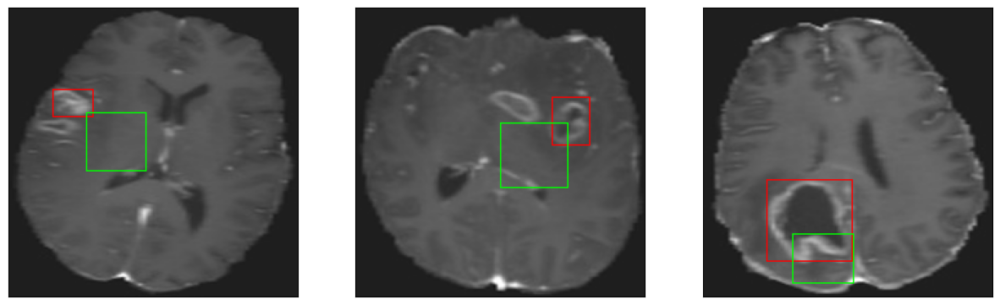

26/26 [==============================] - 3s 113ms/step - loss: 5.9241 - IoU: 0.5428 - val_loss: 14.0034 - val_IoU: 0.3571
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 5.9129 - IoU: 0.5488
Epoch 32: val_IoU did not improve from 0.35707
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


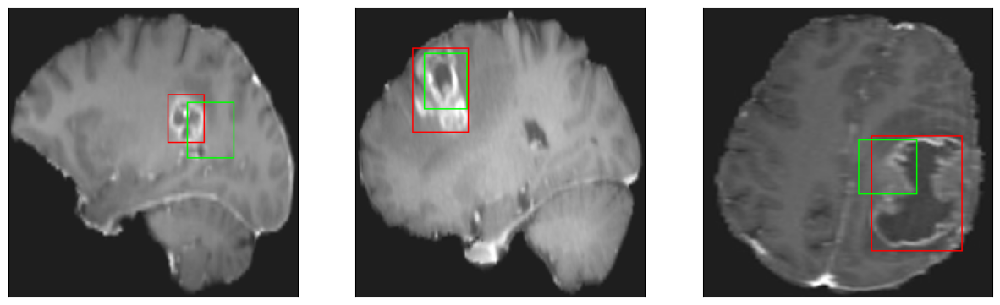

26/26 [==============================] - 3s 109ms/step - loss: 5.9129 - IoU: 0.5488 - val_loss: 13.1288 - val_IoU: 0.3538
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 6.0280 - IoU: 0.5299
Epoch 33: val_IoU did not improve from 0.35707
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


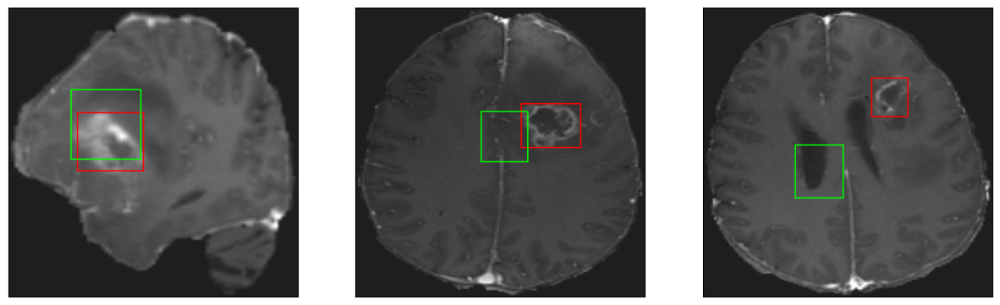

26/26 [==============================] - 3s 99ms/step - loss: 6.0280 - IoU: 0.5299 - val_loss: 14.7196 - val_IoU: 0.3340
Epoch 34/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0199 - IoU: 0.5371
Epoch 34: val_IoU did not improve from 0.35707
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


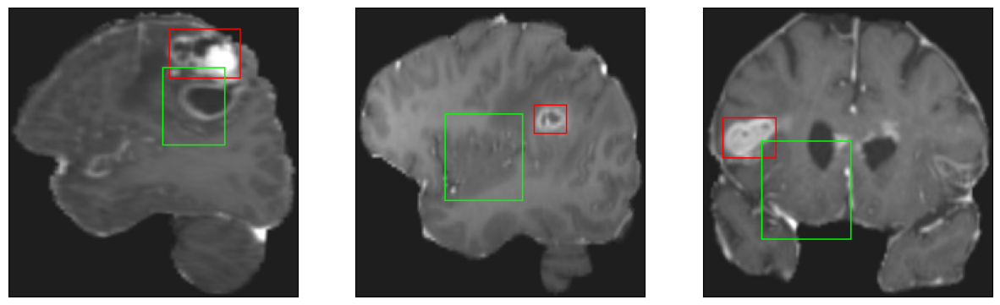

26/26 [==============================] - 2s 94ms/step - loss: 6.0035 - IoU: 0.5375 - val_loss: 17.5680 - val_IoU: 0.3008
Epoch 35/200
25/26 [===========================>..] - ETA: 0s - loss: 5.9069 - IoU: 0.5528
Epoch 35: val_IoU did not improve from 0.35707
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


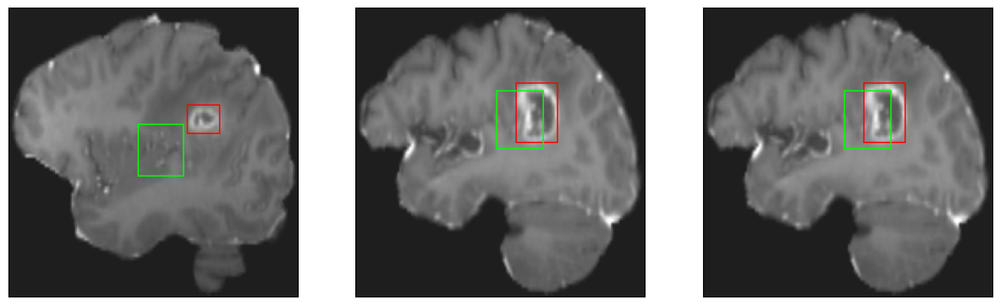

26/26 [==============================] - 3s 102ms/step - loss: 5.9285 - IoU: 0.5510 - val_loss: 13.4224 - val_IoU: 0.3288
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 5.6197 - IoU: 0.5685
Epoch 36: val_IoU improved from 0.35707 to 0.36395, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 8ms/step
4


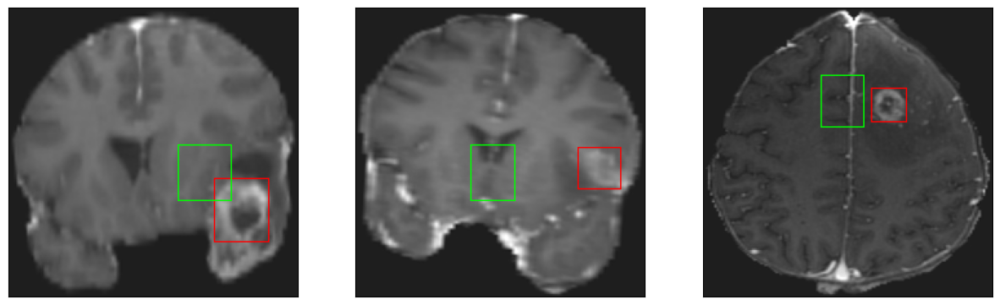

26/26 [==============================] - 5s 205ms/step - loss: 5.6197 - IoU: 0.5685 - val_loss: 12.9065 - val_IoU: 0.3639
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 5.7778 - IoU: 0.5516
Epoch 37: val_IoU did not improve from 0.36395
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


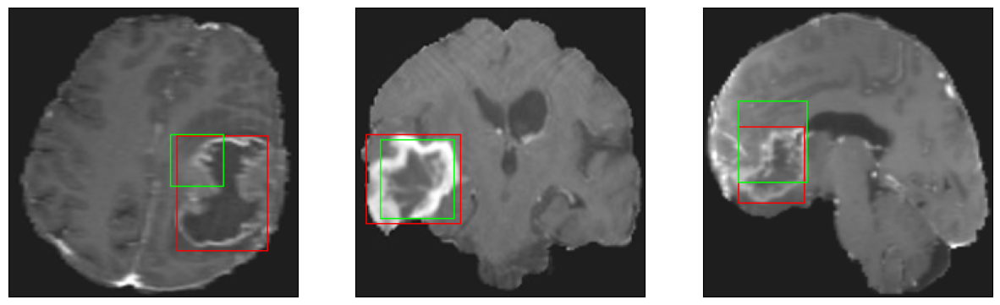

26/26 [==============================] - 3s 109ms/step - loss: 5.7778 - IoU: 0.5516 - val_loss: 12.8715 - val_IoU: 0.3494
Epoch 38/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5078 - IoU: 0.5614
Epoch 38: val_IoU did not improve from 0.36395
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4


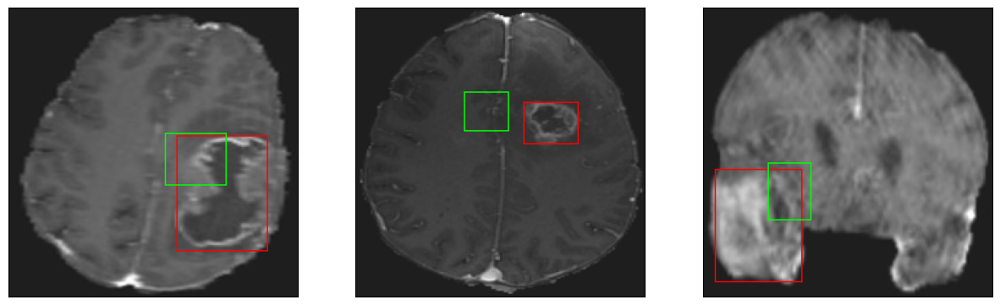

26/26 [==============================] - 3s 128ms/step - loss: 5.4705 - IoU: 0.5645 - val_loss: 13.1332 - val_IoU: 0.3395
Epoch 39/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4076 - IoU: 0.5676
Epoch 39: val_IoU did not improve from 0.36395
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


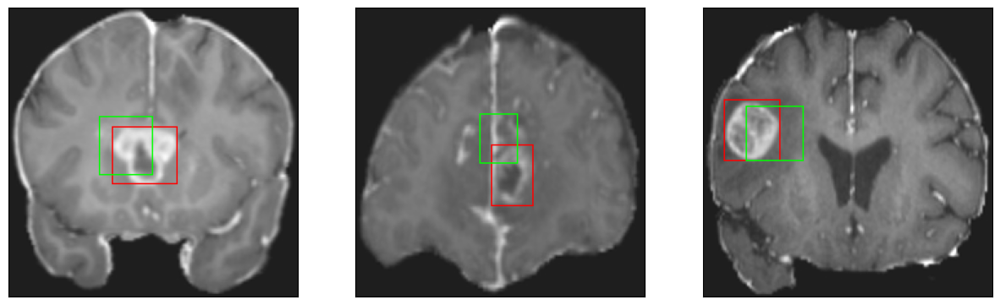

26/26 [==============================] - 3s 121ms/step - loss: 5.3885 - IoU: 0.5675 - val_loss: 13.9812 - val_IoU: 0.3202
Epoch 40/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6035 - IoU: 0.5614
Epoch 40: val_IoU did not improve from 0.36395
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


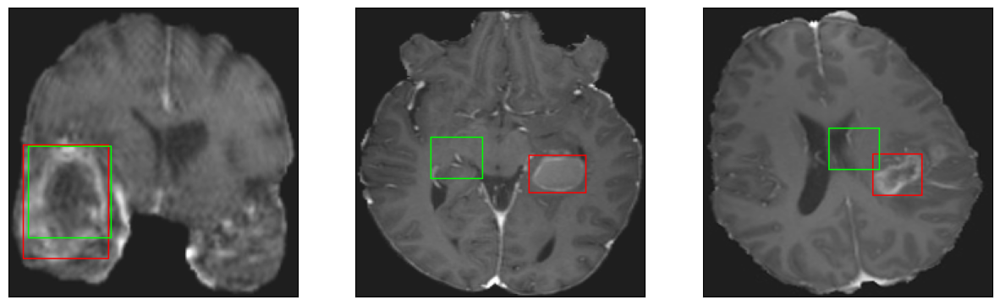

26/26 [==============================] - 3s 104ms/step - loss: 5.6535 - IoU: 0.5603 - val_loss: 13.8610 - val_IoU: 0.3264
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 5.5192 - IoU: 0.5618
Epoch 41: val_IoU did not improve from 0.36395
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


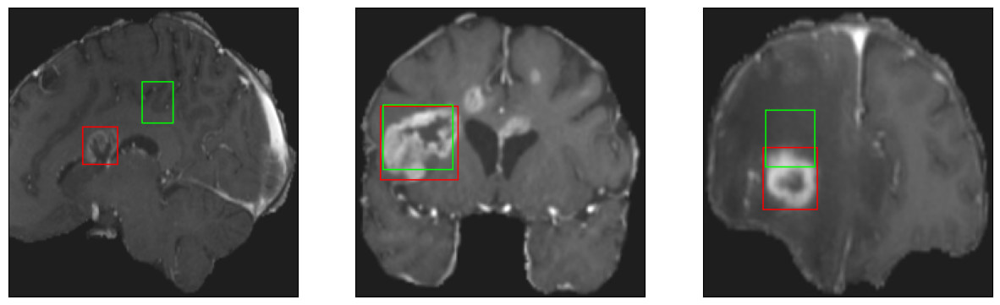

26/26 [==============================] - 3s 107ms/step - loss: 5.5192 - IoU: 0.5618 - val_loss: 12.9058 - val_IoU: 0.3631
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 5.4793 - IoU: 0.5686
Epoch 42: val_IoU did not improve from 0.36395
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


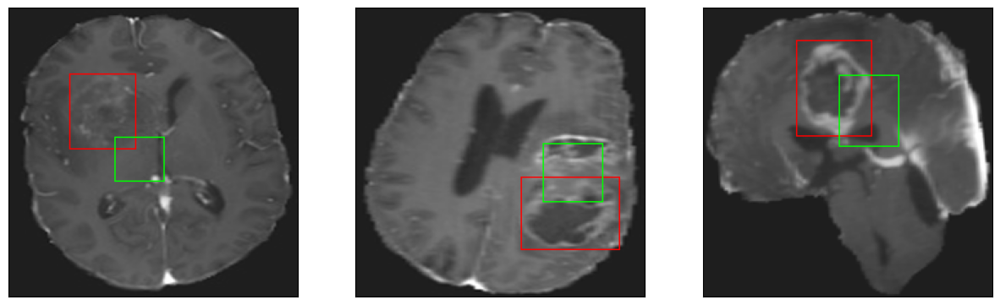

26/26 [==============================] - 3s 127ms/step - loss: 5.4793 - IoU: 0.5686 - val_loss: 13.2059 - val_IoU: 0.3495
Epoch 43/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5752 - IoU: 0.5638
Epoch 43: val_IoU did not improve from 0.36395
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


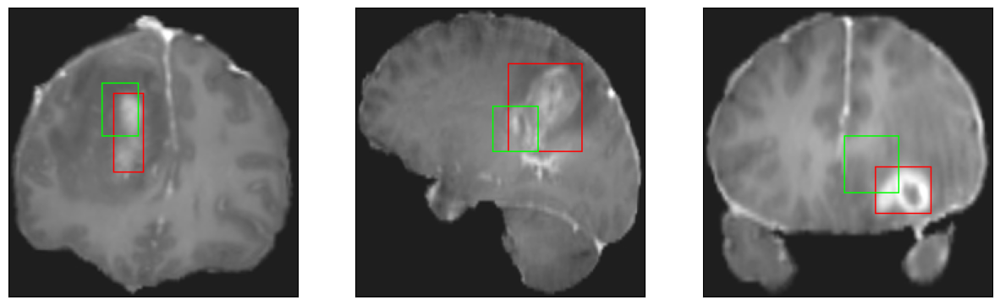

26/26 [==============================] - 3s 132ms/step - loss: 5.6530 - IoU: 0.5617 - val_loss: 13.6602 - val_IoU: 0.3273
Epoch 44/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3678 - IoU: 0.5798
Epoch 44: val_IoU improved from 0.36395 to 0.36566, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


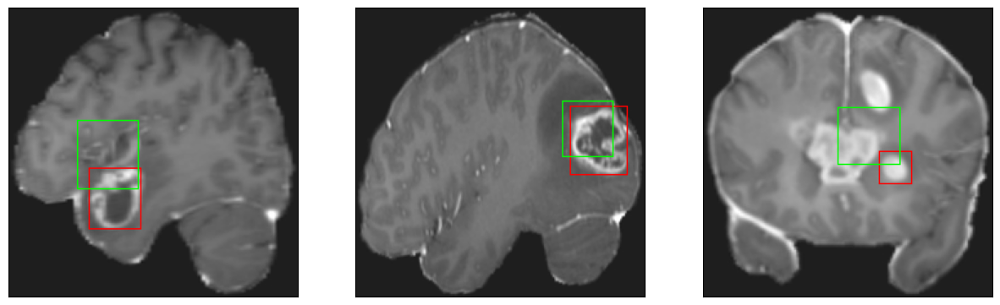

26/26 [==============================] - 5s 176ms/step - loss: 5.3599 - IoU: 0.5787 - val_loss: 12.6904 - val_IoU: 0.3657
Epoch 45/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1853 - IoU: 0.5840
Epoch 45: val_IoU did not improve from 0.36566
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


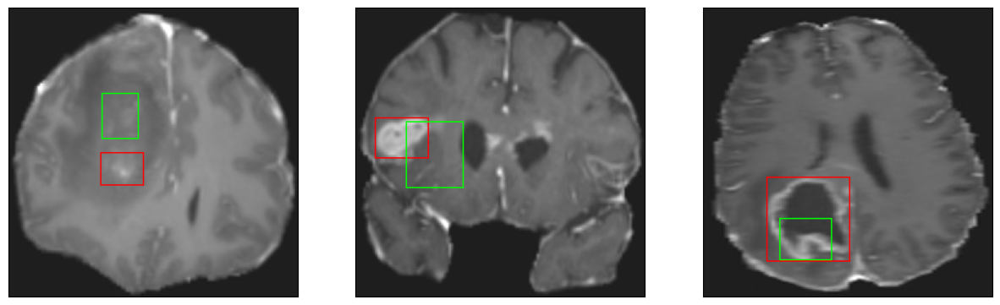

26/26 [==============================] - 3s 102ms/step - loss: 5.1851 - IoU: 0.5824 - val_loss: 12.9781 - val_IoU: 0.3553
Epoch 46/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2859 - IoU: 0.5779
Epoch 46: val_IoU improved from 0.36566 to 0.36640, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


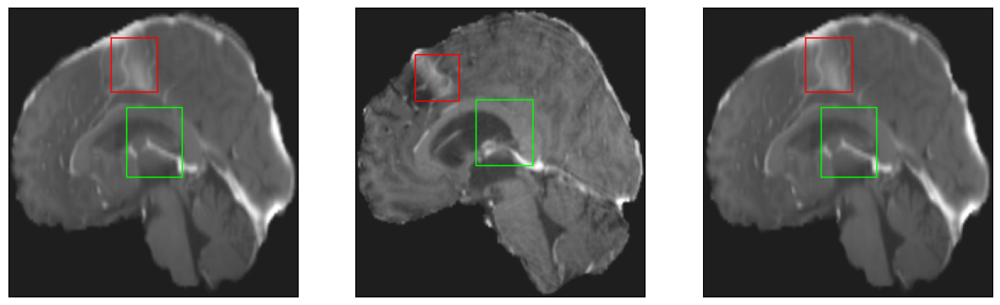

26/26 [==============================] - 4s 145ms/step - loss: 5.2648 - IoU: 0.5786 - val_loss: 12.6687 - val_IoU: 0.3664
Epoch 47/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1940 - IoU: 0.5794
Epoch 47: val_IoU improved from 0.36640 to 0.38256, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


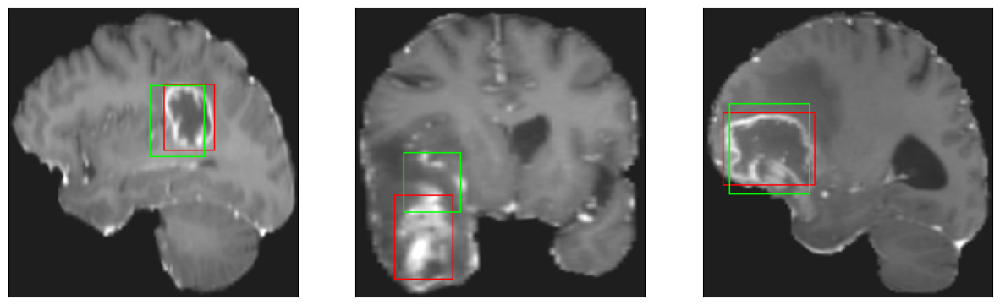

26/26 [==============================] - 3s 119ms/step - loss: 5.1883 - IoU: 0.5790 - val_loss: 12.5866 - val_IoU: 0.3826
Epoch 48/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1079 - IoU: 0.5953
Epoch 48: val_IoU did not improve from 0.38256
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


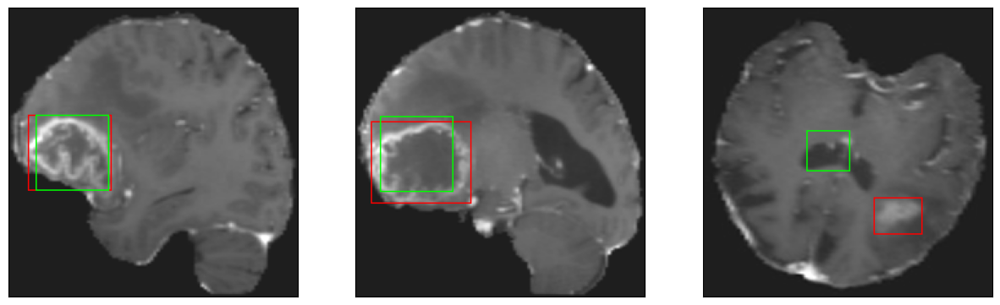

26/26 [==============================] - 3s 99ms/step - loss: 5.1375 - IoU: 0.5924 - val_loss: 12.6482 - val_IoU: 0.3583
Epoch 49/200
26/26 [==============================] - ETA: 0s - loss: 5.2094 - IoU: 0.5844
Epoch 49: val_IoU did not improve from 0.38256
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 7ms/step
4


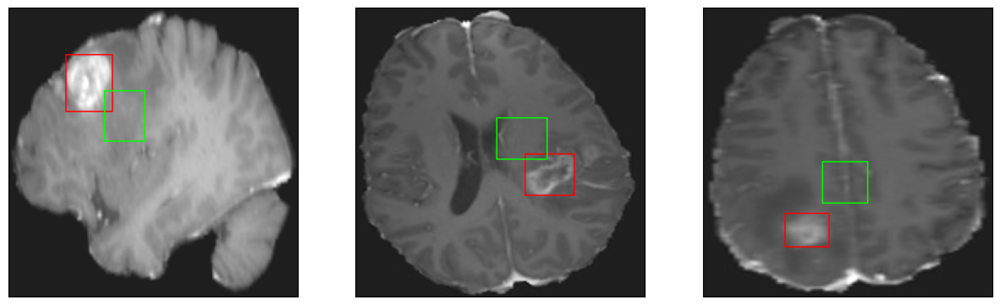

26/26 [==============================] - 3s 119ms/step - loss: 5.2094 - IoU: 0.5844 - val_loss: 13.2569 - val_IoU: 0.3297
Epoch 50/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3249 - IoU: 0.5803
Epoch 50: val_IoU did not improve from 0.38256
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


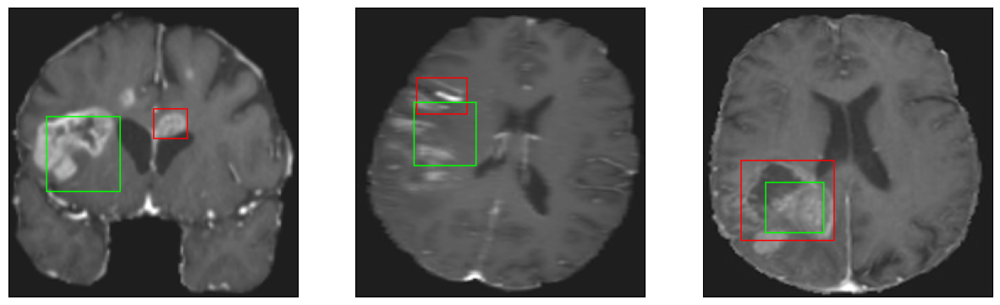

26/26 [==============================] - 3s 118ms/step - loss: 5.3002 - IoU: 0.5808 - val_loss: 12.8812 - val_IoU: 0.3588
Epoch 51/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1306 - IoU: 0.5883
Epoch 51: val_IoU did not improve from 0.38256
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


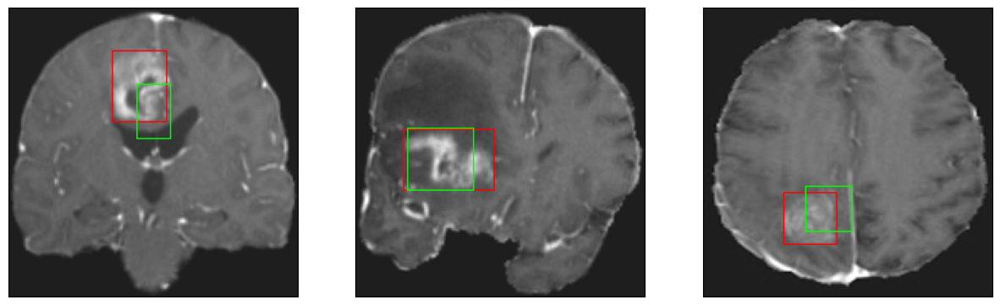

26/26 [==============================] - 3s 119ms/step - loss: 5.1370 - IoU: 0.5881 - val_loss: 12.6837 - val_IoU: 0.3560
Epoch 52/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3105 - IoU: 0.5806
Epoch 52: val_IoU did not improve from 0.38256
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


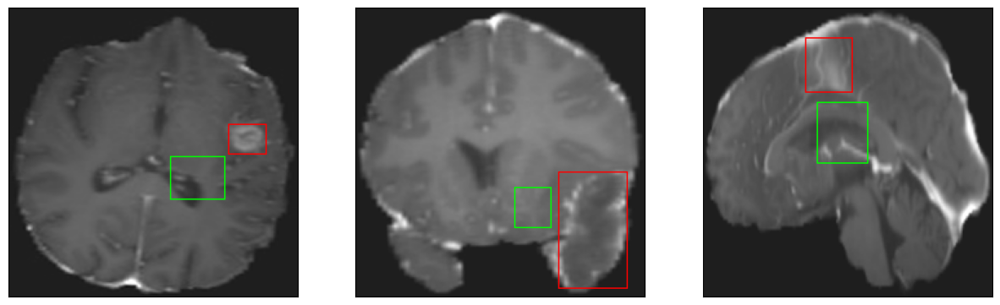

26/26 [==============================] - 3s 106ms/step - loss: 5.3159 - IoU: 0.5810 - val_loss: 12.6189 - val_IoU: 0.3660
Epoch 53/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1399 - IoU: 0.5883
Epoch 53: val_IoU did not improve from 0.38256
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


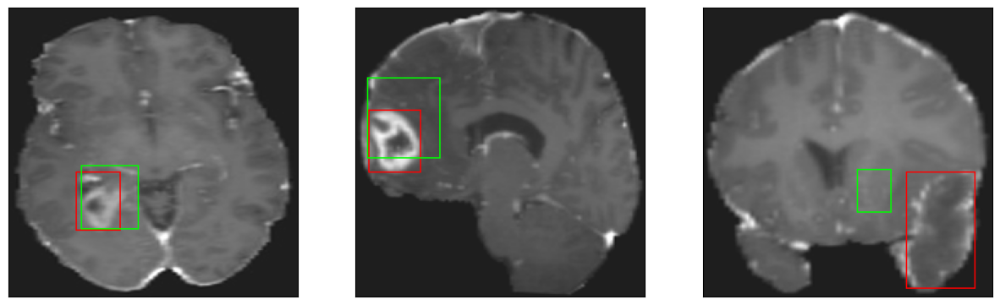

26/26 [==============================] - 3s 123ms/step - loss: 5.1067 - IoU: 0.5896 - val_loss: 13.2915 - val_IoU: 0.3496
Epoch 54/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2130 - IoU: 0.5838
Epoch 54: val_IoU did not improve from 0.38256
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


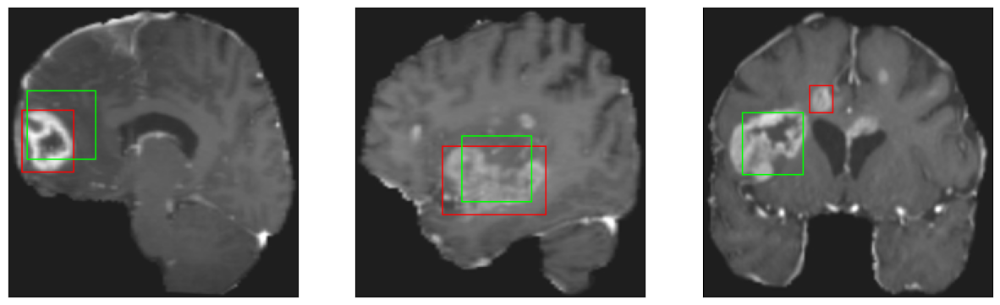

26/26 [==============================] - 3s 102ms/step - loss: 5.1972 - IoU: 0.5840 - val_loss: 12.3335 - val_IoU: 0.3758
Epoch 55/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2930 - IoU: 0.5805
Epoch 55: val_IoU did not improve from 0.38256
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


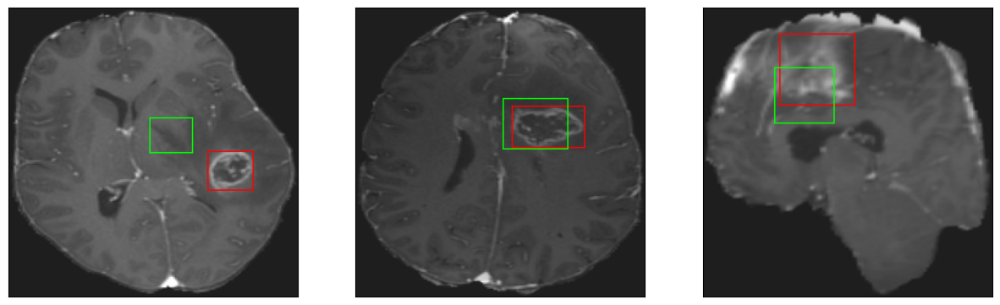

26/26 [==============================] - 3s 96ms/step - loss: 5.3036 - IoU: 0.5799 - val_loss: 14.0824 - val_IoU: 0.3014
Epoch 56/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9774 - IoU: 0.6090
Epoch 56: val_IoU did not improve from 0.38256
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


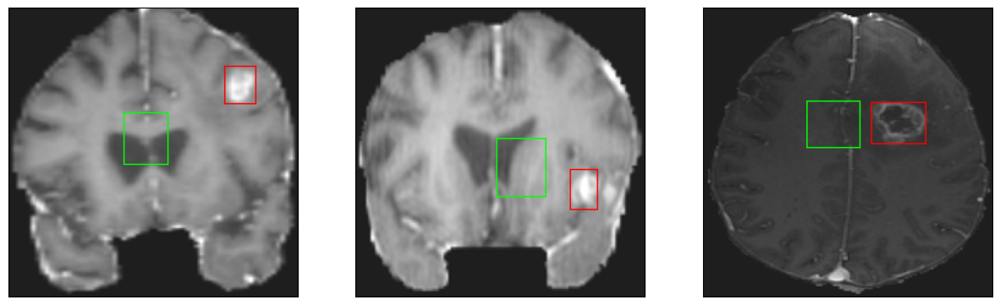

26/26 [==============================] - 3s 97ms/step - loss: 4.9668 - IoU: 0.6085 - val_loss: 12.5740 - val_IoU: 0.3764
Epoch 57/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0208 - IoU: 0.5994
Epoch 57: val_IoU did not improve from 0.38256
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


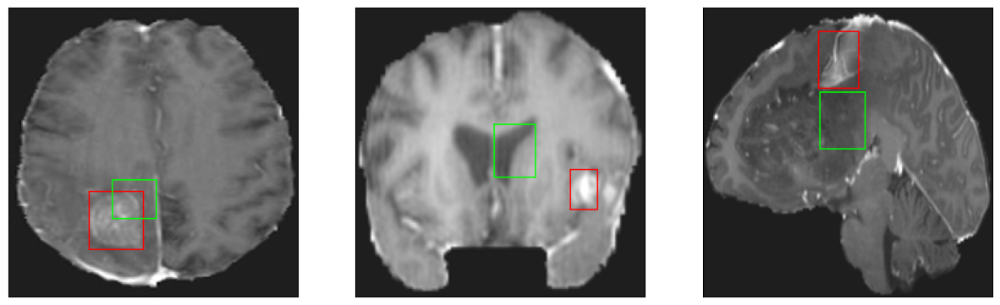

26/26 [==============================] - 3s 117ms/step - loss: 5.0258 - IoU: 0.5979 - val_loss: 12.2489 - val_IoU: 0.3667
Epoch 58/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7306 - IoU: 0.6151
Epoch 58: val_IoU improved from 0.38256 to 0.39026, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


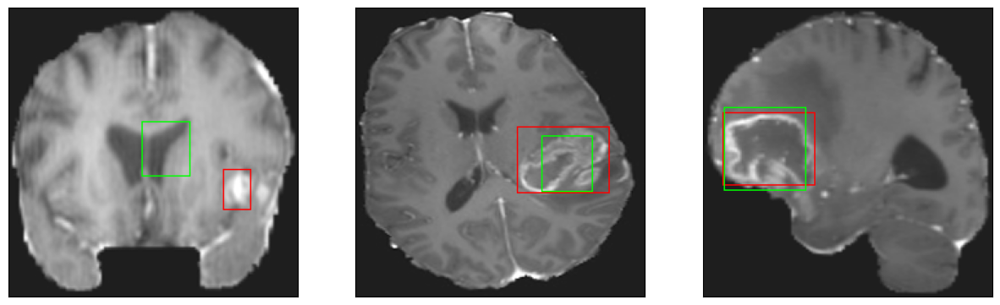

26/26 [==============================] - 5s 209ms/step - loss: 4.7201 - IoU: 0.6146 - val_loss: 12.3136 - val_IoU: 0.3903
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 4.6859 - IoU: 0.6099
Epoch 59: val_IoU improved from 0.39026 to 0.40933, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


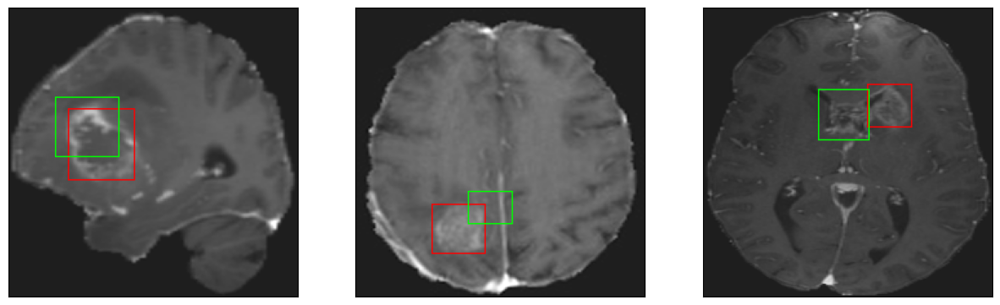

26/26 [==============================] - 3s 133ms/step - loss: 4.6859 - IoU: 0.6099 - val_loss: 11.7617 - val_IoU: 0.4093
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 4.7609 - IoU: 0.6109
Epoch 60: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


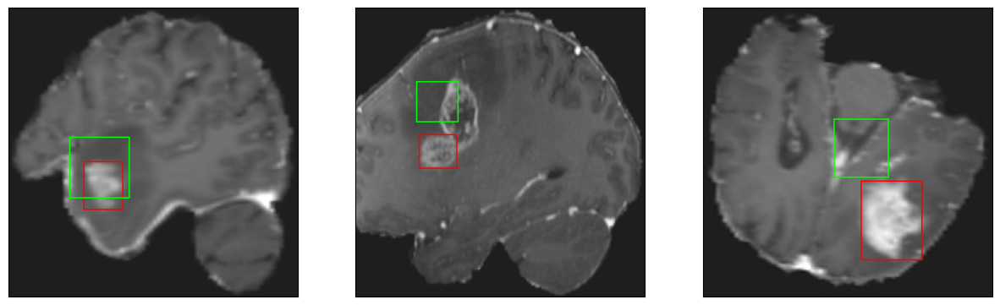

26/26 [==============================] - 3s 130ms/step - loss: 4.7609 - IoU: 0.6109 - val_loss: 12.9251 - val_IoU: 0.3534
Epoch 61/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8606 - IoU: 0.6130
Epoch 61: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


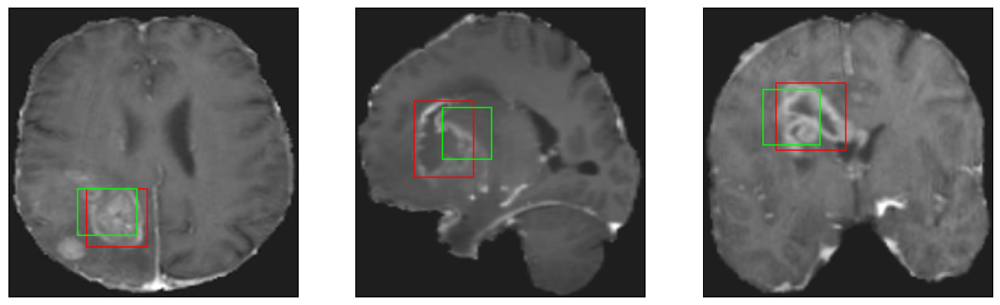

26/26 [==============================] - 3s 105ms/step - loss: 4.8366 - IoU: 0.6148 - val_loss: 12.3155 - val_IoU: 0.3726
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 4.8575 - IoU: 0.6144
Epoch 62: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


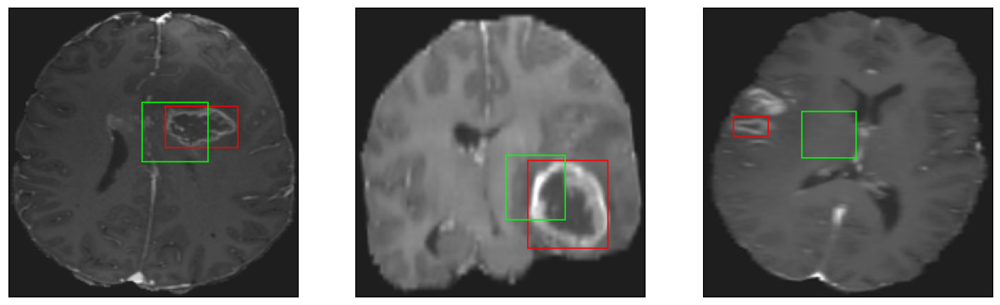

26/26 [==============================] - 3s 117ms/step - loss: 4.8575 - IoU: 0.6144 - val_loss: 12.3881 - val_IoU: 0.3780
Epoch 63/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8343 - IoU: 0.6111
Epoch 63: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


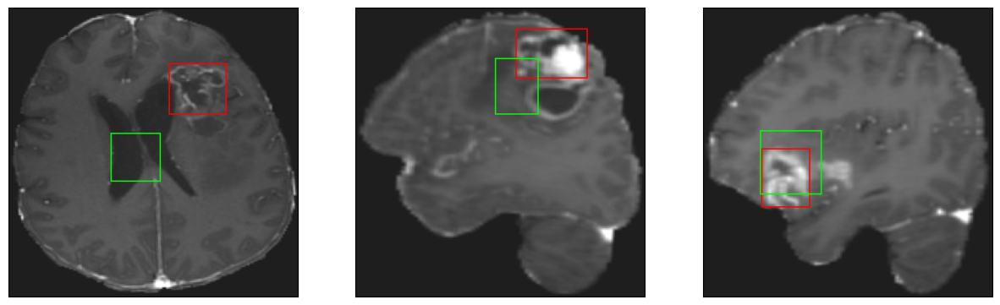

26/26 [==============================] - 3s 120ms/step - loss: 4.7861 - IoU: 0.6134 - val_loss: 12.2019 - val_IoU: 0.3888
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 4.6973 - IoU: 0.6199
Epoch 64: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


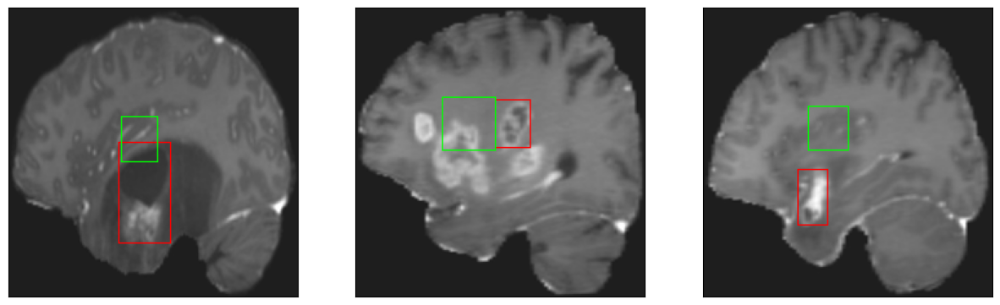

26/26 [==============================] - 3s 127ms/step - loss: 4.6973 - IoU: 0.6199 - val_loss: 13.6559 - val_IoU: 0.3240
Epoch 65/200
26/26 [==============================] - ETA: 0s - loss: 4.8719 - IoU: 0.6018
Epoch 65: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


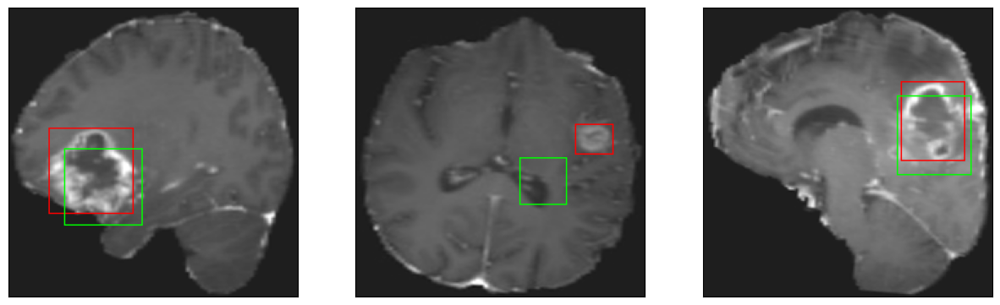

26/26 [==============================] - 3s 115ms/step - loss: 4.8719 - IoU: 0.6018 - val_loss: 12.4885 - val_IoU: 0.3737
Epoch 66/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6603 - IoU: 0.6201
Epoch 66: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


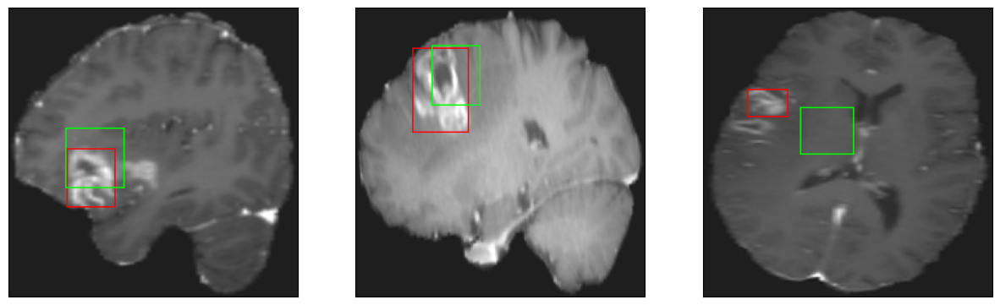

26/26 [==============================] - 3s 108ms/step - loss: 4.6674 - IoU: 0.6212 - val_loss: 12.0884 - val_IoU: 0.3898
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 4.7156 - IoU: 0.6141
Epoch 67: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


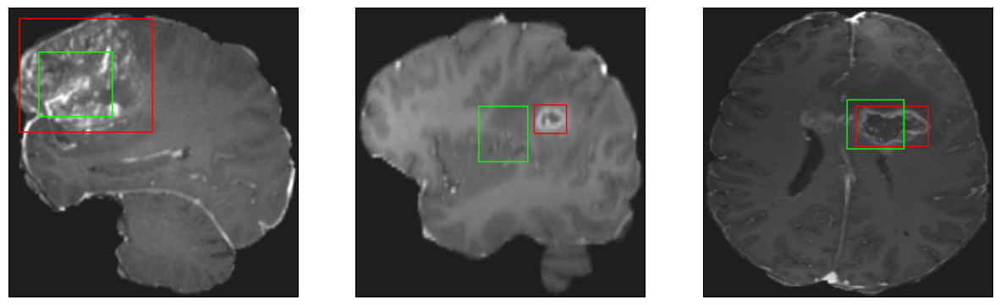

26/26 [==============================] - 4s 137ms/step - loss: 4.7156 - IoU: 0.6141 - val_loss: 13.1157 - val_IoU: 0.3460
Epoch 68/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6049 - IoU: 0.6206
Epoch 68: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


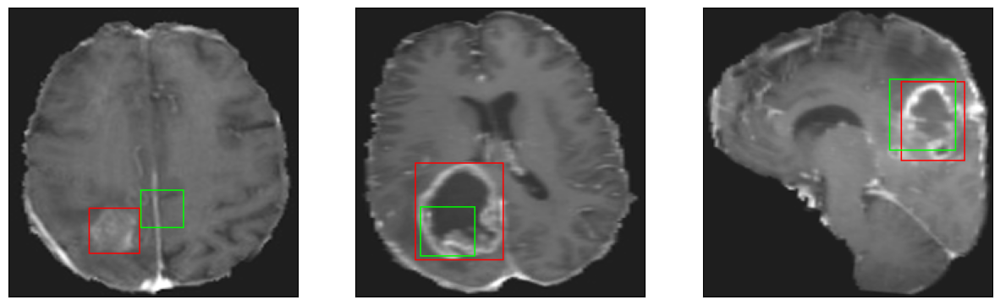

26/26 [==============================] - 3s 107ms/step - loss: 4.6582 - IoU: 0.6192 - val_loss: 13.6216 - val_IoU: 0.3283
Epoch 69/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8703 - IoU: 0.5942
Epoch 69: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


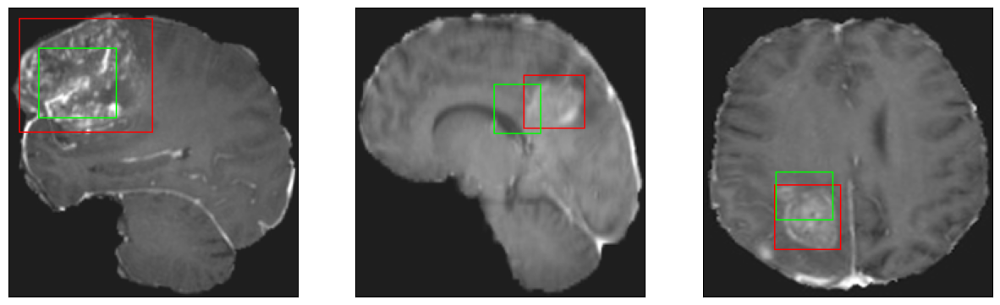

26/26 [==============================] - 3s 103ms/step - loss: 4.9129 - IoU: 0.5939 - val_loss: 13.4980 - val_IoU: 0.3444
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 5.0480 - IoU: 0.6026
Epoch 70: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


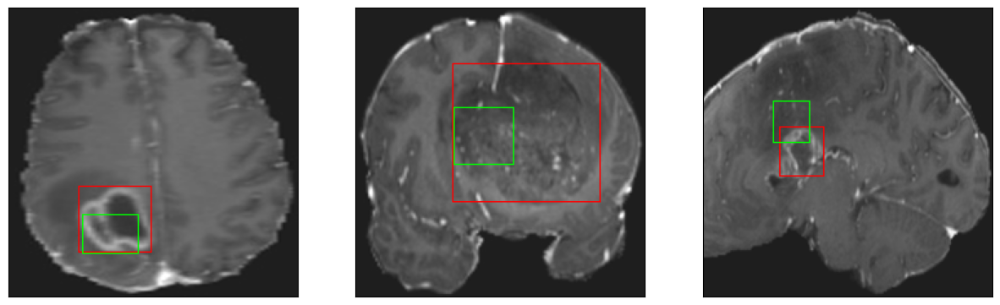

26/26 [==============================] - 3s 122ms/step - loss: 5.0480 - IoU: 0.6026 - val_loss: 12.5685 - val_IoU: 0.3708
Epoch 71/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6850 - IoU: 0.6203
Epoch 71: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


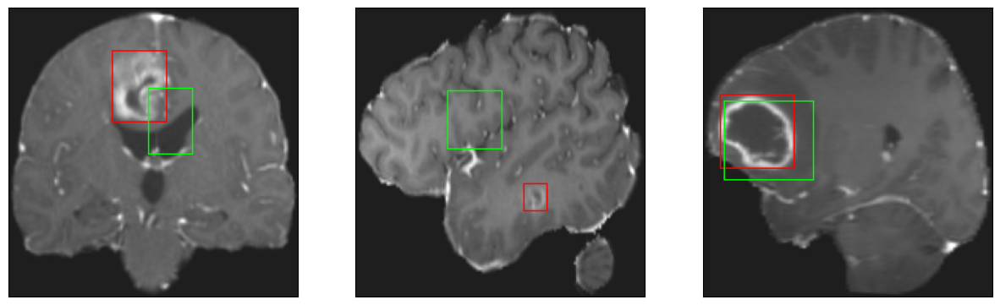

26/26 [==============================] - 3s 124ms/step - loss: 4.6685 - IoU: 0.6207 - val_loss: 12.8732 - val_IoU: 0.3596
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 4.7205 - IoU: 0.6144
Epoch 72: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


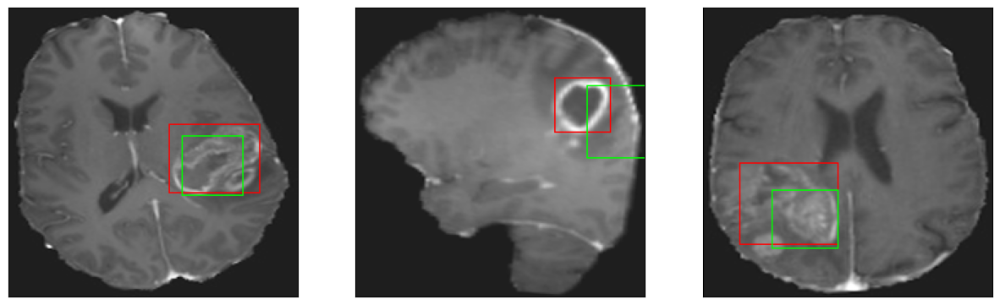

26/26 [==============================] - 3s 110ms/step - loss: 4.7205 - IoU: 0.6144 - val_loss: 11.9296 - val_IoU: 0.3985
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 4.6563 - IoU: 0.6159
Epoch 73: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


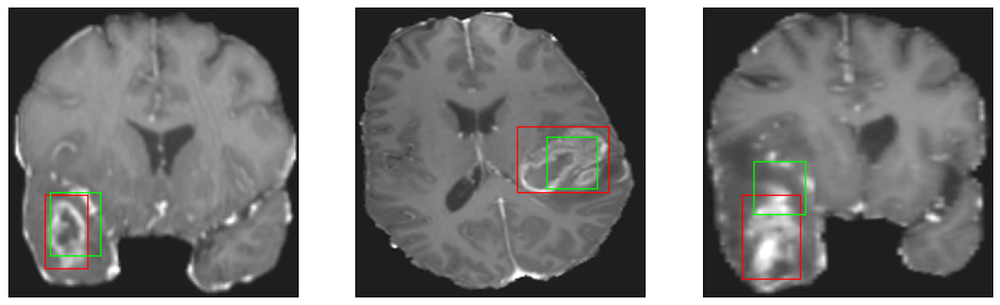

26/26 [==============================] - 3s 107ms/step - loss: 4.6563 - IoU: 0.6159 - val_loss: 12.8804 - val_IoU: 0.3544
Epoch 74/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9668 - IoU: 0.5919
Epoch 74: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


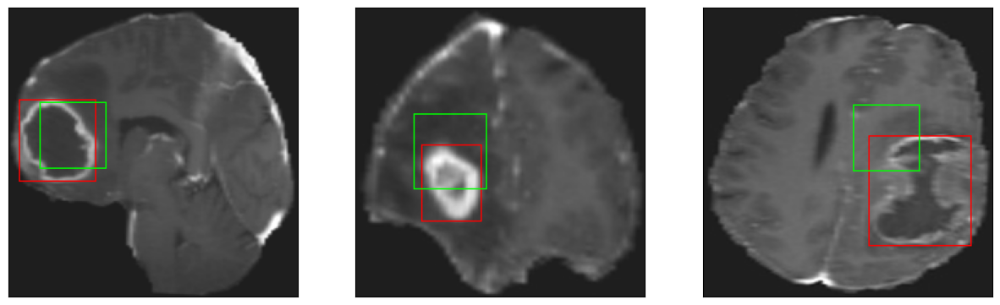

26/26 [==============================] - 3s 123ms/step - loss: 5.0207 - IoU: 0.5896 - val_loss: 12.6690 - val_IoU: 0.3570
Epoch 75/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9034 - IoU: 0.6059
Epoch 75: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


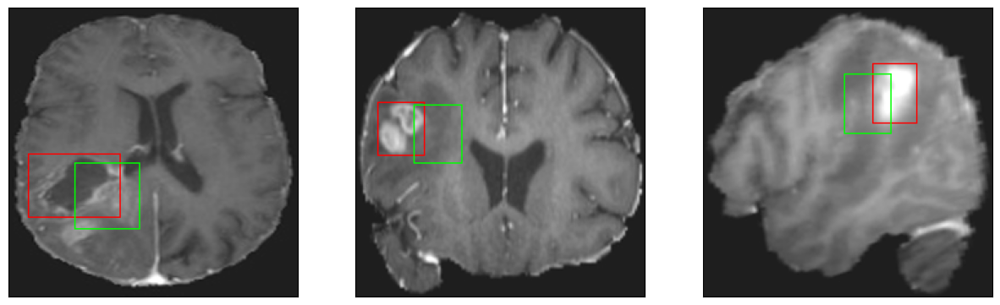

26/26 [==============================] - 3s 114ms/step - loss: 4.8876 - IoU: 0.6078 - val_loss: 13.6920 - val_IoU: 0.3437
Epoch 76/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6023 - IoU: 0.6173
Epoch 76: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


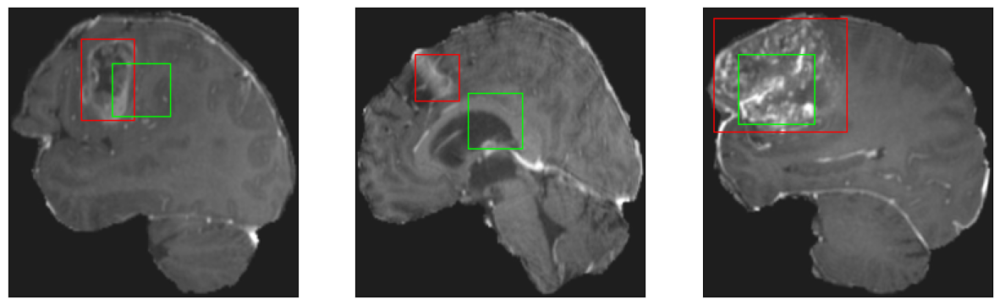

26/26 [==============================] - 3s 103ms/step - loss: 4.6293 - IoU: 0.6174 - val_loss: 12.3641 - val_IoU: 0.3805
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 4.5823 - IoU: 0.6322
Epoch 77: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


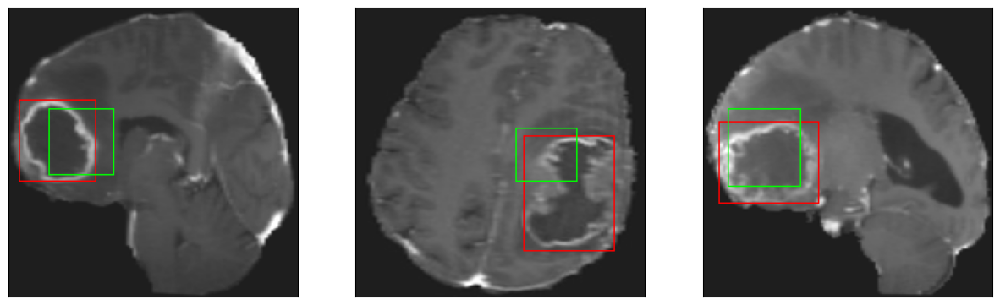

26/26 [==============================] - 3s 100ms/step - loss: 4.5823 - IoU: 0.6322 - val_loss: 12.4273 - val_IoU: 0.3824
Epoch 78/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3274 - IoU: 0.6403
Epoch 78: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


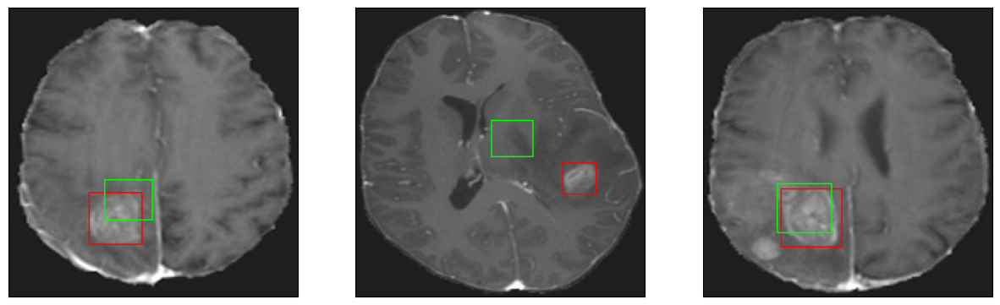

26/26 [==============================] - 3s 118ms/step - loss: 4.3588 - IoU: 0.6403 - val_loss: 13.4646 - val_IoU: 0.3379
Epoch 79/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6757 - IoU: 0.6173
Epoch 79: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


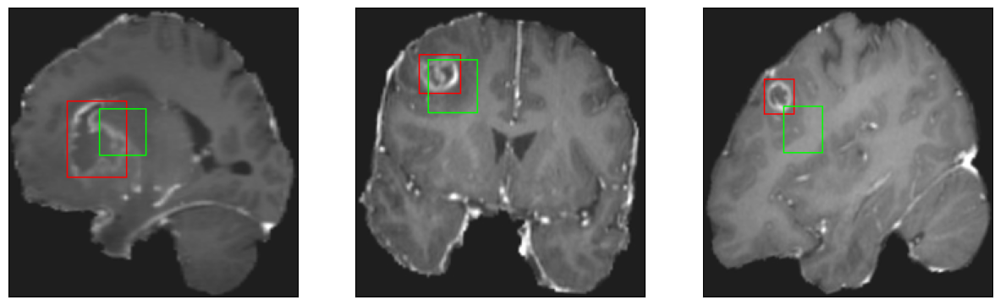

26/26 [==============================] - 3s 96ms/step - loss: 4.6626 - IoU: 0.6171 - val_loss: 12.0701 - val_IoU: 0.3902
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 4.5645 - IoU: 0.6246
Epoch 80: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


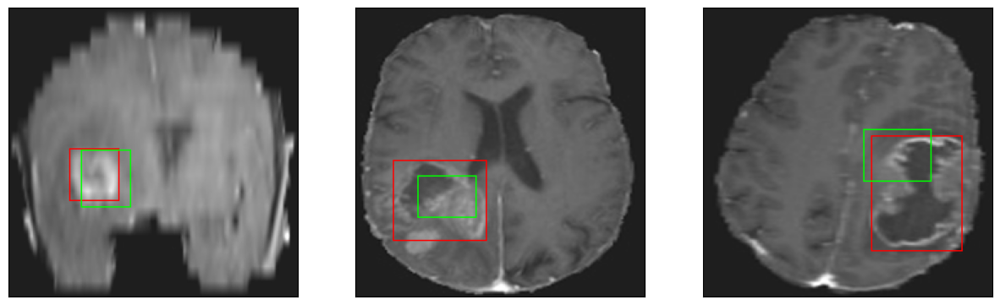

26/26 [==============================] - 3s 109ms/step - loss: 4.5645 - IoU: 0.6246 - val_loss: 12.0013 - val_IoU: 0.3913
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 4.5412 - IoU: 0.6241
Epoch 81: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4


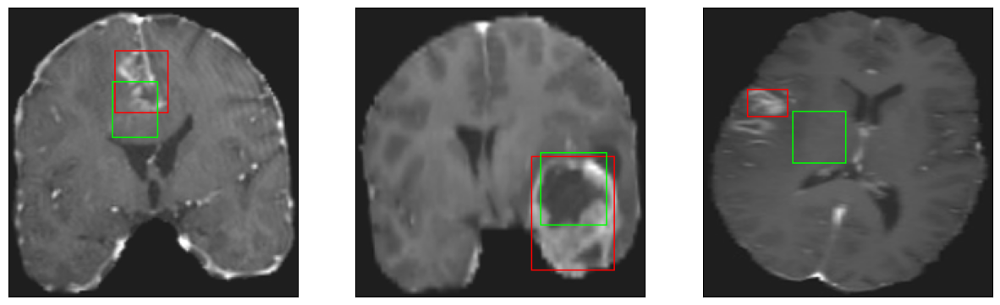

26/26 [==============================] - 4s 159ms/step - loss: 4.5412 - IoU: 0.6241 - val_loss: 12.0650 - val_IoU: 0.4076
Epoch 82/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5922 - IoU: 0.6303
Epoch 82: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


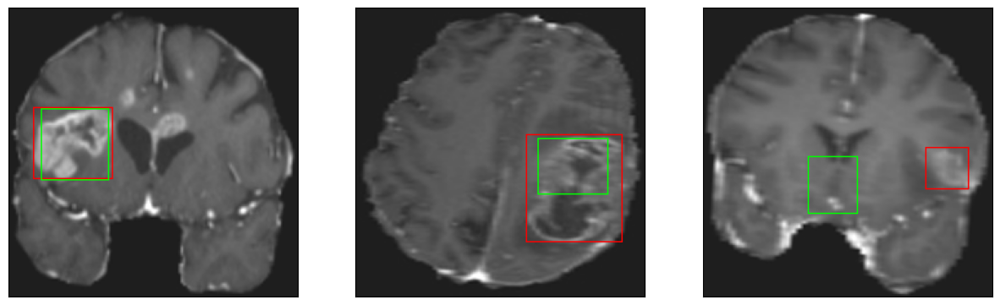

26/26 [==============================] - 3s 122ms/step - loss: 4.5592 - IoU: 0.6321 - val_loss: 12.2934 - val_IoU: 0.3792
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 4.5339 - IoU: 0.6247
Epoch 83: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


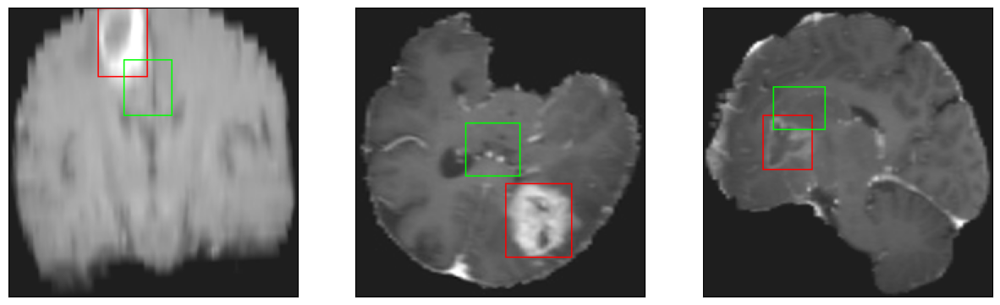

26/26 [==============================] - 3s 105ms/step - loss: 4.5339 - IoU: 0.6247 - val_loss: 12.1609 - val_IoU: 0.3903
Epoch 84/200
26/26 [==============================] - ETA: 0s - loss: 4.4026 - IoU: 0.6285
Epoch 84: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


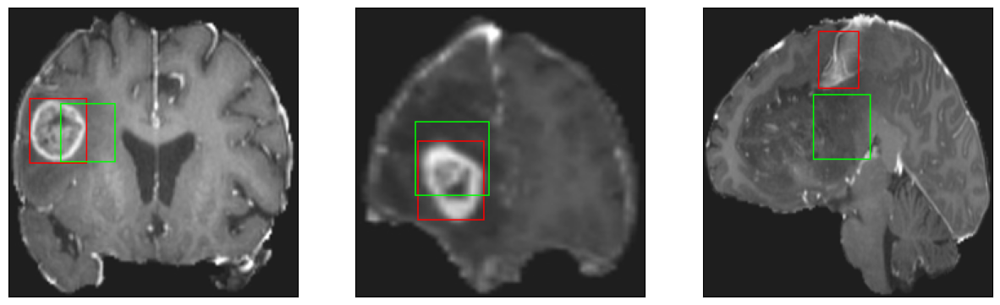

26/26 [==============================] - 2s 95ms/step - loss: 4.4026 - IoU: 0.6285 - val_loss: 12.4945 - val_IoU: 0.3836
Epoch 85/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4909 - IoU: 0.6315
Epoch 85: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


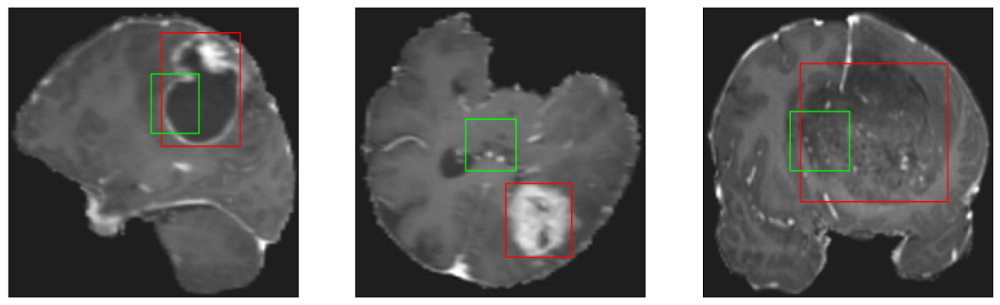

26/26 [==============================] - 2s 89ms/step - loss: 4.4939 - IoU: 0.6310 - val_loss: 13.3063 - val_IoU: 0.3465
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 4.6996 - IoU: 0.6235
Epoch 86: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


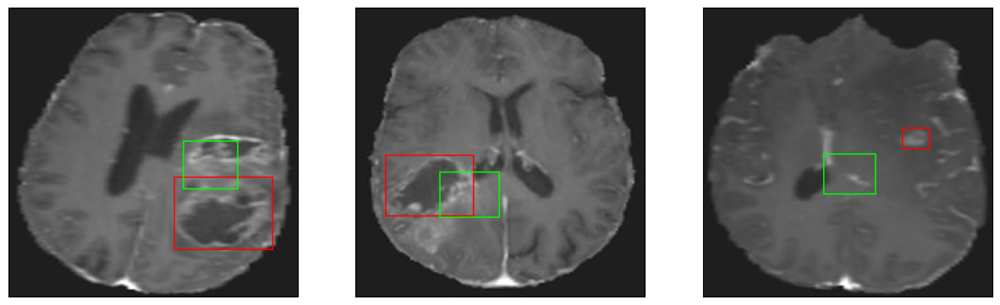

26/26 [==============================] - 3s 124ms/step - loss: 4.6996 - IoU: 0.6235 - val_loss: 12.4014 - val_IoU: 0.3792
Epoch 87/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3505 - IoU: 0.6429
Epoch 87: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


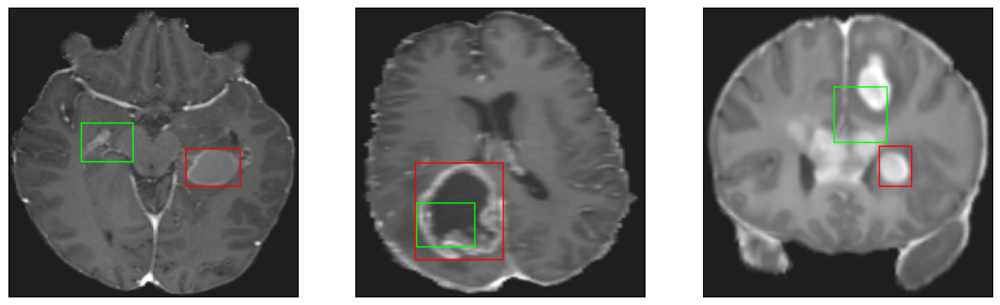

26/26 [==============================] - 3s 119ms/step - loss: 4.3684 - IoU: 0.6400 - val_loss: 13.6064 - val_IoU: 0.3269
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 4.8242 - IoU: 0.5969
Epoch 88: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


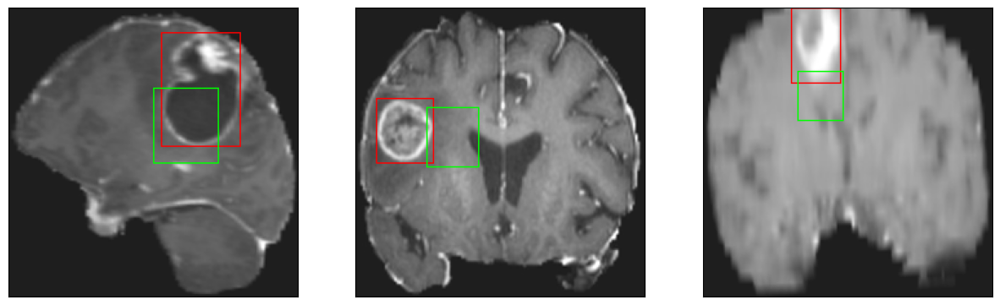

26/26 [==============================] - 3s 107ms/step - loss: 4.8242 - IoU: 0.5969 - val_loss: 14.6262 - val_IoU: 0.3126
Epoch 89/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5385 - IoU: 0.6296
Epoch 89: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


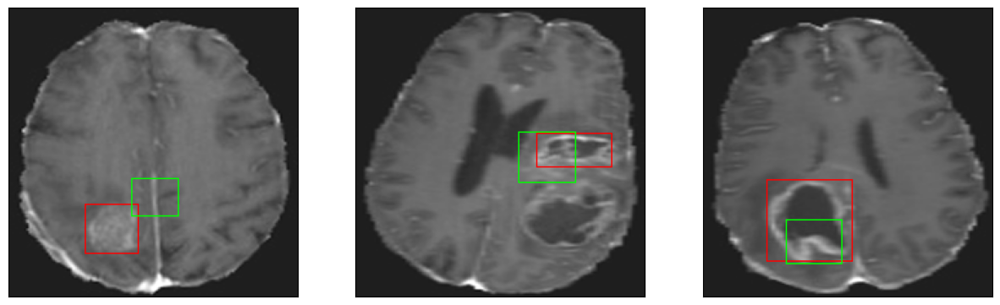

26/26 [==============================] - 3s 104ms/step - loss: 4.5354 - IoU: 0.6301 - val_loss: 12.3222 - val_IoU: 0.3750
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 4.3244 - IoU: 0.6365
Epoch 90: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


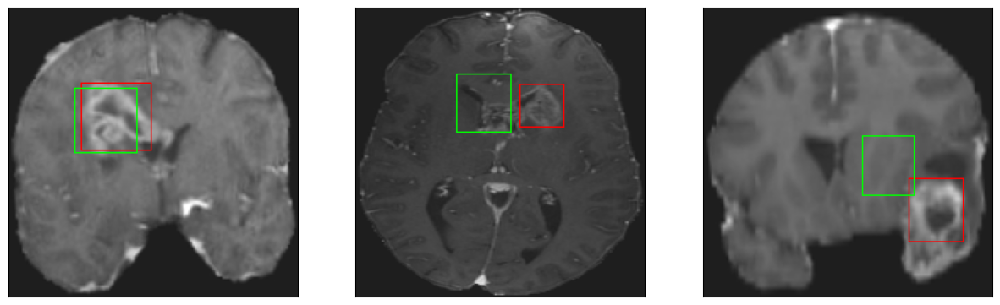

26/26 [==============================] - 3s 109ms/step - loss: 4.3244 - IoU: 0.6365 - val_loss: 12.1443 - val_IoU: 0.3900
Epoch 91/200
26/26 [==============================] - ETA: 0s - loss: 4.3734 - IoU: 0.6386
Epoch 91: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 8ms/step
4


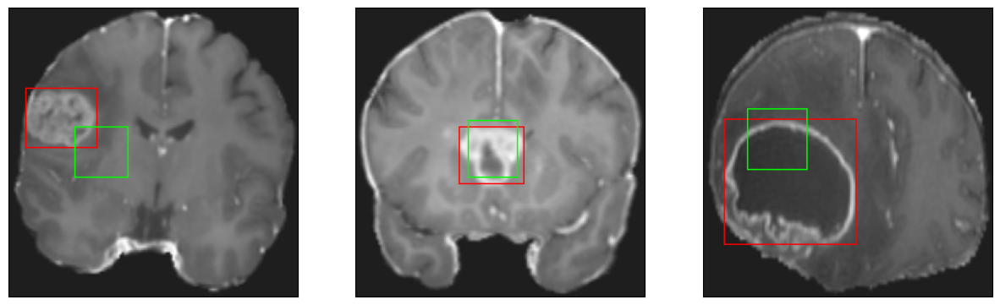

26/26 [==============================] - 3s 126ms/step - loss: 4.3734 - IoU: 0.6386 - val_loss: 12.8533 - val_IoU: 0.3474
Epoch 92/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3511 - IoU: 0.6395
Epoch 92: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


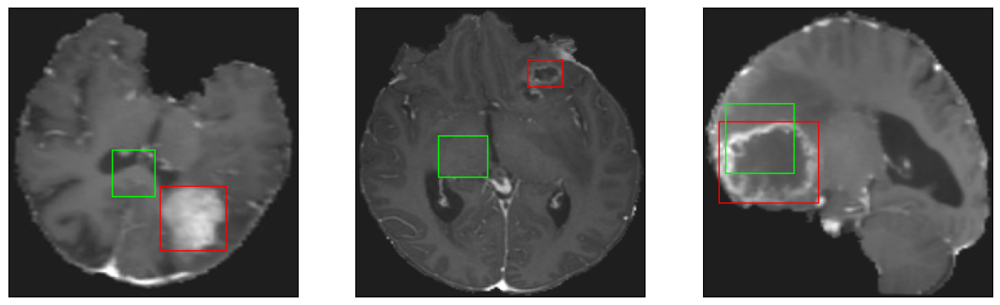

26/26 [==============================] - 3s 99ms/step - loss: 4.3816 - IoU: 0.6367 - val_loss: 12.6539 - val_IoU: 0.3751
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 4.2231 - IoU: 0.6527
Epoch 93: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


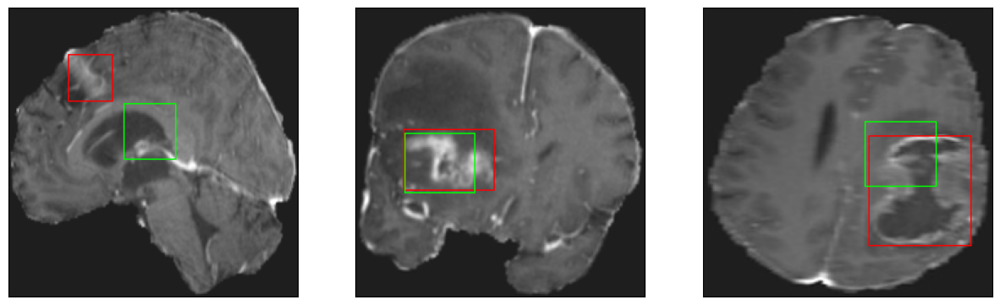

26/26 [==============================] - 3s 106ms/step - loss: 4.2231 - IoU: 0.6527 - val_loss: 11.9315 - val_IoU: 0.4066
Epoch 94/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4643 - IoU: 0.6342
Epoch 94: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


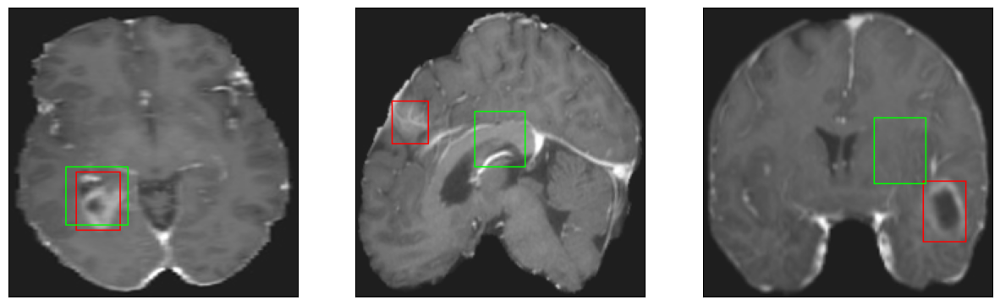

26/26 [==============================] - 3s 107ms/step - loss: 4.4712 - IoU: 0.6348 - val_loss: 12.1793 - val_IoU: 0.3832
Epoch 95/200
26/26 [==============================] - ETA: 0s - loss: 4.6814 - IoU: 0.6197
Epoch 95: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


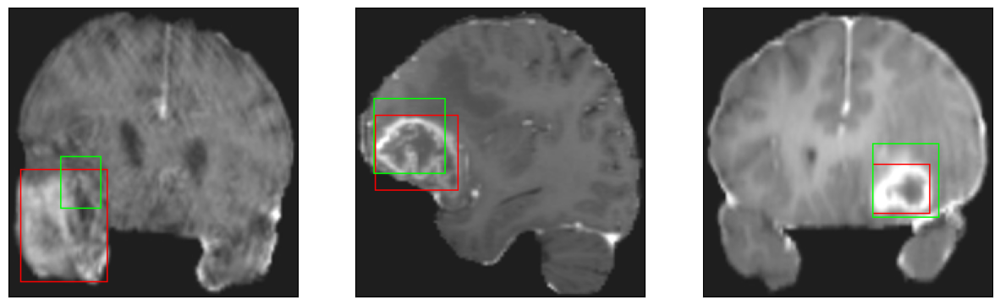

26/26 [==============================] - 3s 130ms/step - loss: 4.6814 - IoU: 0.6197 - val_loss: 12.3337 - val_IoU: 0.3711
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 4.3823 - IoU: 0.6328
Epoch 96: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


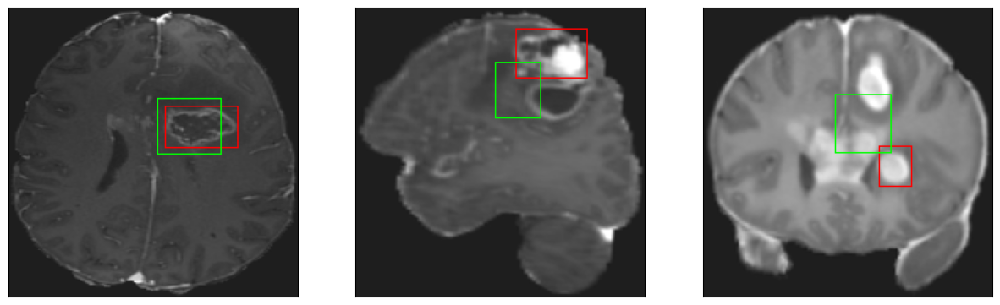

26/26 [==============================] - 3s 106ms/step - loss: 4.3823 - IoU: 0.6328 - val_loss: 12.5874 - val_IoU: 0.3748
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 4.3398 - IoU: 0.6373
Epoch 97: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


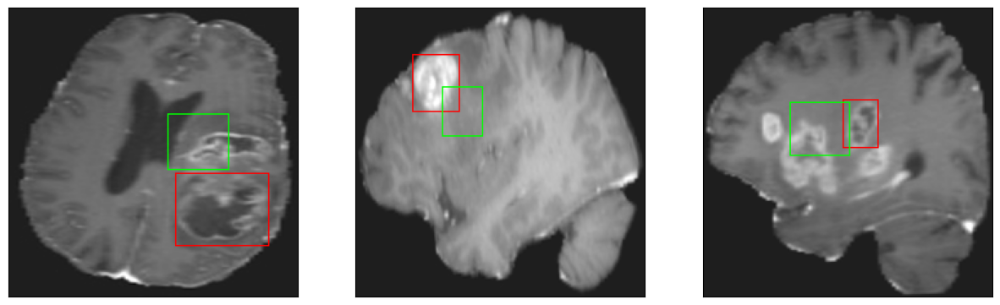

26/26 [==============================] - 3s 105ms/step - loss: 4.3398 - IoU: 0.6373 - val_loss: 12.0519 - val_IoU: 0.3828
Epoch 98/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2400 - IoU: 0.6498
Epoch 98: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


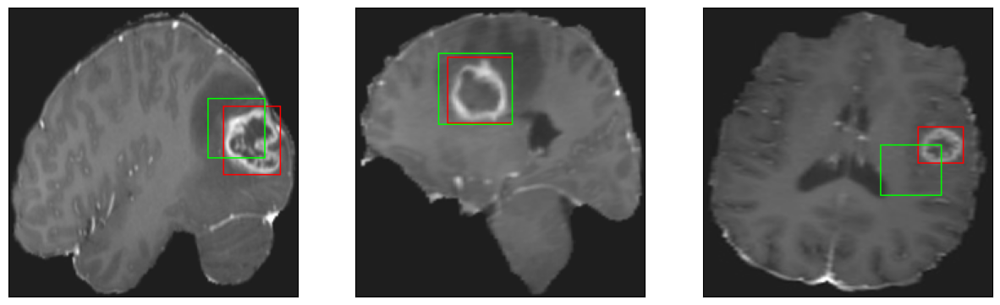

26/26 [==============================] - 3s 118ms/step - loss: 4.1910 - IoU: 0.6524 - val_loss: 11.7121 - val_IoU: 0.4052
Epoch 99/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3479 - IoU: 0.6403
Epoch 99: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


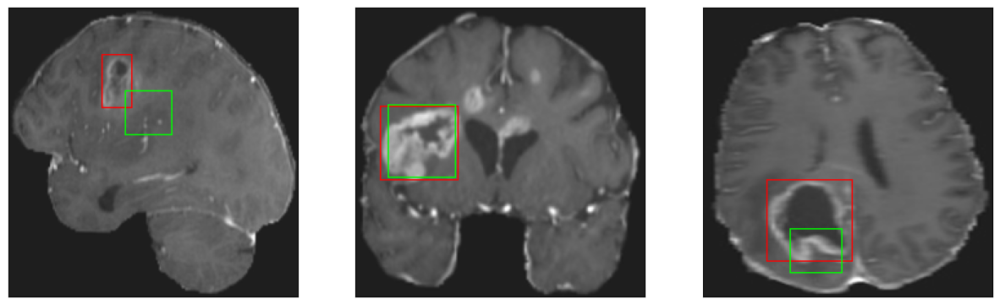

26/26 [==============================] - 3s 103ms/step - loss: 4.3597 - IoU: 0.6411 - val_loss: 11.7994 - val_IoU: 0.3967
Epoch 100/200
26/26 [==============================] - ETA: 0s - loss: 4.3320 - IoU: 0.6386
Epoch 100: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


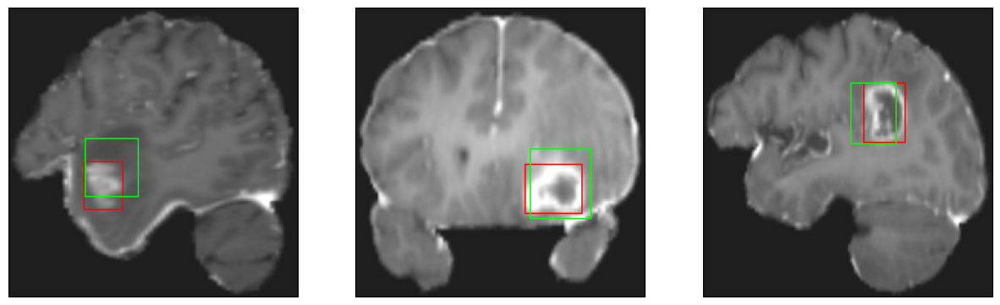

26/26 [==============================] - 2s 93ms/step - loss: 4.3320 - IoU: 0.6386 - val_loss: 12.6524 - val_IoU: 0.3672
Epoch 101/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2863 - IoU: 0.6501
Epoch 101: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


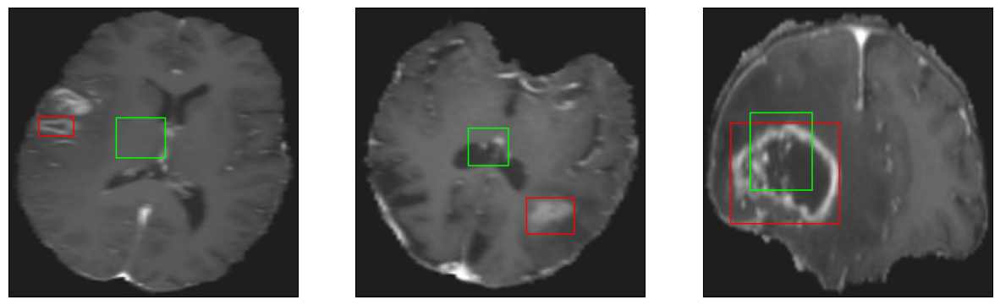

26/26 [==============================] - 3s 117ms/step - loss: 4.2677 - IoU: 0.6519 - val_loss: 12.0785 - val_IoU: 0.3875
Epoch 102/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2388 - IoU: 0.6463
Epoch 102: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


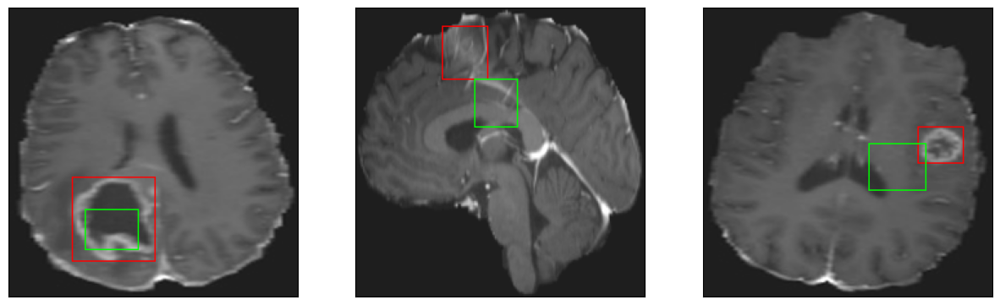

26/26 [==============================] - 3s 129ms/step - loss: 4.2060 - IoU: 0.6473 - val_loss: 12.6264 - val_IoU: 0.3644
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 4.2085 - IoU: 0.6474
Epoch 103: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


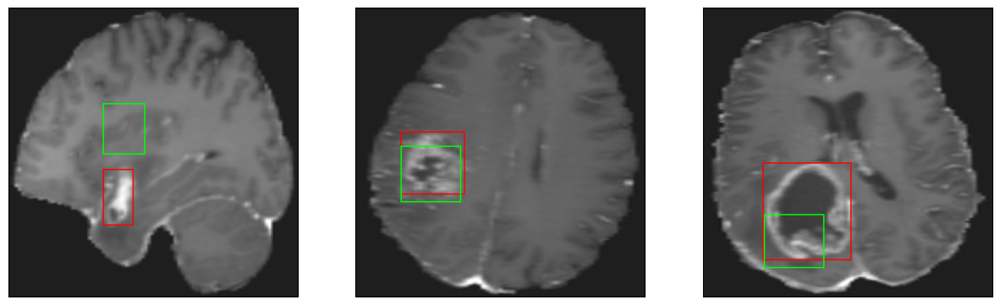

26/26 [==============================] - 3s 100ms/step - loss: 4.2085 - IoU: 0.6474 - val_loss: 12.4059 - val_IoU: 0.3793
Epoch 104/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1936 - IoU: 0.6469
Epoch 104: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


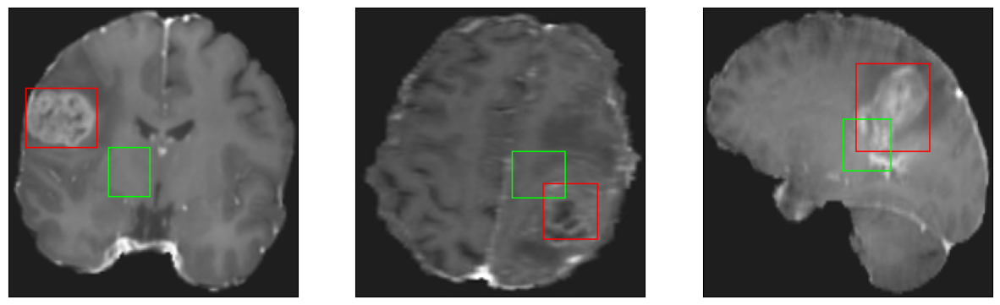

26/26 [==============================] - 2s 96ms/step - loss: 4.2110 - IoU: 0.6471 - val_loss: 12.6740 - val_IoU: 0.3703
Epoch 105/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3387 - IoU: 0.6437
Epoch 105: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


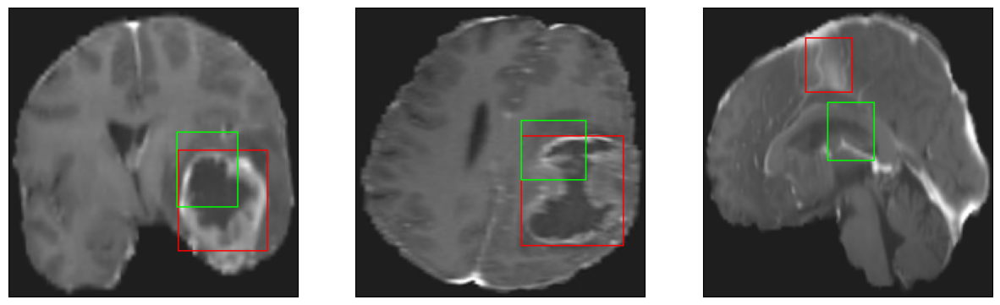

26/26 [==============================] - 3s 103ms/step - loss: 4.3450 - IoU: 0.6431 - val_loss: 12.3934 - val_IoU: 0.3760
Epoch 106/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2799 - IoU: 0.6471
Epoch 106: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


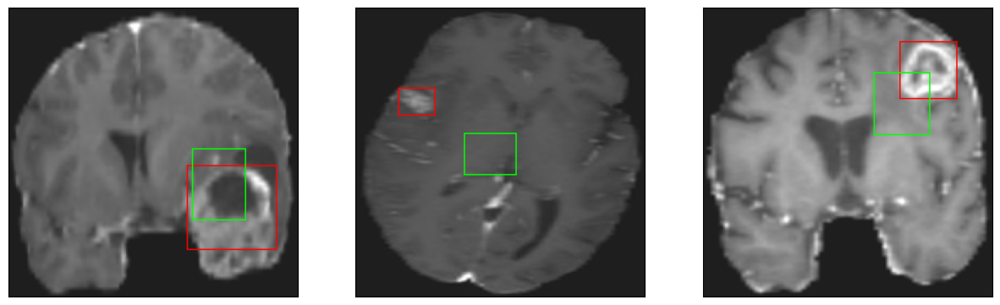

26/26 [==============================] - 3s 103ms/step - loss: 4.2701 - IoU: 0.6504 - val_loss: 11.7817 - val_IoU: 0.4004
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 4.1383 - IoU: 0.6587
Epoch 107: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


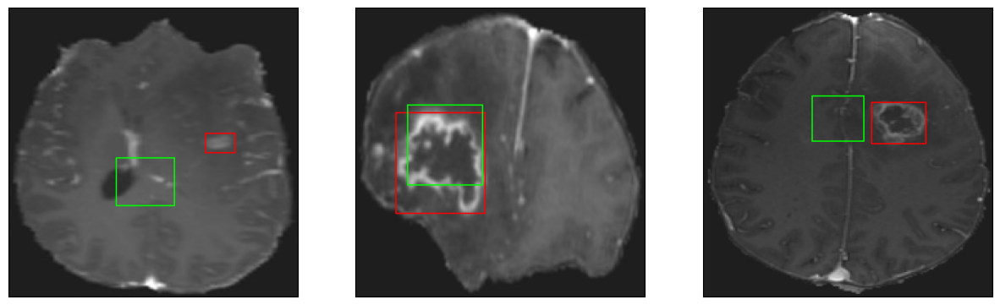

26/26 [==============================] - 3s 129ms/step - loss: 4.1383 - IoU: 0.6587 - val_loss: 12.2531 - val_IoU: 0.3775
Epoch 108/200
26/26 [==============================] - ETA: 0s - loss: 4.3374 - IoU: 0.6494
Epoch 108: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


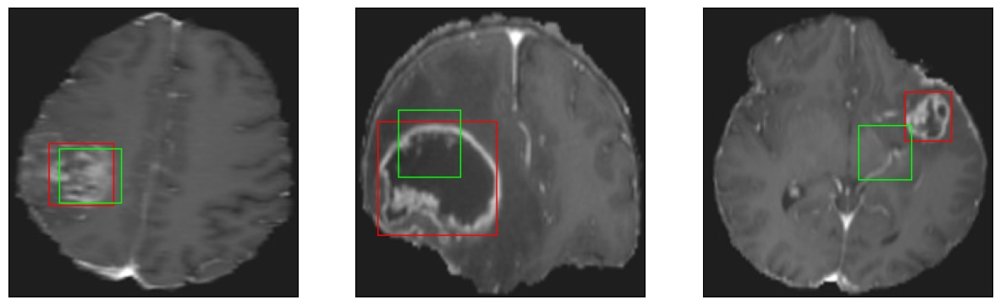

26/26 [==============================] - 3s 112ms/step - loss: 4.3374 - IoU: 0.6494 - val_loss: 11.8183 - val_IoU: 0.4087
Epoch 109/200
26/26 [==============================] - ETA: 0s - loss: 4.4793 - IoU: 0.6321
Epoch 109: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


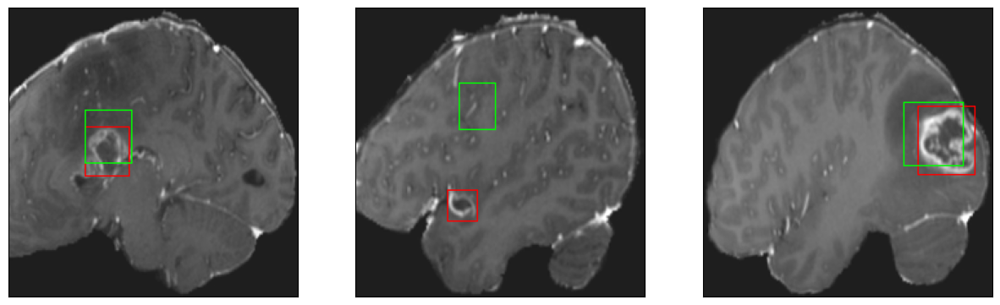

26/26 [==============================] - 3s 117ms/step - loss: 4.4793 - IoU: 0.6321 - val_loss: 12.3680 - val_IoU: 0.3828
Epoch 110/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3069 - IoU: 0.6481
Epoch 110: val_IoU did not improve from 0.40933
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 6ms/step
4


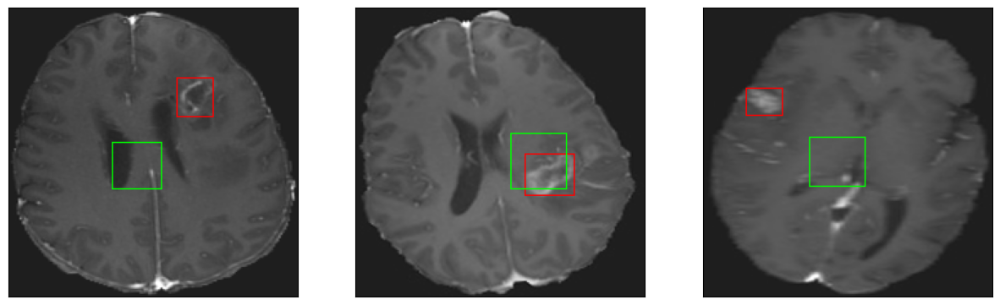

26/26 [==============================] - 3s 117ms/step - loss: 4.2878 - IoU: 0.6481 - val_loss: 11.8239 - val_IoU: 0.4057
Epoch 111/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2446 - IoU: 0.6462
Epoch 111: val_IoU improved from 0.40933 to 0.41259, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


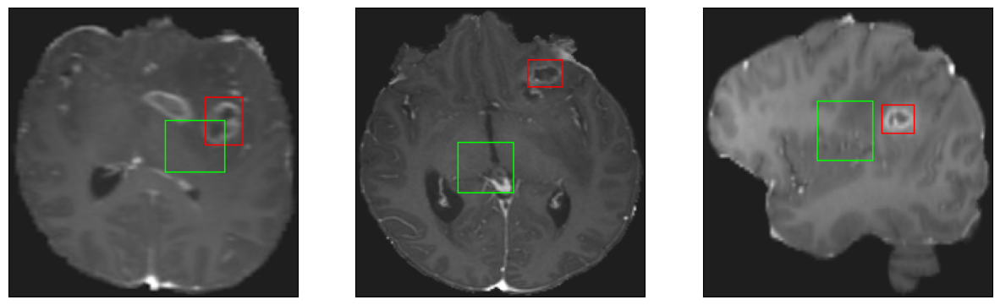

26/26 [==============================] - 6s 216ms/step - loss: 4.1976 - IoU: 0.6497 - val_loss: 11.6350 - val_IoU: 0.4126
Epoch 112/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0323 - IoU: 0.6637
Epoch 112: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


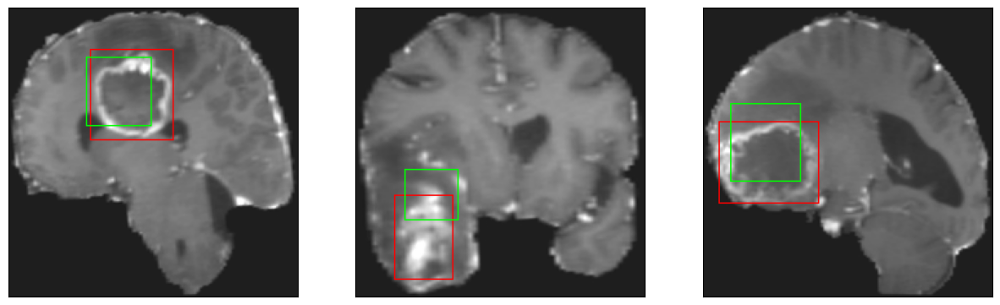

26/26 [==============================] - 3s 104ms/step - loss: 4.0418 - IoU: 0.6624 - val_loss: 11.9635 - val_IoU: 0.4016
Epoch 113/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0335 - IoU: 0.6663
Epoch 113: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


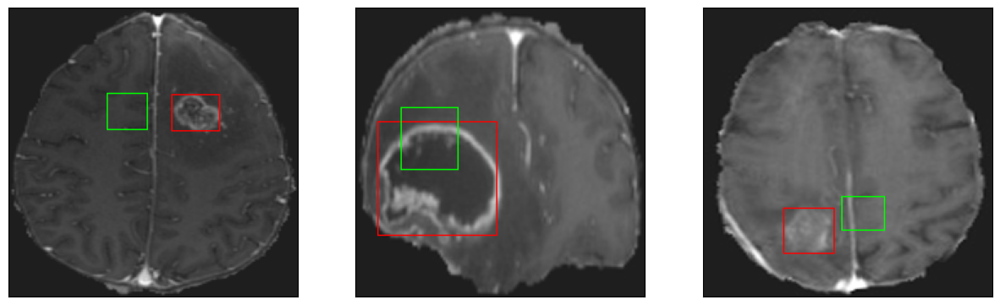

26/26 [==============================] - 3s 130ms/step - loss: 4.0185 - IoU: 0.6671 - val_loss: 12.0839 - val_IoU: 0.3924
Epoch 114/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9753 - IoU: 0.6682
Epoch 114: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


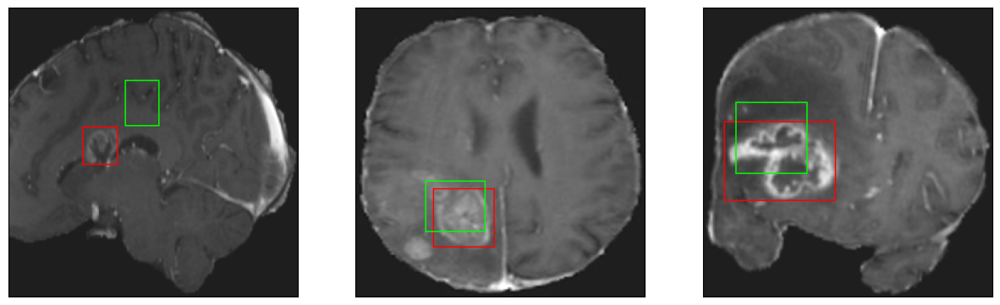

26/26 [==============================] - 3s 124ms/step - loss: 3.9531 - IoU: 0.6676 - val_loss: 13.2151 - val_IoU: 0.3381
Epoch 115/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1431 - IoU: 0.6591
Epoch 115: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


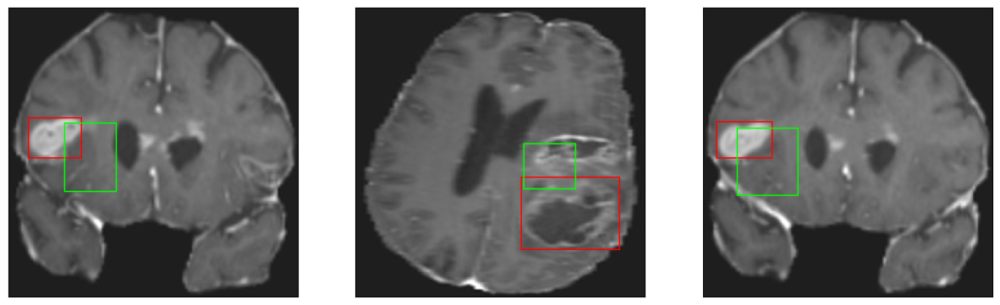

26/26 [==============================] - 3s 126ms/step - loss: 4.1738 - IoU: 0.6569 - val_loss: 12.2908 - val_IoU: 0.3766
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 4.1079 - IoU: 0.6554
Epoch 116: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


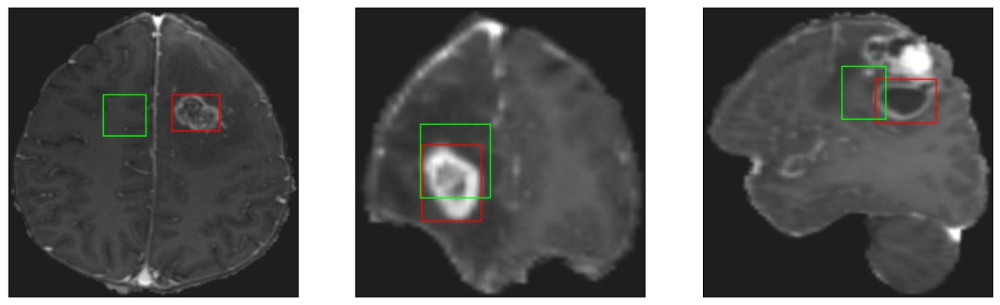

26/26 [==============================] - 3s 109ms/step - loss: 4.1079 - IoU: 0.6554 - val_loss: 11.8092 - val_IoU: 0.4032
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 4.1690 - IoU: 0.6561
Epoch 117: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


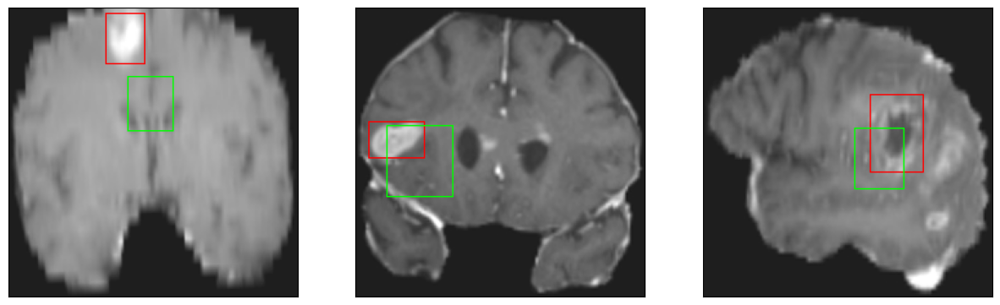

26/26 [==============================] - 3s 107ms/step - loss: 4.1690 - IoU: 0.6561 - val_loss: 11.8613 - val_IoU: 0.4007
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 4.0863 - IoU: 0.6566
Epoch 118: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


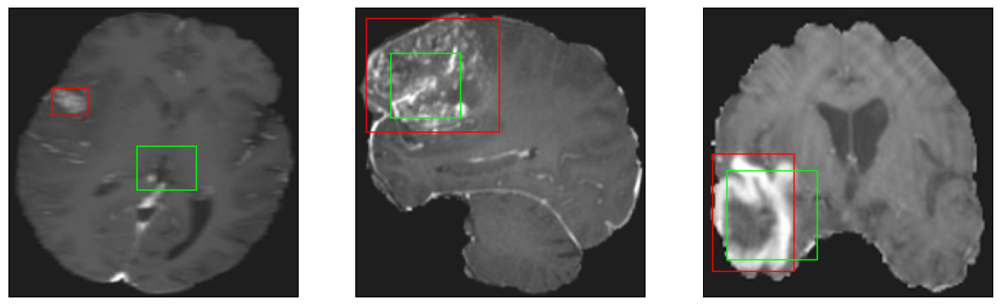

26/26 [==============================] - 3s 127ms/step - loss: 4.0863 - IoU: 0.6566 - val_loss: 12.3481 - val_IoU: 0.3897
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 4.2765 - IoU: 0.6463
Epoch 119: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


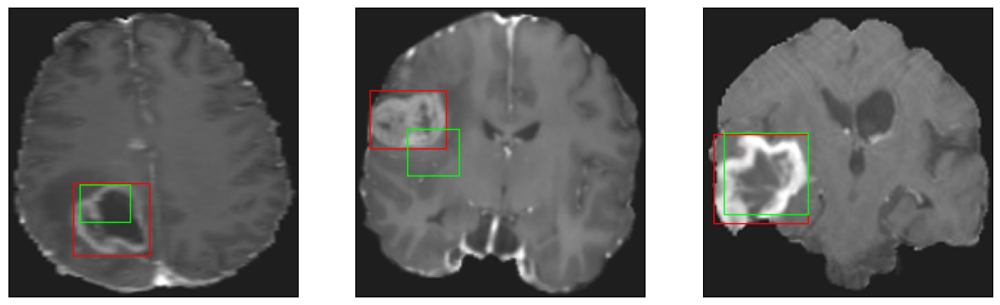

26/26 [==============================] - 3s 110ms/step - loss: 4.2765 - IoU: 0.6463 - val_loss: 12.5033 - val_IoU: 0.3760
Epoch 120/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0491 - IoU: 0.6657
Epoch 120: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


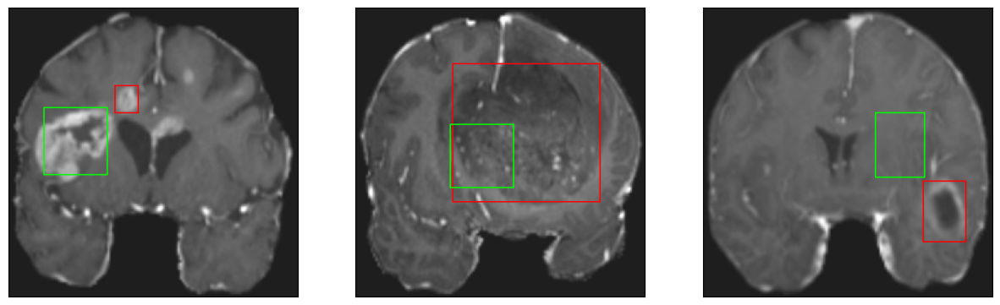

26/26 [==============================] - 3s 119ms/step - loss: 4.1004 - IoU: 0.6654 - val_loss: 11.6948 - val_IoU: 0.3993
Epoch 121/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2582 - IoU: 0.6506
Epoch 121: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


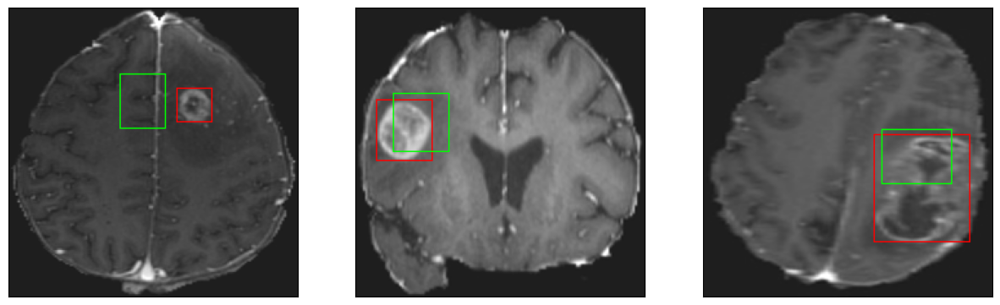

26/26 [==============================] - 3s 105ms/step - loss: 4.2242 - IoU: 0.6499 - val_loss: 12.2426 - val_IoU: 0.3824
Epoch 122/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9662 - IoU: 0.6680
Epoch 122: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


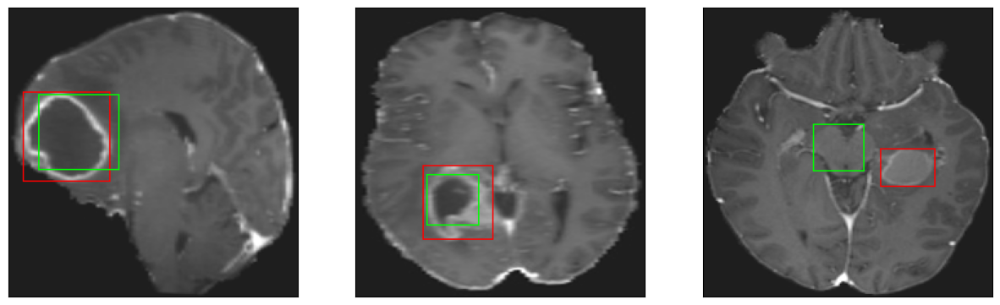

26/26 [==============================] - 3s 125ms/step - loss: 3.9407 - IoU: 0.6677 - val_loss: 11.7859 - val_IoU: 0.3983
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 3.9692 - IoU: 0.6658
Epoch 123: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


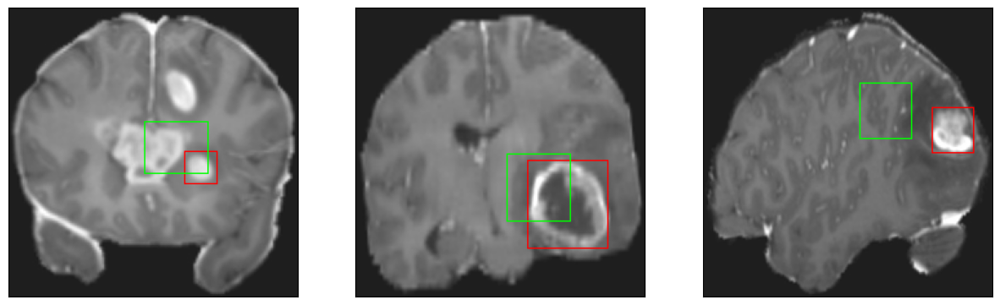

26/26 [==============================] - 3s 104ms/step - loss: 3.9692 - IoU: 0.6658 - val_loss: 11.8062 - val_IoU: 0.3966
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 3.9339 - IoU: 0.6714
Epoch 124: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


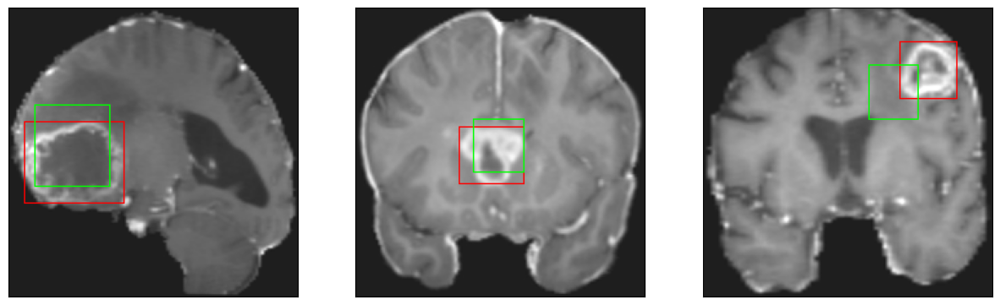

26/26 [==============================] - 3s 116ms/step - loss: 3.9339 - IoU: 0.6714 - val_loss: 11.6387 - val_IoU: 0.4081
Epoch 125/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8488 - IoU: 0.6696
Epoch 125: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


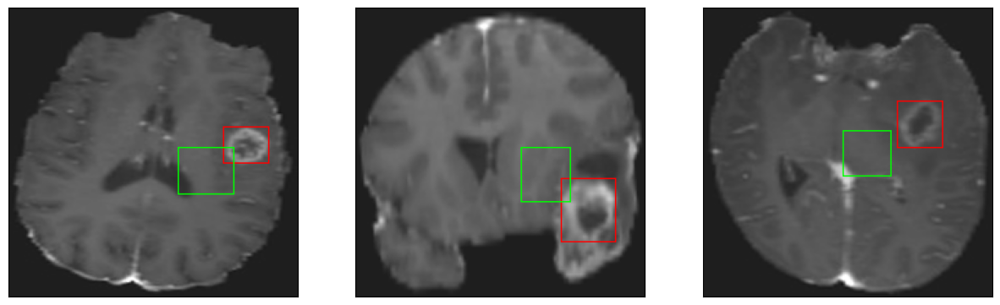

26/26 [==============================] - 3s 99ms/step - loss: 3.8627 - IoU: 0.6701 - val_loss: 12.1198 - val_IoU: 0.3857
Epoch 126/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9695 - IoU: 0.6656
Epoch 126: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


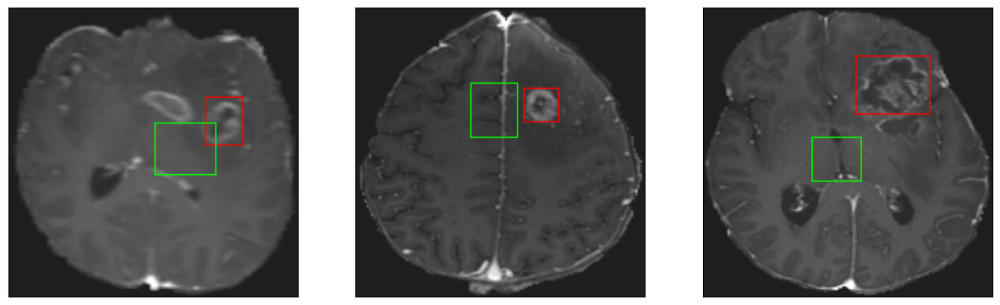

26/26 [==============================] - 3s 115ms/step - loss: 3.9822 - IoU: 0.6650 - val_loss: 11.6549 - val_IoU: 0.4078
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 3.9795 - IoU: 0.6699
Epoch 127: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


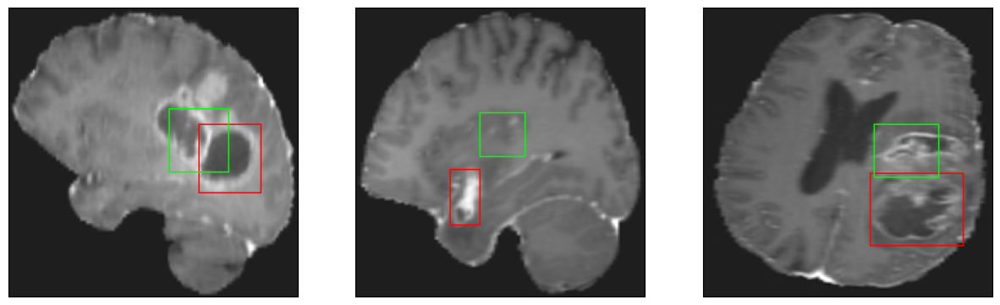

26/26 [==============================] - 3s 117ms/step - loss: 3.9795 - IoU: 0.6699 - val_loss: 11.7763 - val_IoU: 0.4044
Epoch 128/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9530 - IoU: 0.6657
Epoch 128: val_IoU did not improve from 0.41259
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


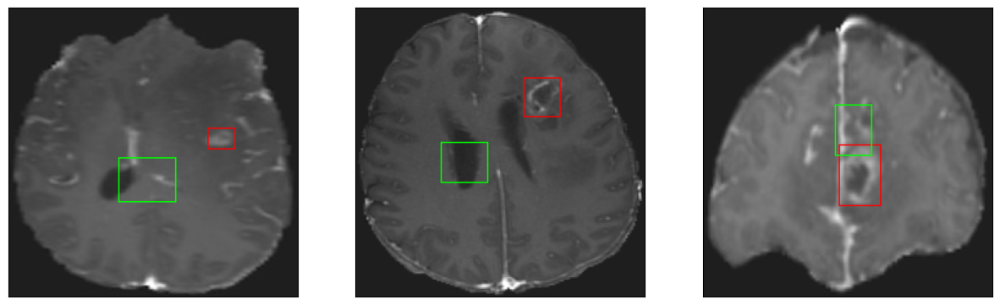

26/26 [==============================] - 2s 96ms/step - loss: 3.9668 - IoU: 0.6658 - val_loss: 11.4962 - val_IoU: 0.4093
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 3.8059 - IoU: 0.6756
Epoch 129: val_IoU improved from 0.41259 to 0.41287, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


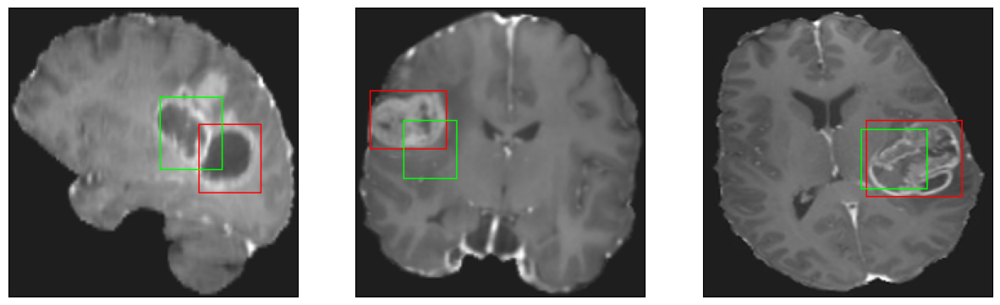

26/26 [==============================] - 5s 201ms/step - loss: 3.8059 - IoU: 0.6756 - val_loss: 11.5139 - val_IoU: 0.4129
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 3.8494 - IoU: 0.6754
Epoch 130: val_IoU did not improve from 0.41287
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


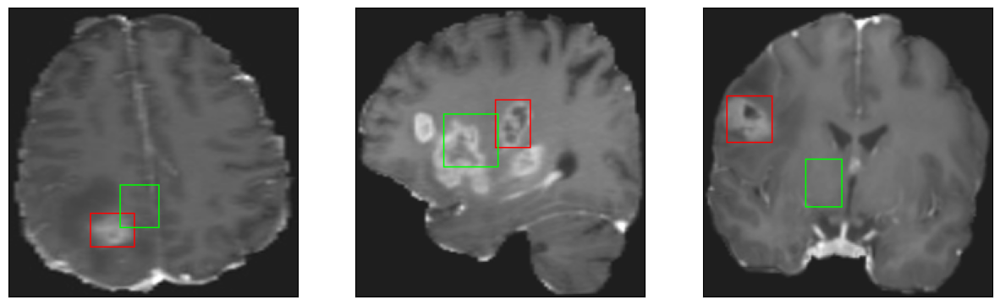

26/26 [==============================] - 3s 110ms/step - loss: 3.8494 - IoU: 0.6754 - val_loss: 11.6083 - val_IoU: 0.4067
Epoch 131/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2477 - IoU: 0.6420
Epoch 131: val_IoU improved from 0.41287 to 0.42216, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


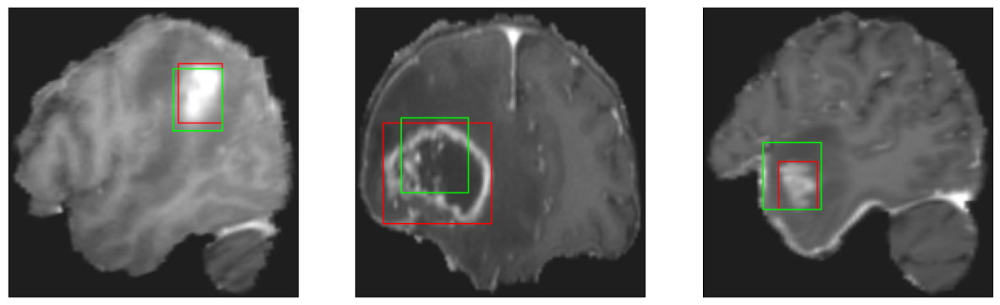

26/26 [==============================] - 3s 131ms/step - loss: 4.2810 - IoU: 0.6422 - val_loss: 11.4077 - val_IoU: 0.4222
Epoch 132/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1926 - IoU: 0.6531
Epoch 132: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


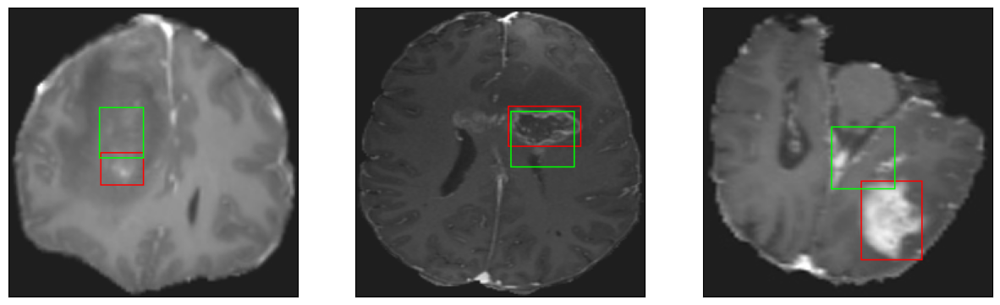

26/26 [==============================] - 3s 134ms/step - loss: 4.1596 - IoU: 0.6547 - val_loss: 11.4062 - val_IoU: 0.4198
Epoch 133/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0304 - IoU: 0.6555
Epoch 133: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


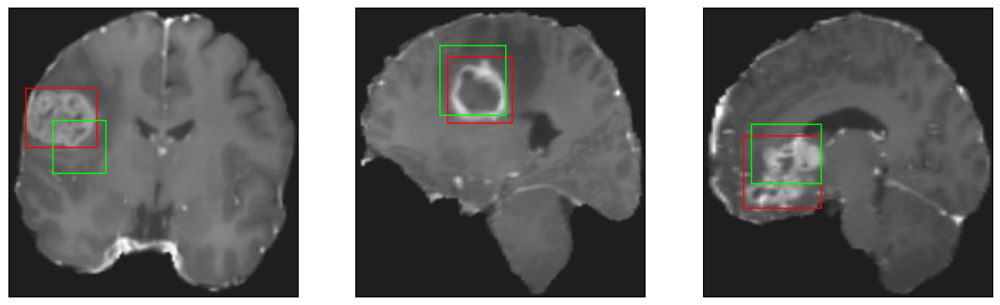

26/26 [==============================] - 3s 104ms/step - loss: 4.0064 - IoU: 0.6584 - val_loss: 12.0324 - val_IoU: 0.3893
Epoch 134/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0528 - IoU: 0.6603
Epoch 134: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


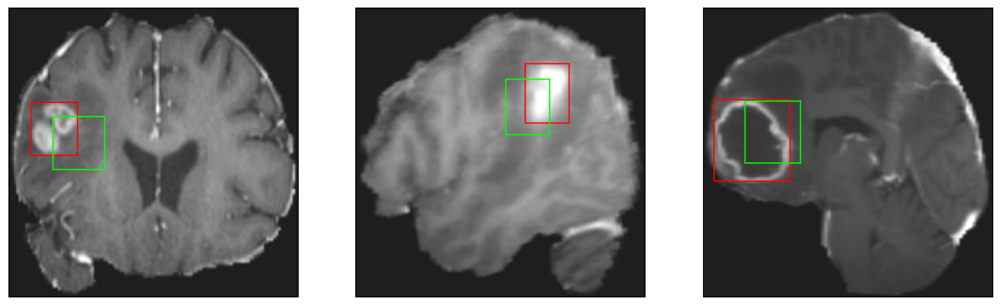

26/26 [==============================] - 3s 109ms/step - loss: 4.0478 - IoU: 0.6618 - val_loss: 11.8052 - val_IoU: 0.4037
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 4.0224 - IoU: 0.6616
Epoch 135: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


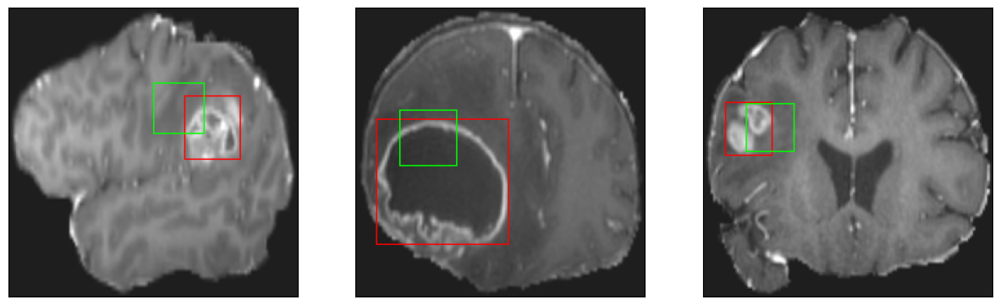

26/26 [==============================] - 3s 99ms/step - loss: 4.0224 - IoU: 0.6616 - val_loss: 12.9144 - val_IoU: 0.3451
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 3.9119 - IoU: 0.6734
Epoch 136: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


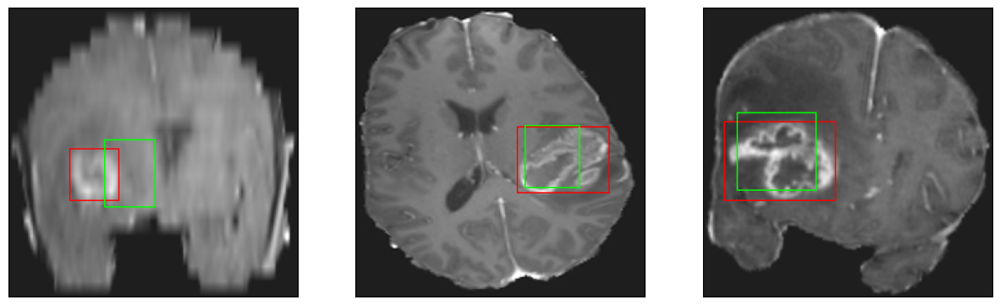

26/26 [==============================] - 3s 127ms/step - loss: 3.9119 - IoU: 0.6734 - val_loss: 12.8022 - val_IoU: 0.3702
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 3.9582 - IoU: 0.6710
Epoch 137: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


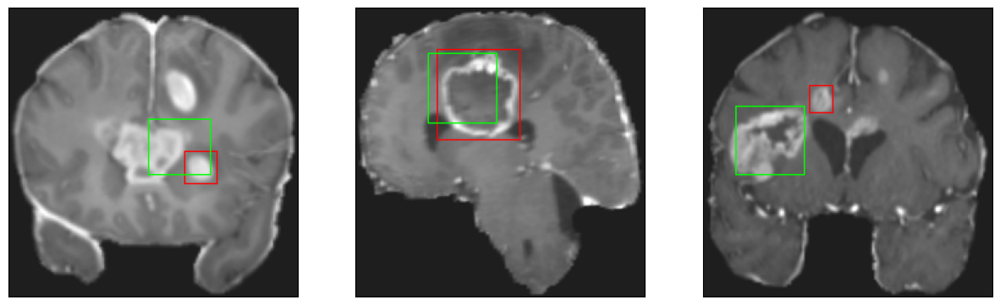

26/26 [==============================] - 3s 97ms/step - loss: 3.9582 - IoU: 0.6710 - val_loss: 11.8768 - val_IoU: 0.3961
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 3.9466 - IoU: 0.6685
Epoch 138: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


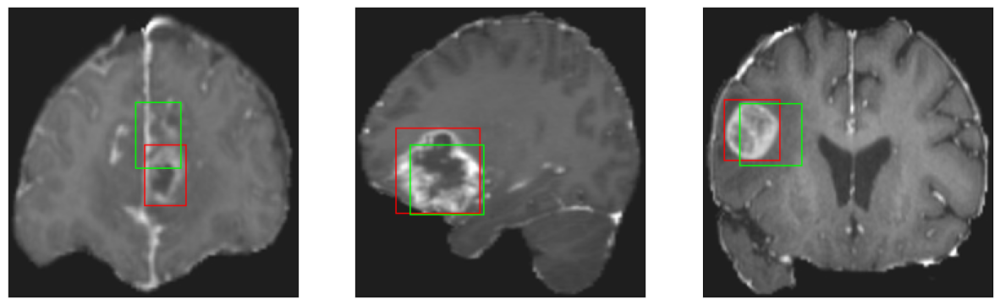

26/26 [==============================] - 3s 111ms/step - loss: 3.9466 - IoU: 0.6685 - val_loss: 11.6695 - val_IoU: 0.4108
Epoch 139/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9838 - IoU: 0.6657
Epoch 139: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 6ms/step
4


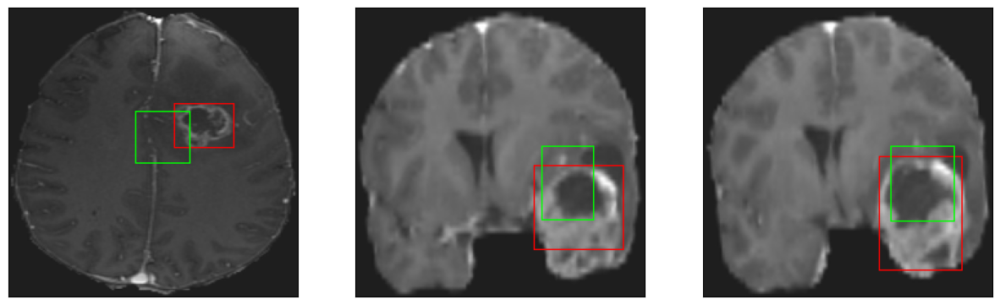

26/26 [==============================] - 3s 107ms/step - loss: 4.0280 - IoU: 0.6652 - val_loss: 11.6966 - val_IoU: 0.4089
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 3.6990 - IoU: 0.6835
Epoch 140: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


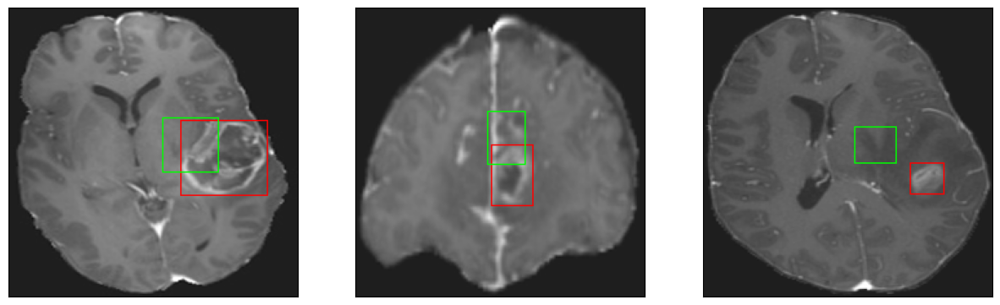

26/26 [==============================] - 4s 155ms/step - loss: 3.6990 - IoU: 0.6835 - val_loss: 12.0693 - val_IoU: 0.3962
Epoch 141/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8982 - IoU: 0.6694
Epoch 141: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


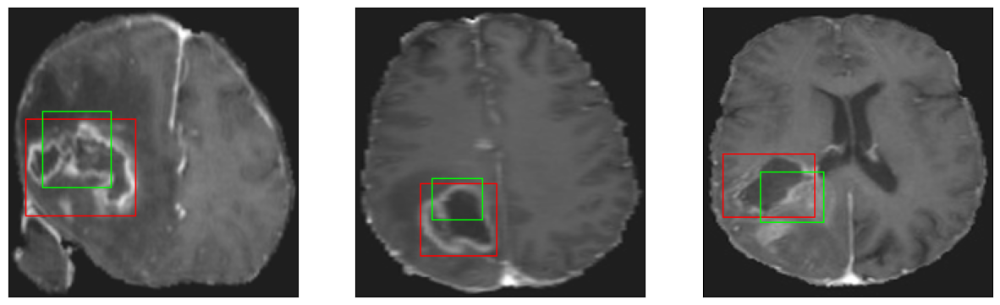

26/26 [==============================] - 3s 108ms/step - loss: 3.8590 - IoU: 0.6719 - val_loss: 11.9073 - val_IoU: 0.3925
Epoch 142/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8001 - IoU: 0.6755
Epoch 142: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


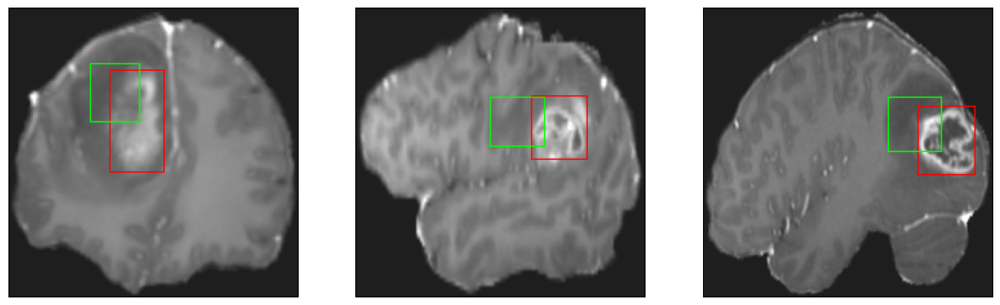

26/26 [==============================] - 3s 96ms/step - loss: 3.8665 - IoU: 0.6745 - val_loss: 11.7326 - val_IoU: 0.4084
Epoch 143/200
26/26 [==============================] - ETA: 0s - loss: 3.8236 - IoU: 0.6736
Epoch 143: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


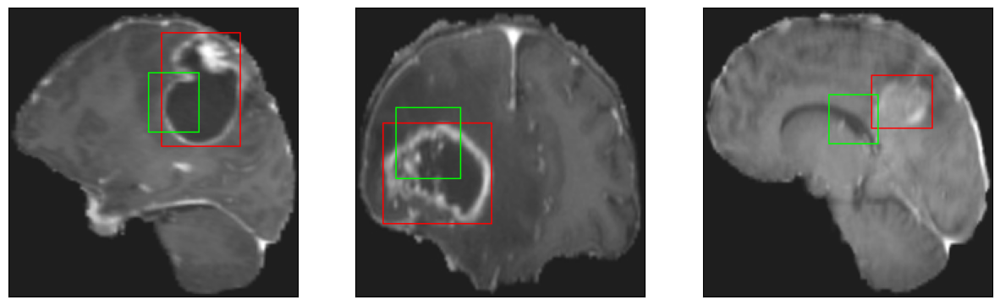

26/26 [==============================] - 3s 107ms/step - loss: 3.8236 - IoU: 0.6736 - val_loss: 12.2026 - val_IoU: 0.3797
Epoch 144/200
26/26 [==============================] - ETA: 0s - loss: 3.6731 - IoU: 0.6877
Epoch 144: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


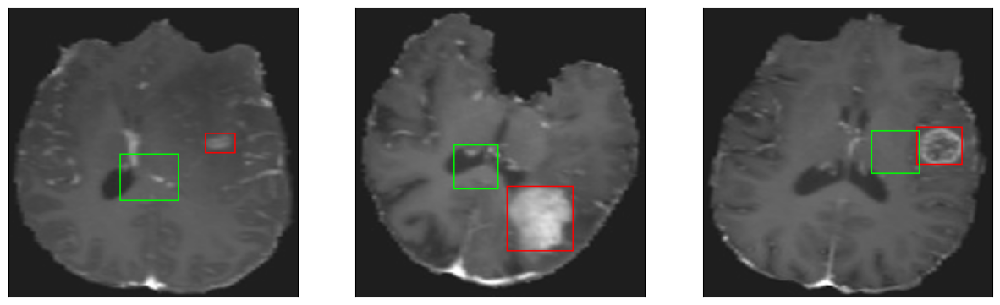

26/26 [==============================] - 3s 114ms/step - loss: 3.6731 - IoU: 0.6877 - val_loss: 12.4875 - val_IoU: 0.3737
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 3.8097 - IoU: 0.6816
Epoch 145: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


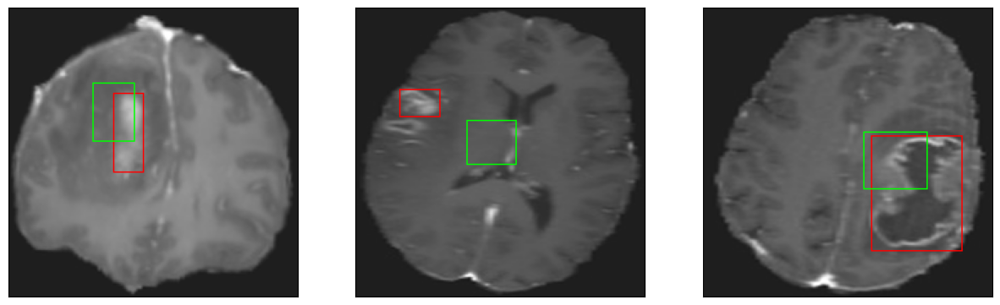

26/26 [==============================] - 3s 103ms/step - loss: 3.8097 - IoU: 0.6816 - val_loss: 11.4149 - val_IoU: 0.4144
Epoch 146/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9396 - IoU: 0.6662
Epoch 146: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


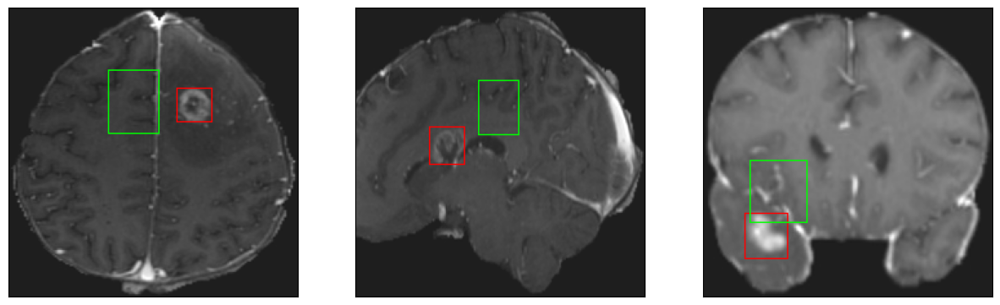

26/26 [==============================] - 3s 106ms/step - loss: 3.9328 - IoU: 0.6663 - val_loss: 11.9385 - val_IoU: 0.3997
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 3.7502 - IoU: 0.6818
Epoch 147: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


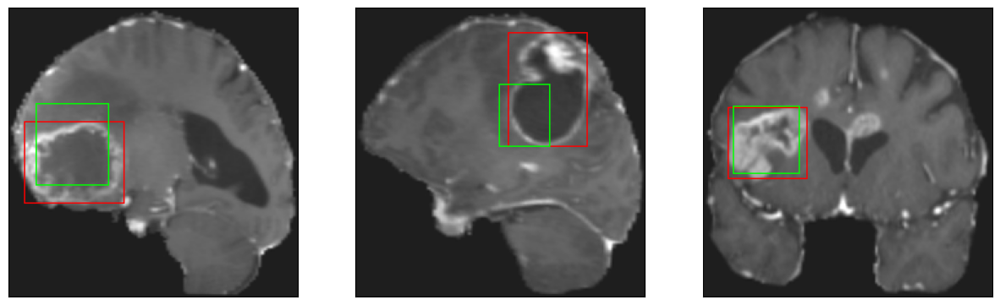

26/26 [==============================] - 3s 110ms/step - loss: 3.7502 - IoU: 0.6818 - val_loss: 11.4985 - val_IoU: 0.4070
Epoch 148/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9677 - IoU: 0.6677
Epoch 148: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


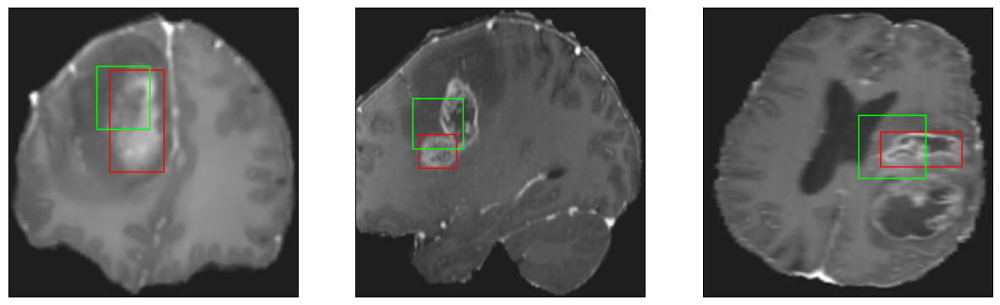

26/26 [==============================] - 4s 135ms/step - loss: 3.9299 - IoU: 0.6695 - val_loss: 13.6481 - val_IoU: 0.3301
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 3.8454 - IoU: 0.6716
Epoch 149: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


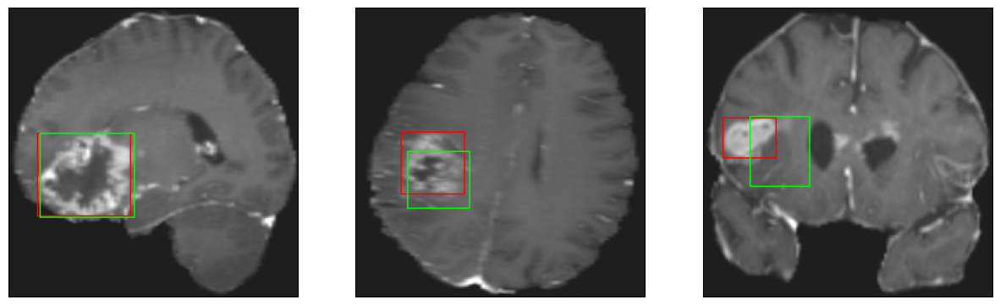

26/26 [==============================] - 3s 117ms/step - loss: 3.8454 - IoU: 0.6716 - val_loss: 11.6740 - val_IoU: 0.4182
Epoch 150/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8026 - IoU: 0.6830
Epoch 150: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


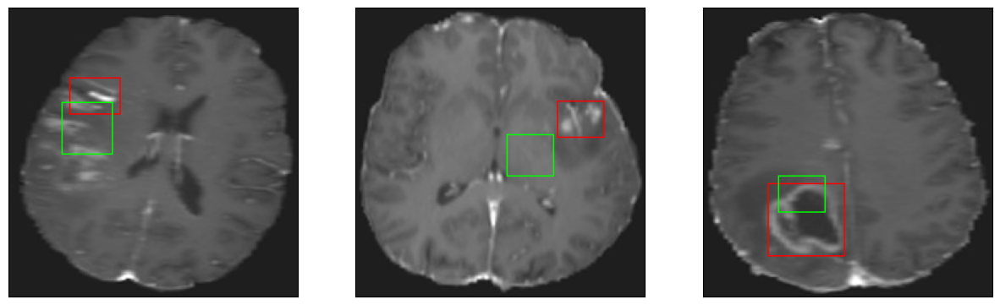

26/26 [==============================] - 3s 98ms/step - loss: 3.7495 - IoU: 0.6859 - val_loss: 11.6200 - val_IoU: 0.4055
Epoch 151/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9571 - IoU: 0.6654
Epoch 151: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


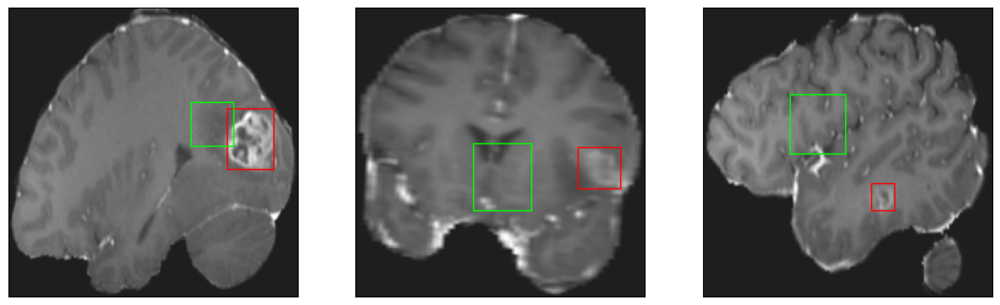

26/26 [==============================] - 3s 97ms/step - loss: 3.9495 - IoU: 0.6665 - val_loss: 12.1674 - val_IoU: 0.3903
Epoch 152/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1096 - IoU: 0.6587
Epoch 152: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


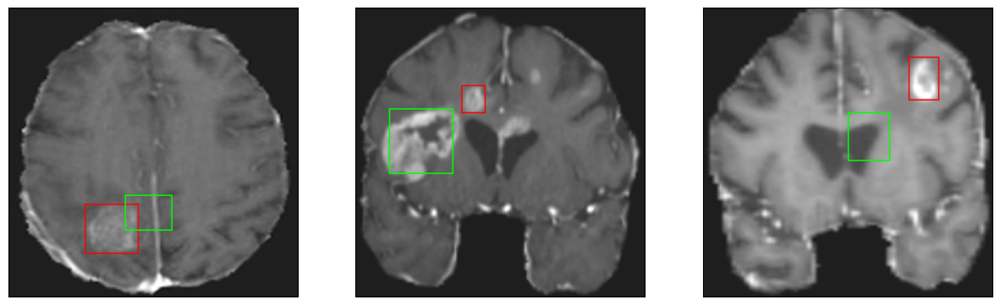

26/26 [==============================] - 3s 102ms/step - loss: 4.0959 - IoU: 0.6596 - val_loss: 12.2995 - val_IoU: 0.3806
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 3.7590 - IoU: 0.6859
Epoch 153: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


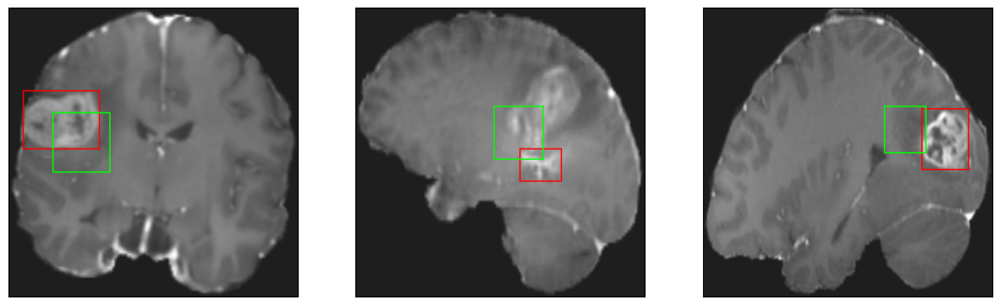

26/26 [==============================] - 4s 135ms/step - loss: 3.7590 - IoU: 0.6859 - val_loss: 12.5145 - val_IoU: 0.3733
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 3.7278 - IoU: 0.6840
Epoch 154: val_IoU did not improve from 0.42216
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


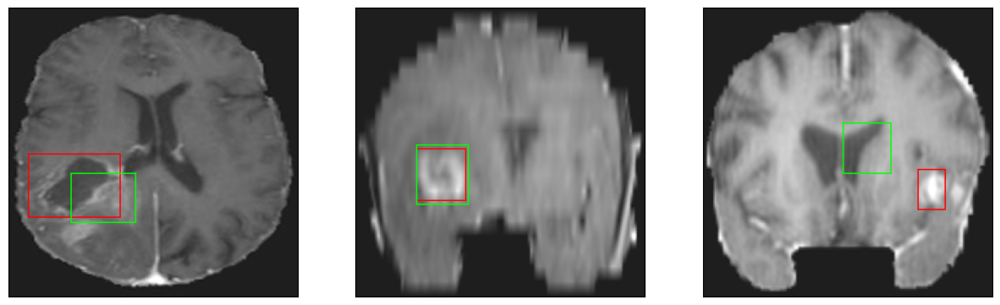

26/26 [==============================] - 3s 110ms/step - loss: 3.7278 - IoU: 0.6840 - val_loss: 11.3289 - val_IoU: 0.4194
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 3.8997 - IoU: 0.6704
Epoch 155: val_IoU improved from 0.42216 to 0.42550, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


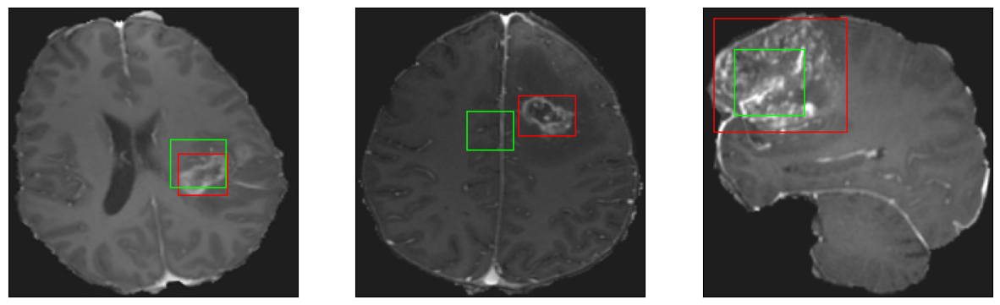

26/26 [==============================] - 4s 162ms/step - loss: 3.8997 - IoU: 0.6704 - val_loss: 11.5109 - val_IoU: 0.4255
Epoch 156/200
26/26 [==============================] - ETA: 0s - loss: 3.8703 - IoU: 0.6738
Epoch 156: val_IoU improved from 0.42550 to 0.43207, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


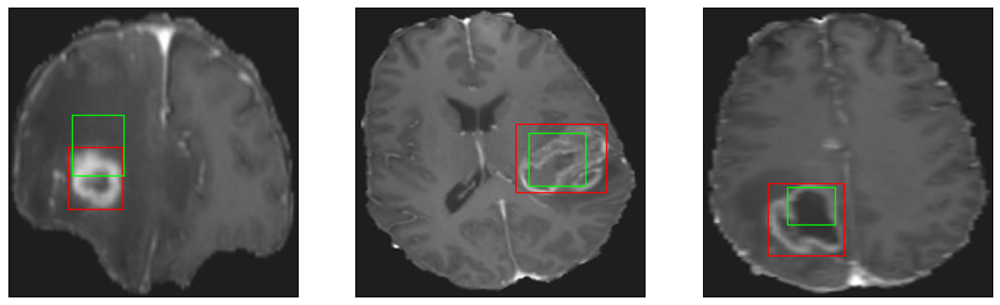

26/26 [==============================] - 4s 150ms/step - loss: 3.8703 - IoU: 0.6738 - val_loss: 11.1846 - val_IoU: 0.4321
Epoch 157/200
25/26 [===========================>..] - ETA: 0s - loss: 3.6918 - IoU: 0.6880
Epoch 157: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 6ms/step
4


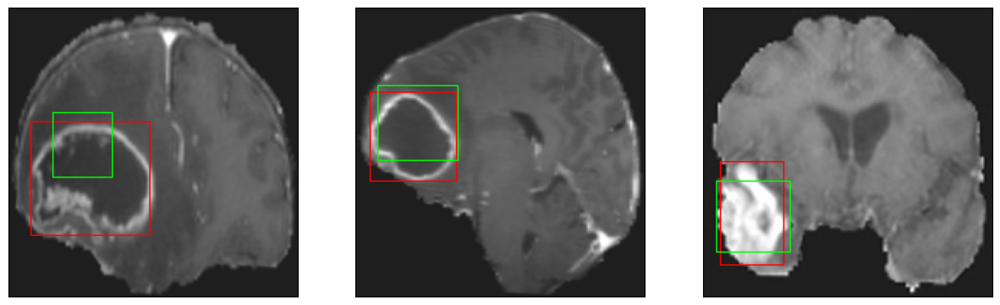

26/26 [==============================] - 3s 123ms/step - loss: 3.6744 - IoU: 0.6909 - val_loss: 11.6564 - val_IoU: 0.4066
Epoch 158/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7749 - IoU: 0.6810
Epoch 158: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


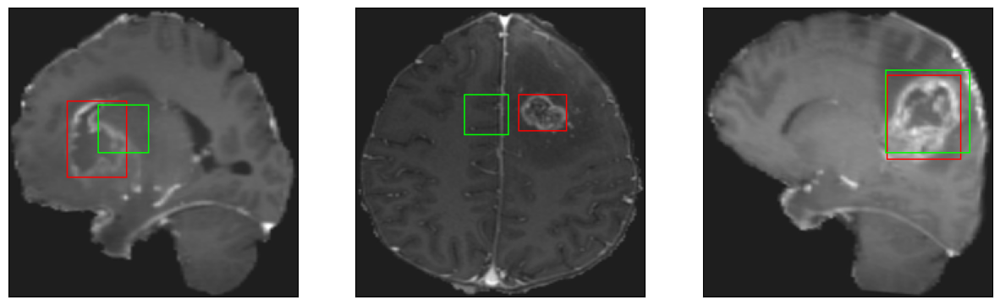

26/26 [==============================] - 3s 116ms/step - loss: 3.7780 - IoU: 0.6789 - val_loss: 11.7147 - val_IoU: 0.4004
Epoch 159/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7162 - IoU: 0.6907
Epoch 159: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


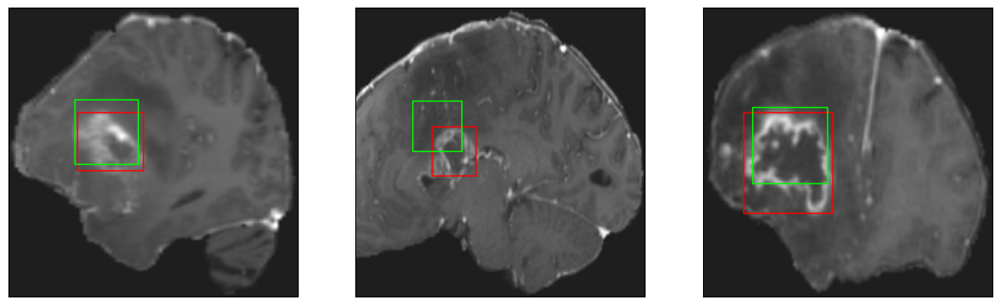

26/26 [==============================] - 3s 100ms/step - loss: 3.6985 - IoU: 0.6906 - val_loss: 11.8771 - val_IoU: 0.4018
Epoch 160/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7924 - IoU: 0.6796
Epoch 160: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


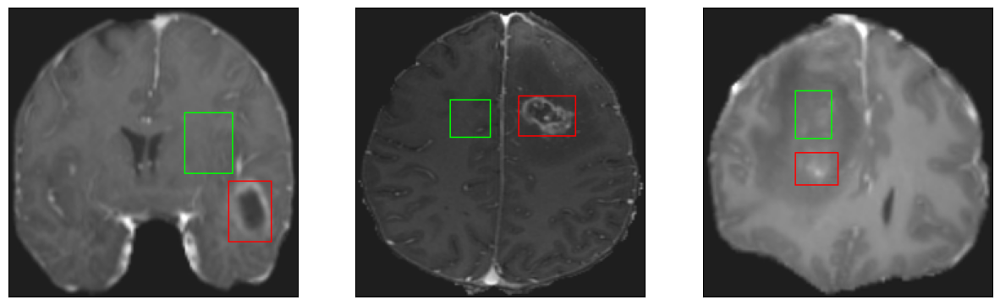

26/26 [==============================] - 3s 132ms/step - loss: 3.8045 - IoU: 0.6799 - val_loss: 11.6434 - val_IoU: 0.4067
Epoch 161/200
26/26 [==============================] - ETA: 0s - loss: 3.6692 - IoU: 0.6884
Epoch 161: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


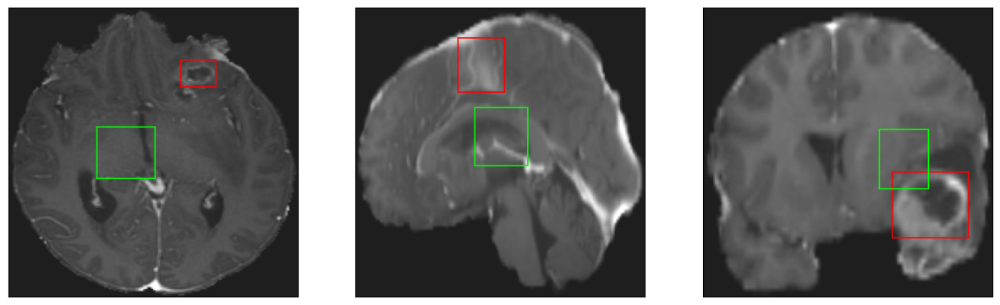

26/26 [==============================] - 3s 121ms/step - loss: 3.6692 - IoU: 0.6884 - val_loss: 12.3470 - val_IoU: 0.3856
Epoch 162/200
26/26 [==============================] - ETA: 0s - loss: 3.6484 - IoU: 0.6875
Epoch 162: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


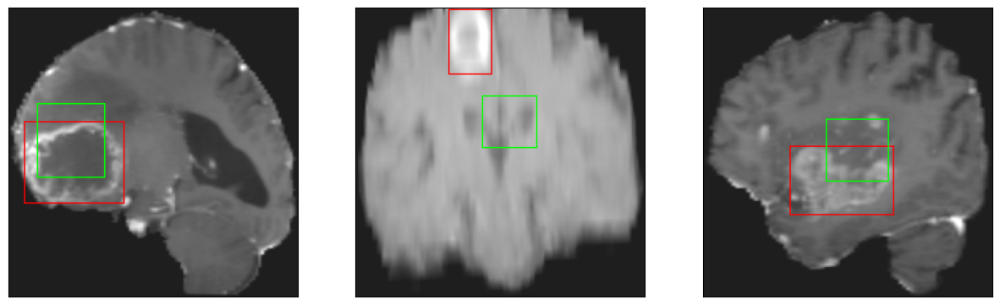

26/26 [==============================] - 3s 118ms/step - loss: 3.6484 - IoU: 0.6875 - val_loss: 12.1732 - val_IoU: 0.3827
Epoch 163/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8508 - IoU: 0.6780
Epoch 163: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


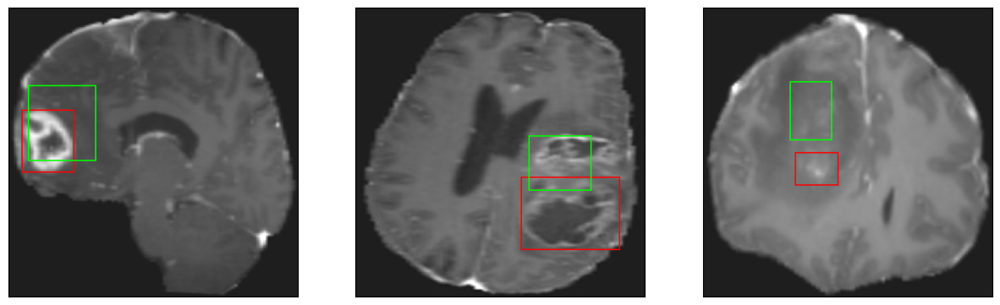

26/26 [==============================] - 3s 99ms/step - loss: 3.8296 - IoU: 0.6782 - val_loss: 11.5896 - val_IoU: 0.4199
Epoch 164/200
25/26 [===========================>..] - ETA: 0s - loss: 3.6561 - IoU: 0.6927
Epoch 164: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


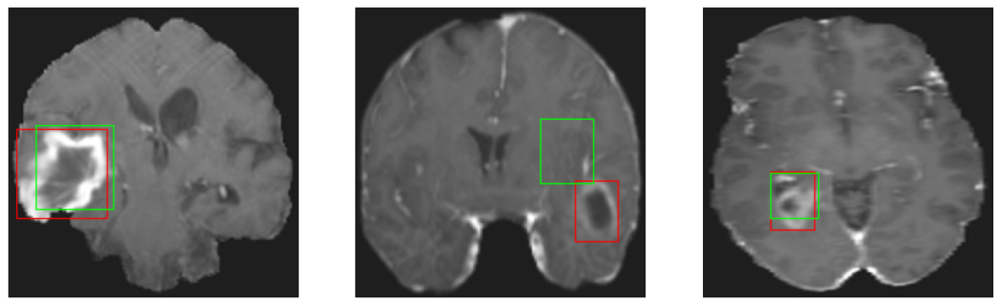

26/26 [==============================] - 3s 121ms/step - loss: 3.6517 - IoU: 0.6927 - val_loss: 11.5543 - val_IoU: 0.4165
Epoch 165/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7797 - IoU: 0.6785
Epoch 165: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


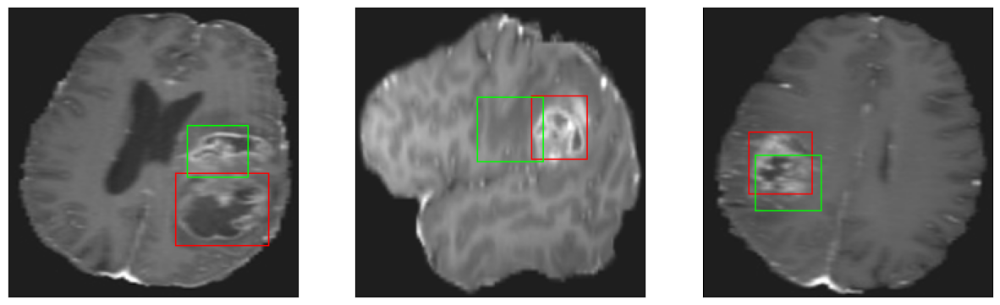

26/26 [==============================] - 4s 137ms/step - loss: 3.7469 - IoU: 0.6801 - val_loss: 11.4011 - val_IoU: 0.4215
Epoch 166/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9382 - IoU: 0.6664
Epoch 166: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


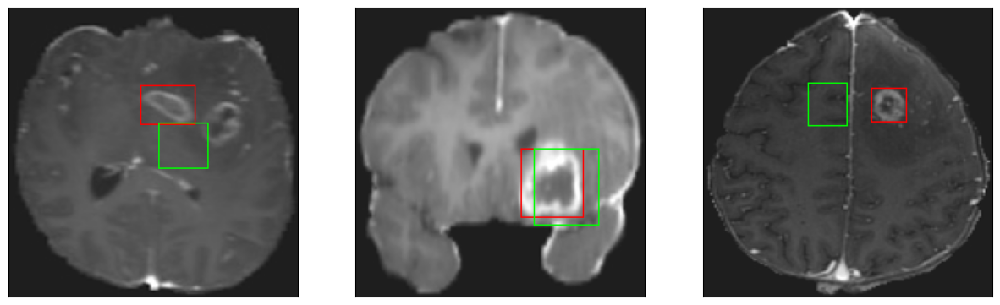

26/26 [==============================] - 3s 105ms/step - loss: 3.9895 - IoU: 0.6641 - val_loss: 11.9413 - val_IoU: 0.3995
Epoch 167/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0826 - IoU: 0.6585
Epoch 167: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


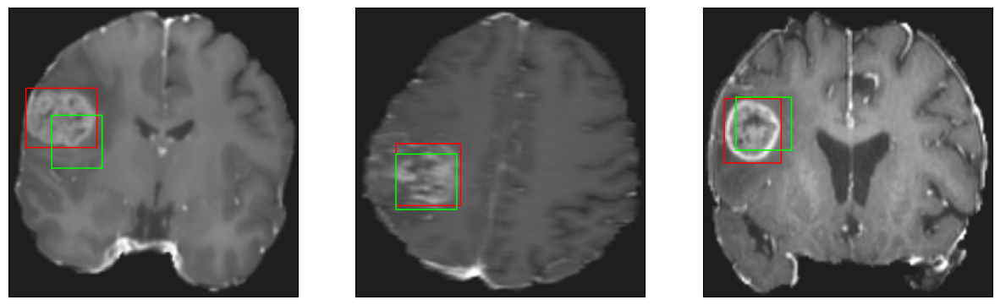

26/26 [==============================] - 2s 88ms/step - loss: 4.0552 - IoU: 0.6587 - val_loss: 11.9294 - val_IoU: 0.4059
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 3.7044 - IoU: 0.6839
Epoch 168: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


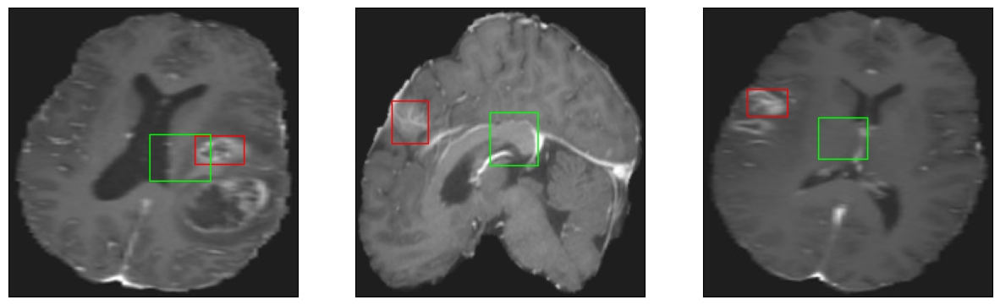

26/26 [==============================] - 3s 97ms/step - loss: 3.7044 - IoU: 0.6839 - val_loss: 11.2954 - val_IoU: 0.4192
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 3.9483 - IoU: 0.6663
Epoch 169: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 9ms/step
4


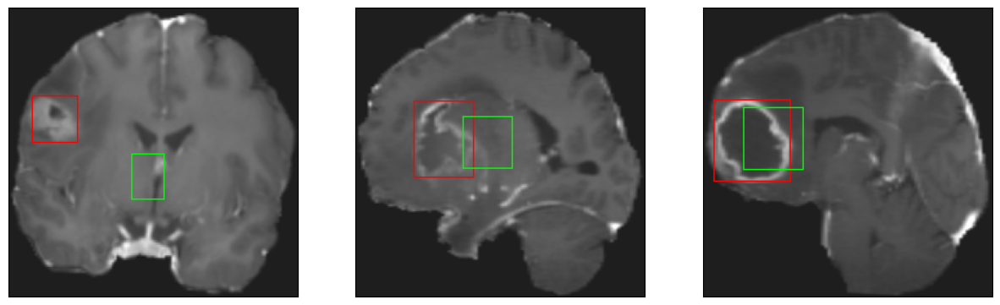

26/26 [==============================] - 4s 138ms/step - loss: 3.9483 - IoU: 0.6663 - val_loss: 11.3718 - val_IoU: 0.4105
Epoch 170/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7769 - IoU: 0.6840
Epoch 170: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


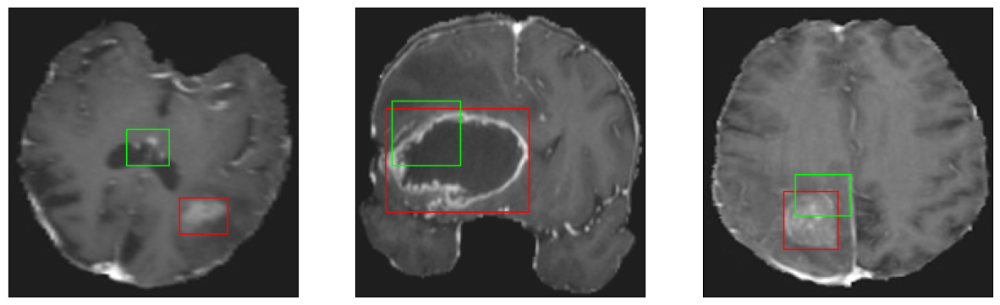

26/26 [==============================] - 3s 101ms/step - loss: 3.7565 - IoU: 0.6833 - val_loss: 11.8745 - val_IoU: 0.3965
Epoch 171/200
25/26 [===========================>..] - ETA: 0s - loss: 3.6767 - IoU: 0.6891
Epoch 171: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


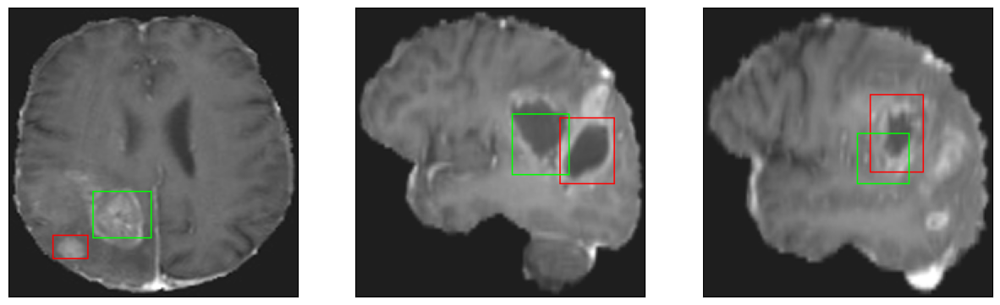

26/26 [==============================] - 3s 109ms/step - loss: 3.6527 - IoU: 0.6887 - val_loss: 11.5626 - val_IoU: 0.4133
Epoch 172/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8307 - IoU: 0.6764
Epoch 172: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


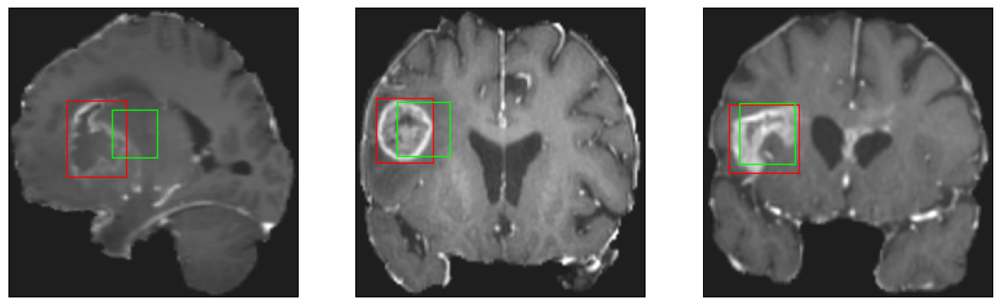

26/26 [==============================] - 3s 131ms/step - loss: 3.8066 - IoU: 0.6774 - val_loss: 11.7049 - val_IoU: 0.4032
Epoch 173/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9132 - IoU: 0.6676
Epoch 173: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 6ms/step
4


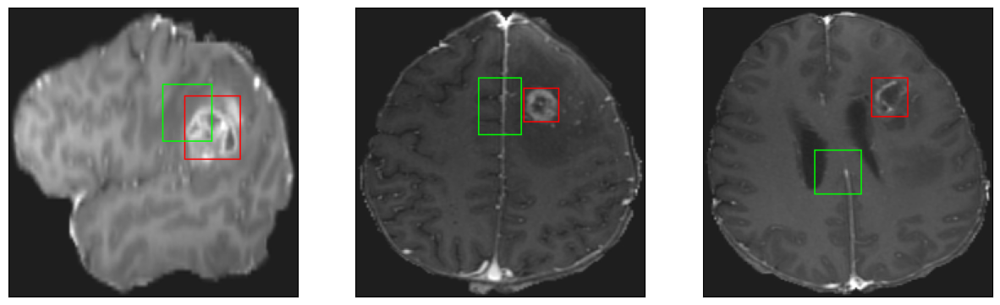

26/26 [==============================] - 3s 120ms/step - loss: 3.9001 - IoU: 0.6676 - val_loss: 11.5215 - val_IoU: 0.4142
Epoch 174/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7982 - IoU: 0.6809
Epoch 174: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


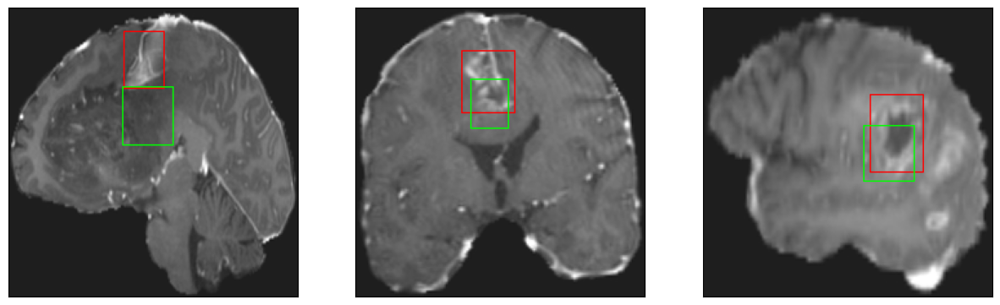

26/26 [==============================] - 3s 98ms/step - loss: 3.8467 - IoU: 0.6775 - val_loss: 11.8457 - val_IoU: 0.3984
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 3.6491 - IoU: 0.6910
Epoch 175: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


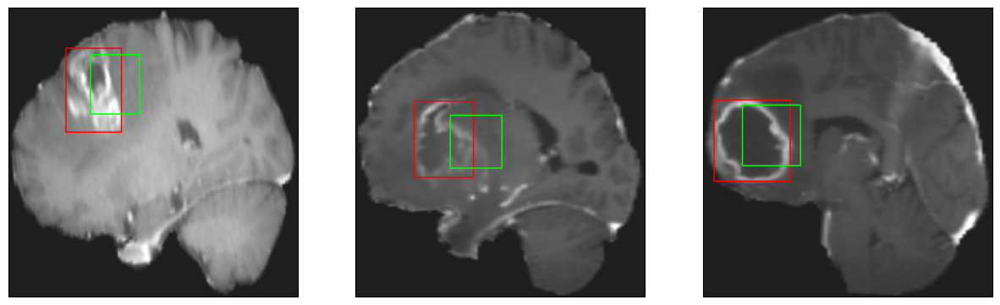

26/26 [==============================] - 3s 105ms/step - loss: 3.6491 - IoU: 0.6910 - val_loss: 11.3929 - val_IoU: 0.4232
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 3.6679 - IoU: 0.6881
Epoch 176: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


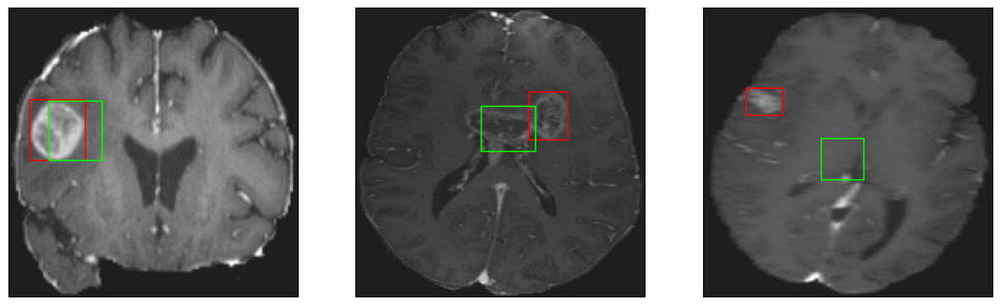

26/26 [==============================] - 3s 133ms/step - loss: 3.6679 - IoU: 0.6881 - val_loss: 12.6525 - val_IoU: 0.3593
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 3.7024 - IoU: 0.6865
Epoch 177: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


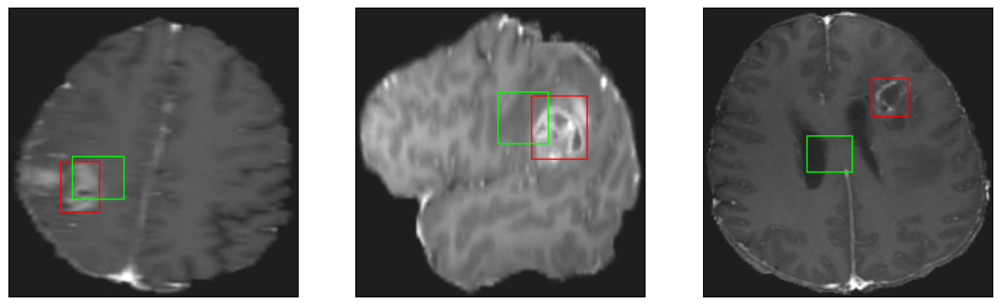

26/26 [==============================] - 3s 120ms/step - loss: 3.7024 - IoU: 0.6865 - val_loss: 11.4977 - val_IoU: 0.4059
Epoch 178/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8727 - IoU: 0.6733
Epoch 178: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


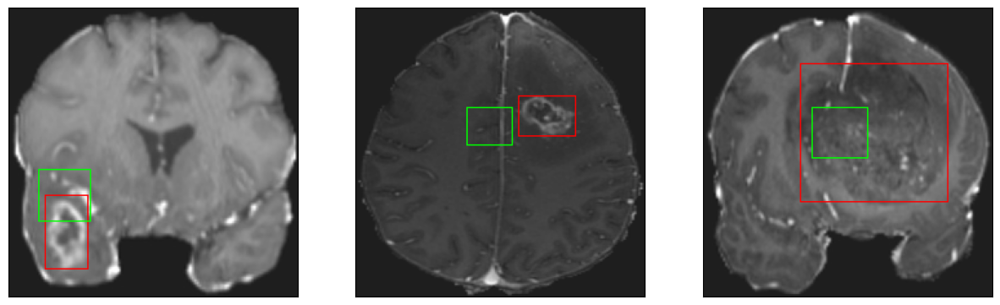

26/26 [==============================] - 3s 110ms/step - loss: 3.8861 - IoU: 0.6715 - val_loss: 12.8685 - val_IoU: 0.3494
Epoch 179/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9317 - IoU: 0.6678
Epoch 179: val_IoU did not improve from 0.43207
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


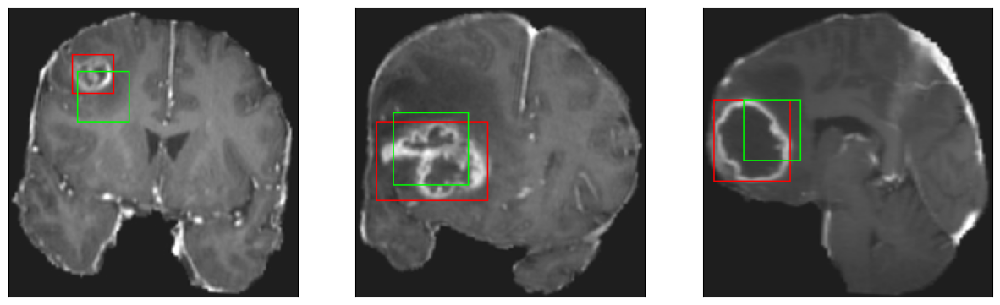

26/26 [==============================] - 3s 119ms/step - loss: 3.9650 - IoU: 0.6683 - val_loss: 11.4383 - val_IoU: 0.4190
Epoch 180/200
25/26 [===========================>..] - ETA: 0s - loss: 3.5147 - IoU: 0.6952
Epoch 180: val_IoU improved from 0.43207 to 0.43763, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


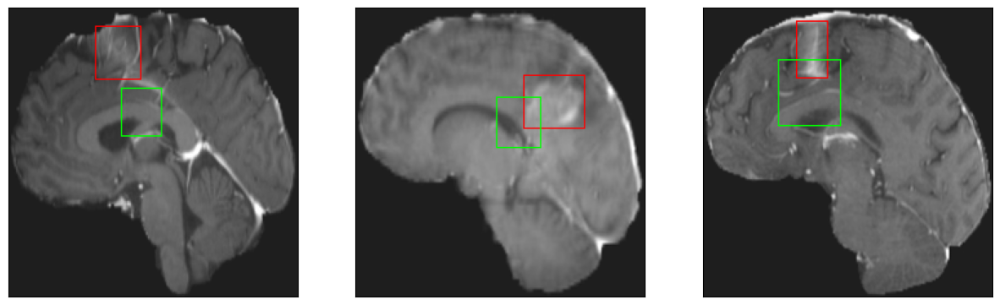

26/26 [==============================] - 5s 180ms/step - loss: 3.5773 - IoU: 0.6944 - val_loss: 11.1026 - val_IoU: 0.4376
Epoch 181/200
26/26 [==============================] - ETA: 0s - loss: 3.7723 - IoU: 0.6776
Epoch 181: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


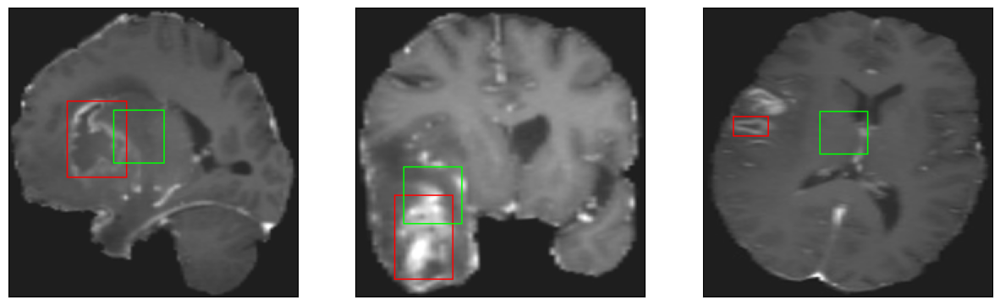

26/26 [==============================] - 3s 101ms/step - loss: 3.7723 - IoU: 0.6776 - val_loss: 11.5000 - val_IoU: 0.4187
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 3.6201 - IoU: 0.6953
Epoch 182: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


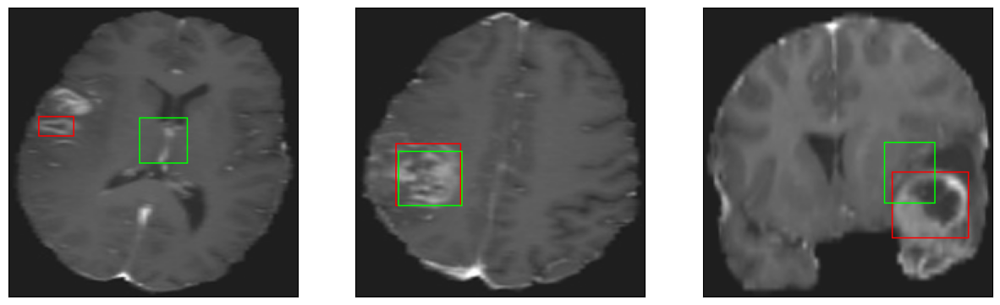

26/26 [==============================] - 3s 100ms/step - loss: 3.6201 - IoU: 0.6953 - val_loss: 11.4744 - val_IoU: 0.4254
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 3.7148 - IoU: 0.6851
Epoch 183: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


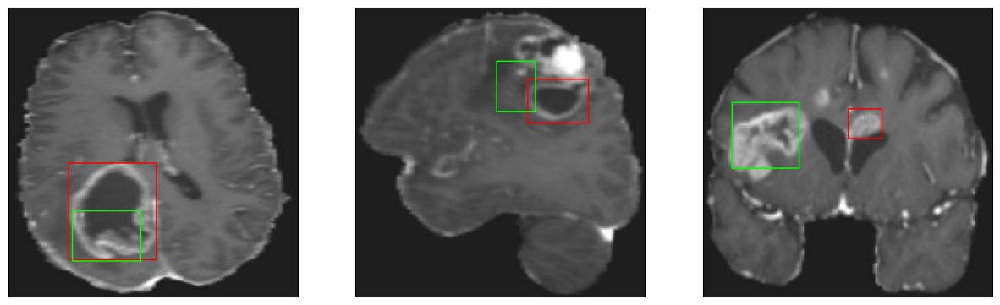

26/26 [==============================] - 3s 110ms/step - loss: 3.7148 - IoU: 0.6851 - val_loss: 11.8351 - val_IoU: 0.4040
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 3.6658 - IoU: 0.6936
Epoch 184: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


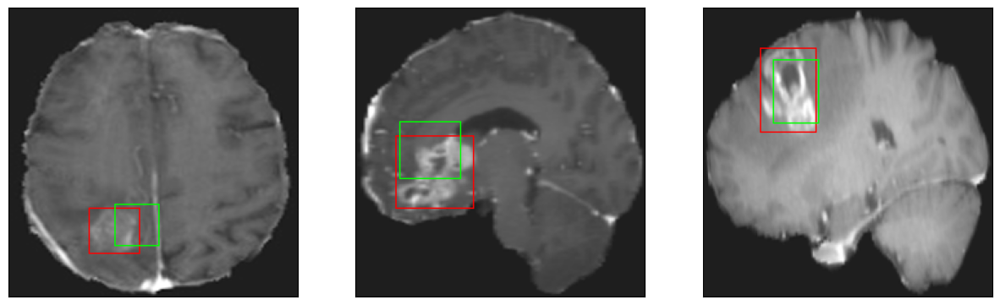

26/26 [==============================] - 3s 130ms/step - loss: 3.6658 - IoU: 0.6936 - val_loss: 12.4212 - val_IoU: 0.3831
Epoch 185/200
25/26 [===========================>..] - ETA: 0s - loss: 3.6761 - IoU: 0.6956
Epoch 185: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


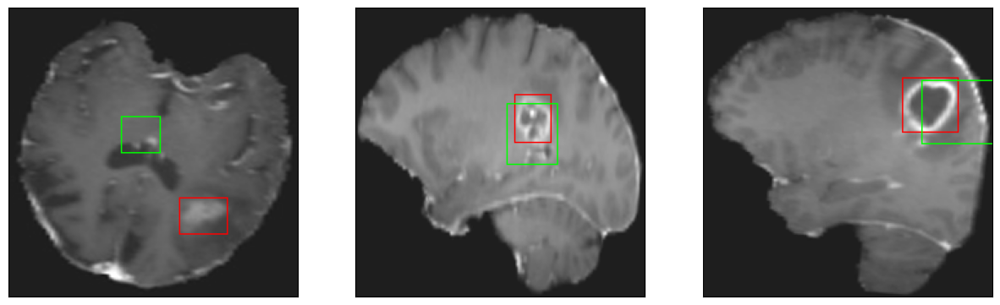

26/26 [==============================] - 3s 108ms/step - loss: 3.6256 - IoU: 0.6967 - val_loss: 11.7899 - val_IoU: 0.3956
Epoch 186/200
25/26 [===========================>..] - ETA: 0s - loss: 3.6702 - IoU: 0.6924
Epoch 186: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


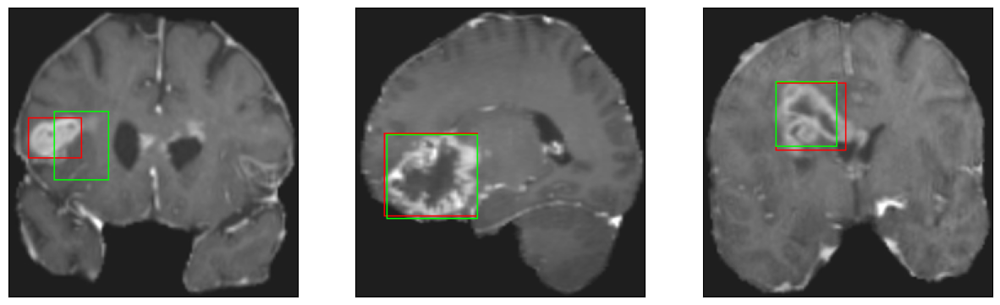

26/26 [==============================] - 3s 112ms/step - loss: 3.6638 - IoU: 0.6927 - val_loss: 11.9369 - val_IoU: 0.4038
Epoch 187/200
25/26 [===========================>..] - ETA: 0s - loss: 3.7084 - IoU: 0.6848
Epoch 187: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


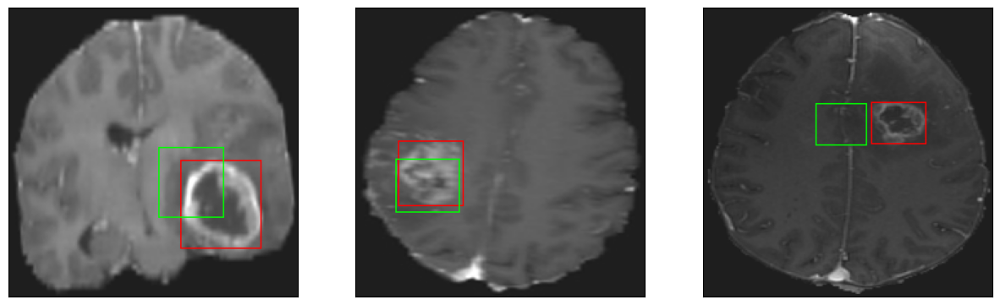

26/26 [==============================] - 3s 115ms/step - loss: 3.7153 - IoU: 0.6841 - val_loss: 11.2281 - val_IoU: 0.4216
Epoch 188/200
25/26 [===========================>..] - ETA: 0s - loss: 3.5070 - IoU: 0.7043
Epoch 188: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


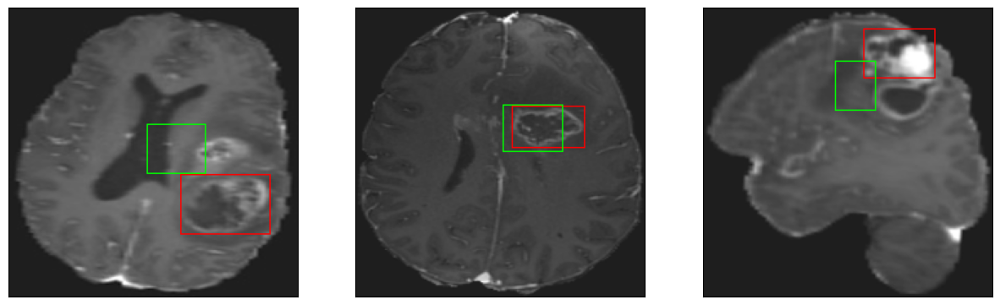

26/26 [==============================] - 3s 126ms/step - loss: 3.4551 - IoU: 0.7082 - val_loss: 11.9662 - val_IoU: 0.3838
Epoch 189/200
25/26 [===========================>..] - ETA: 0s - loss: 3.5451 - IoU: 0.6935
Epoch 189: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


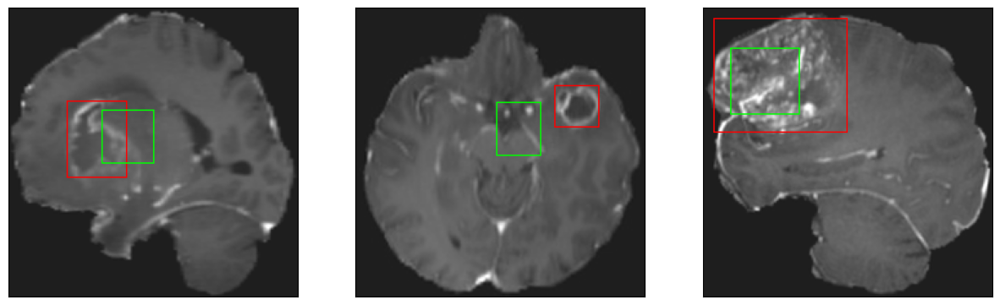

26/26 [==============================] - 3s 106ms/step - loss: 3.5557 - IoU: 0.6945 - val_loss: 11.5685 - val_IoU: 0.3998
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 3.5986 - IoU: 0.6927
Epoch 190: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


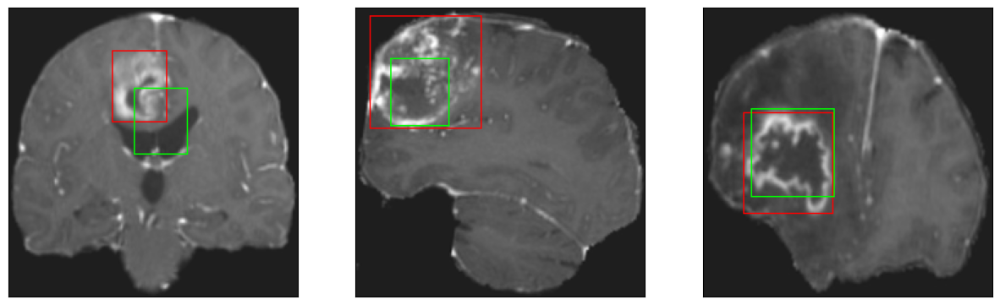

26/26 [==============================] - 3s 103ms/step - loss: 3.5986 - IoU: 0.6927 - val_loss: 11.5172 - val_IoU: 0.4150
Epoch 191/200
26/26 [==============================] - ETA: 0s - loss: 3.6836 - IoU: 0.6865
Epoch 191: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


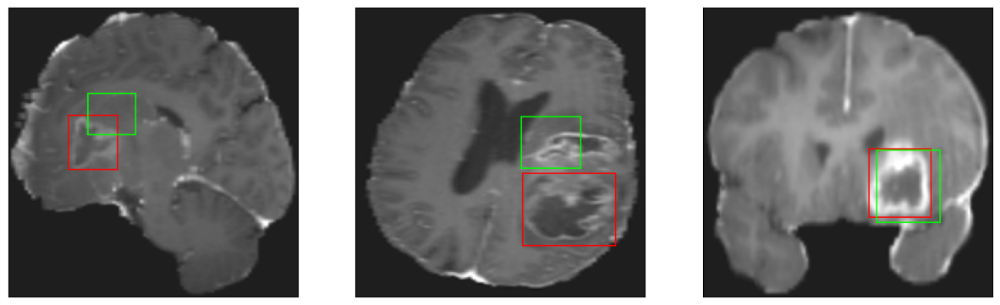

26/26 [==============================] - 3s 97ms/step - loss: 3.6836 - IoU: 0.6865 - val_loss: 11.7023 - val_IoU: 0.4111
Epoch 192/200
26/26 [==============================] - ETA: 0s - loss: 3.5863 - IoU: 0.6962
Epoch 192: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


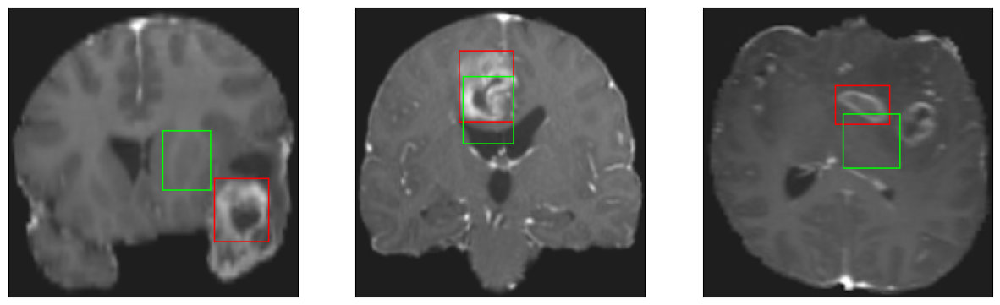

26/26 [==============================] - 3s 111ms/step - loss: 3.5863 - IoU: 0.6962 - val_loss: 12.5071 - val_IoU: 0.3757
Epoch 193/200
26/26 [==============================] - ETA: 0s - loss: 3.6236 - IoU: 0.6852
Epoch 193: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


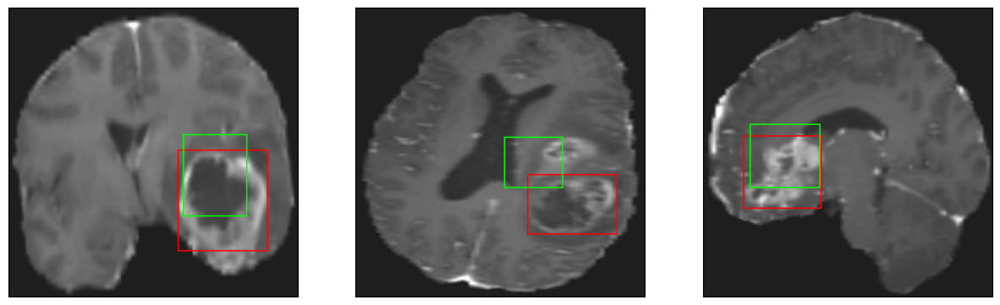

26/26 [==============================] - 3s 130ms/step - loss: 3.6236 - IoU: 0.6852 - val_loss: 11.3570 - val_IoU: 0.4236
Epoch 194/200
25/26 [===========================>..] - ETA: 0s - loss: 3.4855 - IoU: 0.7036
Epoch 194: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


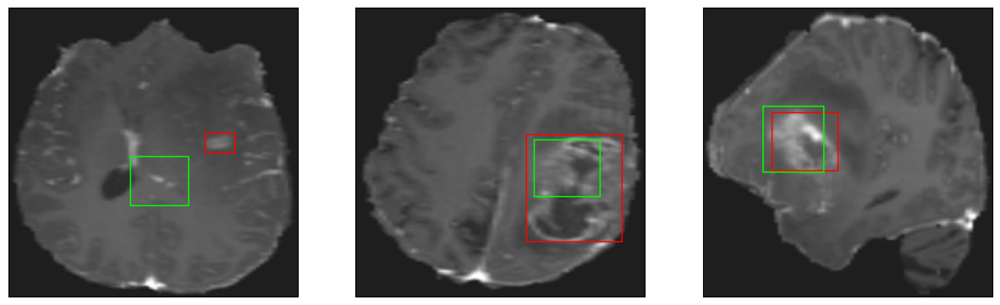

26/26 [==============================] - 3s 130ms/step - loss: 3.4633 - IoU: 0.7048 - val_loss: 11.2398 - val_IoU: 0.4307
Epoch 195/200
26/26 [==============================] - ETA: 0s - loss: 3.4805 - IoU: 0.7041
Epoch 195: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


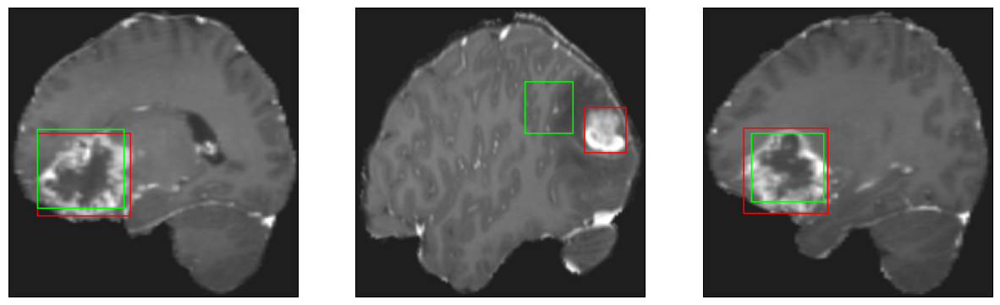

26/26 [==============================] - 3s 103ms/step - loss: 3.4805 - IoU: 0.7041 - val_loss: 11.5646 - val_IoU: 0.4052
Epoch 196/200
25/26 [===========================>..] - ETA: 0s - loss: 3.3358 - IoU: 0.7162
Epoch 196: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


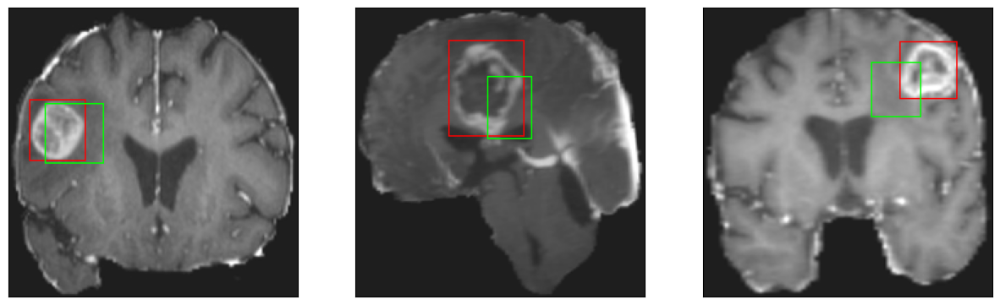

26/26 [==============================] - 3s 100ms/step - loss: 3.3453 - IoU: 0.7147 - val_loss: 11.5411 - val_IoU: 0.4146
Epoch 197/200
25/26 [===========================>..] - ETA: 0s - loss: 3.4814 - IoU: 0.7028
Epoch 197: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


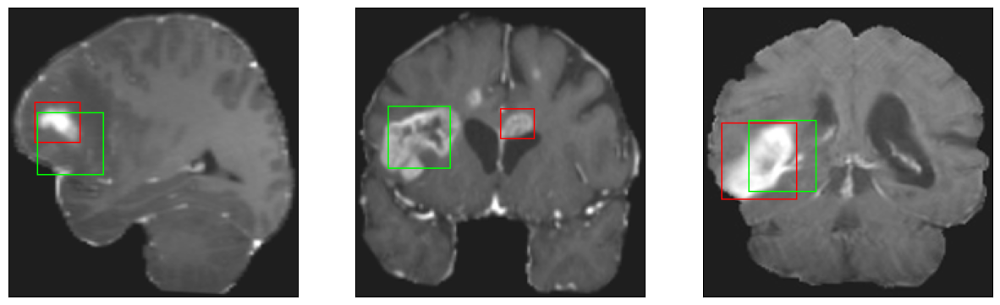

26/26 [==============================] - 3s 123ms/step - loss: 3.5121 - IoU: 0.7016 - val_loss: 12.2180 - val_IoU: 0.3801
Epoch 198/200
26/26 [==============================] - ETA: 0s - loss: 3.5750 - IoU: 0.6981
Epoch 198: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


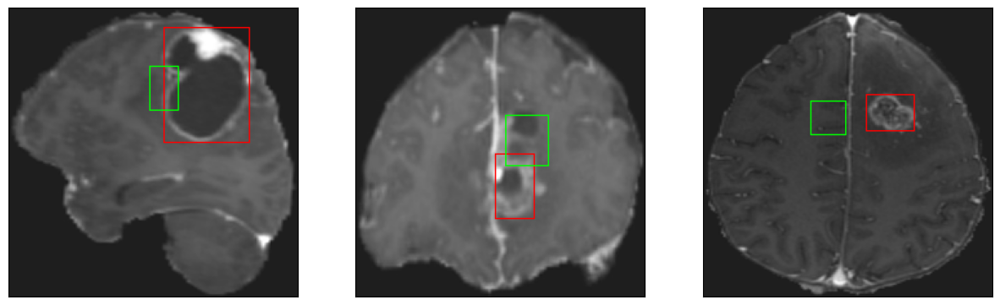

26/26 [==============================] - 3s 112ms/step - loss: 3.5750 - IoU: 0.6981 - val_loss: 12.4893 - val_IoU: 0.3673
Epoch 199/200
26/26 [==============================] - ETA: 0s - loss: 3.5499 - IoU: 0.6961
Epoch 199: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


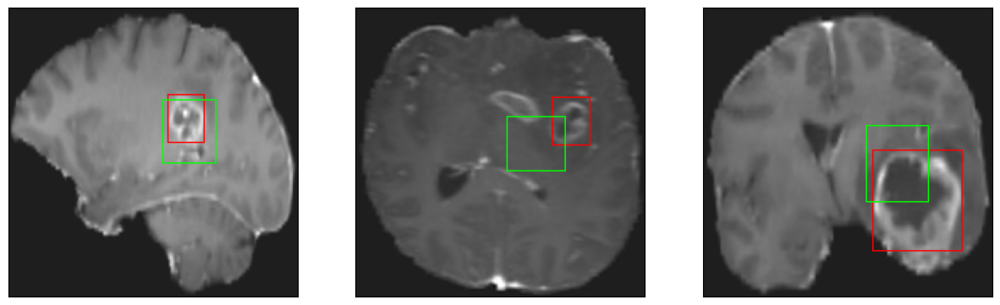

26/26 [==============================] - 3s 124ms/step - loss: 3.5499 - IoU: 0.6961 - val_loss: 11.9654 - val_IoU: 0.4069
Epoch 200/200
26/26 [==============================] - ETA: 0s - loss: 3.5449 - IoU: 0.6949
Epoch 200: val_IoU did not improve from 0.43763
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


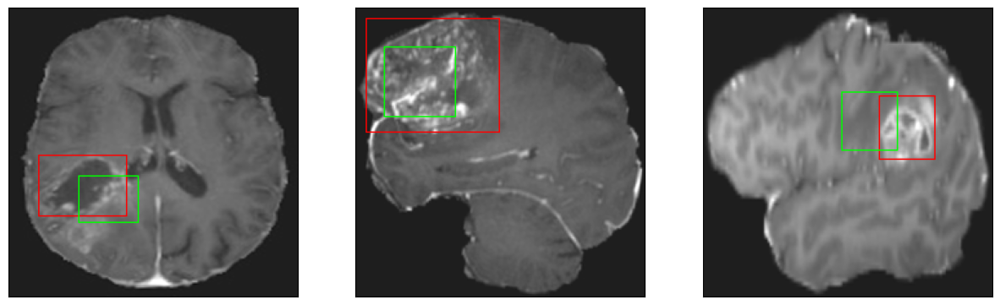

26/26 [==============================] - 4s 142ms/step - loss: 3.5449 - IoU: 0.6949 - val_loss: 11.1235 - val_IoU: 0.4272


In [ ]:
#Model fitting
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

In [25]:
%cd '../../..'
%cd '/dataset unzipped'

/
/dataset unzipped


(224, 224, 3)
1/1 [==============================] - 7s 7s/step


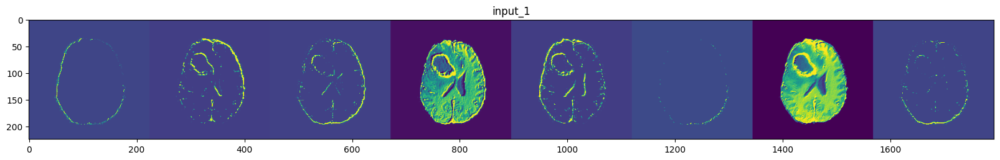

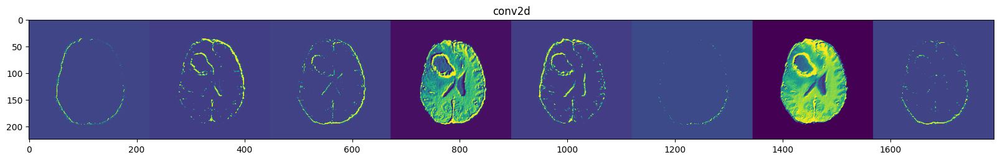

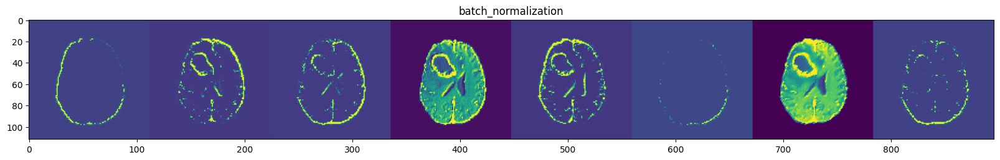

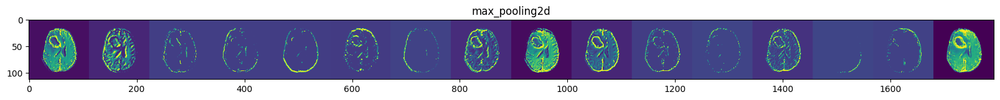

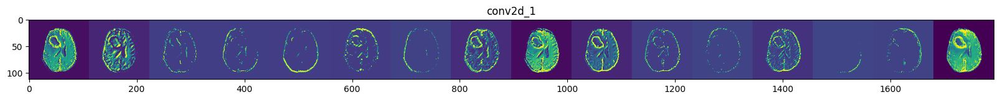

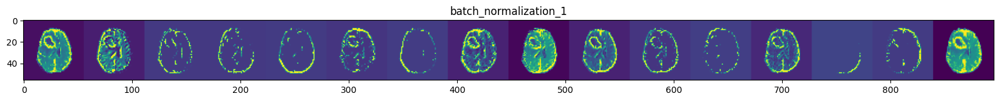

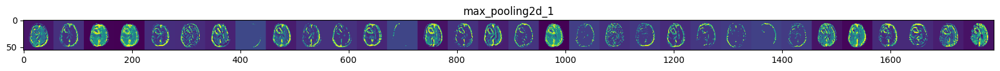

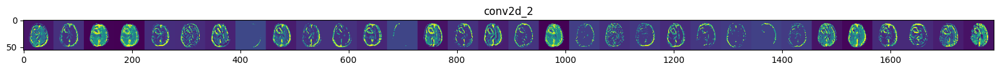

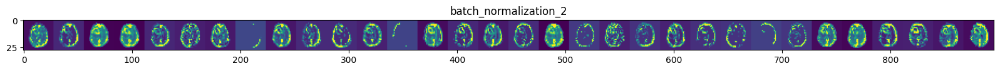

In [30]:
#plot the feature extraction for the first 10 layers of the neural network
from keras.models import Model
img_path='./axial_t1wce_2_class/images/train/00095_224.jpg' 
# Output= intermediate representations for all layers in the  
# previous model after the first.
successive_outputs = [layer.output for layer in model.layers[1:10]]
visualization_model = Model(inputs = model.input, outputs = successive_outputs)
#Load the input image
img = tf.keras.utils.load_img(img_path, target_size=(224, 224))
# Convert ht image to Array of dimension (image_size,image_size,hyper_channels)
x   = tf.keras.utils.img_to_array(img)
np.dot(x, [0.299, 0.587, 0.144])
print(x.shape)                         
x   = x.reshape((1,) + x.shape)# Rescale by 1/255
x /= 255.0
# Let's run input image through our visualization network
# to obtain all intermediate representations for the image.
successive_feature_maps = visualization_model.predict(x)# Retrieve are the names of the layers, so can have them as part of our plot
layer_names = [layer.name for layer in model.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  #print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
   
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    #tile our images in this matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be better visualized
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x# Display the grid
    scale = 20. / n_features
    plt.figure( figsize=(scale * n_features, scale) )
    plt.title ( layer_name )
    plt.grid  ( False )
    plt.imshow( display_grid, aspect='auto', cmap='viridis' )

In [ ]:
#Load the model with better results
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [ ]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [ ]:
#Model evaluation in Loss and IoU for the test_dataset
model.evaluate(test_dataset)

In [ ]:
#Model evaluation in Loss and IoU for the val_dataset
model.evaluate(val_dataset)

In [ ]:
#Model evaluation in Loss and IoU for the train_dataset
model.evaluate(train_dataset)

8/8 [==============================] - 1s 55ms/step - loss: 15.5755 - IoU: 0.2745


[15.575489044189453, 0.27446573972702026]